<a href="https://colab.research.google.com/github/jegraham/2-Iterative-GNN/blob/main/Graham%2C_Jessica_Phase_1_Pre_Trained.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Iterative Pre-Trained K-Means GNN Implementation (Step 1)

Building upon the foundation laid out in the Springer WIDECOMM 2023 Paper, this code further extends the GNN implementation by introducing an iterative approach. The iterative nature enhances the adaptability and robustness of the model, incorporating features such as encoders and decoders with Graph Attention Network (GAT), Graph Convolutional Network (GCN), and GraphSAGE layers. To facilitate experimentation and fine-tuning, the code provides a designated 'Testing Parameters' section where key parameters can be modified. This iterative strategy aims to refine and optimize the GNN model for enhanced performance in diverse scenarios.

## Setup

### Import the Dataset

In [1]:
import os
import os.path as osp
import shutil
import pandas as pd
import random
import re
import datetime

# libraries for the files in google drive
from pydrive.auth import GoogleAuth
from google.colab import drive, files, auth
from pydrive.drive import GoogleDrive
from oauth2client.client import GoogleCredentials

In [2]:
# Mount Google Drive
drive.mount('/content/gdrive')

colab_folder_location = '/content/dataset_cologne/cluster_data'
drive_folder_path = '/content/gdrive/My Drive/School/Masters 2021-2023/1 - Thesis/Colab Notebooks/Thesis/Data/cologne/cluster_data'

os.makedirs(colab_folder_location, exist_ok=True)
os.chdir(colab_folder_location)

files_list = os.listdir(drive_folder_path)

for file_name in files_list:
    match = re.match(r'KMean_Cluster_(\d+)\.csv', file_name)

    if match:
        num = int(match.group(1))
        drive_file_path = os.path.join(drive_folder_path, file_name)
        colab_file_path = os.path.join(colab_folder_location, file_name)
        shutil.copy(drive_file_path, colab_file_path)
        print(f"\n {num} File copied: {colab_file_path}")

dfs = {}

for file_name in os.listdir(colab_folder_location):
    match = re.match(r'KMean_Cluster_(\d+)\.csv', file_name)

    if match:
        num = int(match.group(1))
        df_name = f"df_{num}"
        dfs[df_name] = pd.read_csv(file_name)
        print(f"\n {num} {df_name} Data from file: {file_name}")
        print(f"{df_name} columns: {dfs[df_name].columns}")
        dfs[df_name] = dfs[df_name].dropna(subset=['X', 'Y'])
        dfs[df_name] = dfs[df_name][(dfs[df_name]['X'] != -1) & (dfs[df_name]['Y'] != -1)]


Mounted at /content/gdrive

 1 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_1.csv

 2 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_2.csv

 3 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_3.csv

 4 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_4.csv

 6 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_6.csv

 5 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_5.csv

 7 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_7.csv

 8 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_8.csv

 10 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_10.csv

 11 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_11.csv

 9 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_9.csv

 13 File copied: /content/dataset_cologne/cluster_data/KMean_Cluster_13.csv

 12 File copied: /content/dataset_cologne/cluster_data/KMean_Clust

### Testing Parameters

In [3]:
#------------------------------------------------------------------------------------------------------------------------------
#GNN Type
# conv_type = 'GCN'
# conv_type = 'GAT'
conv_type = 'SAGE'
print("GNN Type: " + conv_type)

# Clustering
clust_type = 'KMeans'
# clust_type = 'Spectral'
print("Cluster Type: " + clust_type)

#------------------------------------------------------------------------------------------------------------------------------

pre_trained = True # --- Limit the t_vlaues for this as too much training can result in issues with clustering later
live_trained = False
hybrid_trained = False
pre_train = 5
t_lag = 1
#------------------------------------------------------------------------------------------------------------------------------

t_values = 100
# t_lag = 25

# Define the Number of Clusters
num_clusters = 10
K = num_clusters
clusters = []

num_Infrastructure = 10 #The number of RSU and Towers in the Dataset (always at the start of the dataset)
max_dist_tower = 500 #V2I
max_dist_rsu = 250 #V2R
max_dist = 150 #V2V

# Channel Parameters & GAE MODEL
in_channels = 6
hidden_channels = 33
out_channels = 2

# Transform Parameters
transform_set = True
learn_rate = 0.0001

# Epochs or the number of generation/iterations of the training dataset
# epoch and n_init refers to the number of times the clustering algorithm will run different initializations
epochs = 5000
n = 1000

GNN Type: GAT
Cluster Type: KMeans


In [4]:
# Set the correct directory according to the type of training set
if pre_trained:
    print("Pre-training is true.")
    run_id = (
    conv_type + '_'
    + str(n) + 'k_'
    + str(epochs) + 'ep_' + '_'+ 'PRE_TRAINED'
    + '-t_values' + str(t_values) + '_pre_train_'+ str(pre_train) +'-t_lag' + str(t_lag)
    )
elif live_trained:
    print("Live training is true.")
    run_id = (
    conv_type + '_'
    + str(n) + 'k_'
    + str(epochs) + 'ep_'+'_' + 'LIVE_TRAINED'
    + '-t_values-' + str(t_values) + '_t_lag' + str(t_lag)
    )
elif hybrid_trained:
    print("Hybrid training is true.")
    run_id = (
    conv_type + '_'
    + str(n) + 'k_'
    + str(epochs) + 'ep_'+ '_' + 'HYBRID_TRAINED'
    + '-t_values' + str(t_values) + '_pre_train_'+ str(pre_train) +'-t_lag' + str(t_lag)
    )
else:
    print("No training option is set to true.")
    run_id = (
    conv_type + '_'
    + str(n) + 'k_'
    + str(epochs) + 'ep_' + 'NO_TRAINING_SET'
    + '-t_values' + str(t_values) + '_pre_train_'+ str(pre_train) +'-t_lag' + str(t_lag)
    )

print("Run ID: " + run_id)


# Define the root directory where the dataset will be stored
root = './'
version = 'v1'
print("Run ID: " + run_id)

# File Path
folder_path = f'./results/{run_id}_{version}/'
os.makedirs(folder_path, exist_ok=True)

Pre-training is true.
Run ID: GAT_1000k_5000ep__PRE_TRAINED-t_values100_pre_train_5-t_lag1
Run ID: GAT_1000k_5000ep__PRE_TRAINED-t_values100_pre_train_5-t_lag1



### Import Libraries

Process the Data Frame - Modified Code from - https://github.com/jegraham/csv_to_dataframe_to_graph/blob/master/.idea/csv_to_datadrame_conversion.py

In [5]:
import torch
os.environ['TORCH'] = torch.__version__
print(torch.__version__)

# GPU Usage Guide - https://medium.com/@natsunoyuki/speeding-up-model-training-with-google-colab-b1ad7c48573e
if torch.cuda.is_available():
    device_name = torch.device("cuda")
else:
    device_name = torch.device('cpu')
print("Using {}.".format(device_name))

!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install --verbose torch-scatter
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git
!pip install torch_geometric pandas
!pip install scikit-learn!pip install --upgrade torch-geometric


from collections import Counter
import csv
import matplotlib.pyplot as plt
from matplotlib.cm import viridis
import math
import networkx as nx
import numpy as np
import psutil
from scipy.spatial.distance import cdist, squareform
from scipy import stats
from sklearn.cluster import KMeans, MeanShift, AffinityPropagation, FeatureAgglomeration, SpectralClustering, MiniBatchKMeans, Birch, DBSCAN, OPTICS, AgglomerativeClustering
from sklearn.impute import SimpleImputer
from sklearn.mixture import GaussianMixture
from sklearn.metrics import confusion_matrix, pairwise_distances, davies_bouldin_score, silhouette_score, calinski_harabasz_score, adjusted_rand_score, normalized_mutual_info_score
from torch_geometric.data import Data, InMemoryDataset, download_url
from torch_geometric.loader import DataLoader
from torch_geometric.datasets import Planetoid, TUDataset
from torch_geometric.nn import GCNConv, SAGEConv, GAE, GINConv, GATConv
from torch_geometric.utils import train_test_split_edges, to_networkx, from_networkx, to_dense_adj
from torch_geometric.transforms import NormalizeFeatures, ToDevice, RandomLinkSplit, RemoveDuplicatedEdges
import torch_geometric.transforms as T
import torch.nn.functional as F

2.1.0+cu121
Using cuda.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 37.4 MB/s eta 0:00:00
Using pip 23.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 27.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
ERROR: Invalid requirement: 'scikit-learn!pip'


In [6]:
!nvidia-smi

Mon Mar  4 00:35:08 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8              10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

### Text Notification

In [7]:
# Install Twilio Python library - Text Notification
!pip install twilio
from twilio.rest import Client

# Twilio account SID and authentication token
account_sid = 'AC72a6868bcdc4e172578520829d0276e0'
auth_token = 'e7923d7de43f80dd028e9fa9c82ab5d4'

# Twilio phone number (must be obtained from Twilio)
twilio_phone_number = '+12092135944'
your_phone_number = '+15193593718'

def send_text_notification(message):
    # Create Twilio client
    client = Client(account_sid, auth_token)

    try:
        # Send SMS
        message = client.messages.create(
            body=message,
            from_=twilio_phone_number,
            to=your_phone_number
        )

        print(f"Notification sent successfully! SID: {message.sid}")
    except Exception as e:
        print(f"Error sending notification: {str(e)}")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 11.5 MB/s eta 0:00:00


### Save to CSV

In [8]:
def save_array_to_csv(file_type, array_data, title_count, row_title, lead_column_title, time, cluster_number):
    file_path = f"{folder_path}_{file_type}_{row_title}_{version}.csv"

    try:
        file_exists = os.path.isfile(file_path)

        with open(file_path, mode='a', newline='') as csv_file:
            csv_writer = csv.writer(csv_file)

            if not file_exists or csv_file.tell() == 0:
                titles = ["Time", f"{lead_column_title}", *map(str, range(1, title_count + 1))]
                csv_writer.writerow(titles)

            if isinstance(array_data, list):
                row_data = [time, cluster_number, *array_data]
                csv_writer.writerow(row_data)
            elif isinstance(array_data, float):
                row_data = [time, cluster_number, array_data]
                csv_writer.writerow(row_data)
            else:
                raise ValueError("Invalid data type for array_data")

    except Exception as e:
        print(f"Error occurred while saving data to {file_path}: {e}")

## Dataset


### InMemory Dataset

Convert Dataset to same format as Planetoid - https://pytorch-geometric.readthedocs.io/en/latest/tutorial/create_dataset.html

In [9]:
class MyDataset(InMemoryDataset):
    def __init__(self, root, f_name, time, transform=None, pre_transform=None):
        self.filename = f_name
        self.time = time
        super().__init__(root, transform, pre_transform)
        self.data = torch.load(self.processed_paths[0])

    @property
    def raw_file_names(self):
        return [self.filename]

    @property
    def processed_file_names(self):
        return [f'data_{time}.pt' for time in range(1, self.time + 1)]

    def download(self):
        from_path = os.path.join(self.root, self.filename)
        to_path = dest = os.path.join(self.raw_dir, self.filename)
        df = pd.read_csv(from_path)
        df.reset_index(drop=True)
        df.to_csv(to_path,index=False)

    def read_file(self):
        path = osp.join(self.raw_dir, self.filename)
        df = pd.read_csv(path)
        df = df.reset_index(drop=True)

        # Select the desired columns and add the "Type" column
        # selected_columns = [ID, 'X', 'Y']
        # globals()[f'df_{self.time}'] = globals()[f'df_{self.time}'][selected_columns]

        # Add 'Type' column if not present
        if 'Type' not in df.columns:
            df['Type'] = 0  # CAR

            # Apply conditions using np.select
            conditions = [
                (df['Car ID'] >= 10000),
                (df['Car ID'] >= 1000),
                (df['Car ID'] < 1000)
            ]

            choices = [1, 2, 0]  # Corresponding values for each condition

            df['Type'] = np.select(conditions, choices, default=df['Type'])

        return df

    def process(self):
        df = self.read_file()
        df = df.reset_index(drop=True)

        # Filter out nodes with X or Y values less than or equal to -1
        df = df[(df['X'] > -1) & (df['Y'] > -1)]


        edge_source, edge_target, edge_weight = [], [], []

        # Loop row by row to add the edges to the graph
        for i in range(0, len(df)):
            # Inner loop to iterate through all other vehicles
            for j in range(i+1, len(df)):
                  if i != j:
                    dist = math.sqrt((df.iloc[j]['X']-df.iloc[i]['X'])**2 + (df.iloc[j]['Y']-df.iloc[i]['Y'])**2)

                    if (df.iloc[i]['Type'] == 2) or (df.iloc[j]['Type'] == 2):  # RSU
                      # Distance between anything and the Car/Tower/RSU in question
                      # tower to car, tower to tower
                      if 0 < dist <= max_dist_rsu:
                          edge_source.append(i)#No direction
                          edge_target.append(j)
                          edge_source.append(j)#No direction
                          edge_target.append(i)
                          edge_weight.append(dist)

                    if (df.iloc[i]['Type'] == 1) or (df.iloc[j]['Type'] == 1):
                       if 0 < dist <= max_dist_tower:
                          edge_source.append(i)#No direction
                          edge_target.append(j)
                          edge_source.append(j)#No direction
                          edge_target.append(i)
                          edge_weight.append(dist)
                    else :
                      if 0 < dist <= max_dist:
                          edge_source.append(i)#No direction
                          edge_target.append(j)
                          edge_source.append(j)#No direction
                          edge_target.append(i)
                          edge_weight.append(dist)

        # print(globals()[f'df_{self.time}'].values[:10])


        # data = Data(
        #     x=torch.tensor(globals()[f'df_{self.time}'][['X', 'Y', 'Type']].values, dtype=torch.float),
        #     edge_index=torch.tensor([edge_source, edge_target], dtype=torch.long),
        #     edge_weight=torch.tensor((edge_weight), dtype=torch.float)
        #     )


        # Check if 'Cluster' column exists in the DataFrame
        if 'KMeans_Cluster' in df.columns:
            # Include 'Cluster' in the features if it exists
            data = Data(
                x=torch.tensor(df[['X', 'Y', 'future_x', 'future_y', 'acceleration', 'Type']].values, dtype=torch.float),
                edge_index=torch.tensor([edge_source, edge_target], dtype=torch.long)
                )
        else:
            # Exclude 'Cluster' if it doesn't exist
            data = Data(
                x=torch.tensor(df[['X', 'Y', 'future_x', 'future_y', 'acceleration', 'Type']].values, dtype=torch.float),
                edge_index=torch.tensor([edge_source, edge_target], dtype=torch.long)
                )

        data = data.to(device)
        torch.save(data, self.processed_paths[0])

### Load the data

In [10]:
# remaining_cpu_memory = psutil.virtual_memory().available
# print("Remaining CPU Memory:", remaining_cpu_memory)
# print("Remaining Memory ", (torch.cuda.max_memory_allocated() - torch.cuda.memory_allocated()))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

gnn_datasets = []
gnn_data = []
gnn_datas = []
train_datas = []
val_datas = []
test_datas = []

print(f'The number of dataframes is: {t_values}')
print(f'Total Time {t_values}')

for t in range(1, t_values+1):
    print("Time: ", t)
    # remaining_cpu_memory = psutil.virtual_memory().available
    # print("Remaining CPU Memory:", remaining_cpu_memory)
    # print("Remaining Memory ", (torch.cuda.max_memory_allocated() - torch.cuda.memory_allocated()))

    gnn_dataset = MyDataset(root,f"KMean_Cluster_{t}.csv",t)
    gnn_datasets.append(gnn_dataset)

    gnn_data = gnn_dataset[0]

    transform = RemoveDuplicatedEdges()
    gnn_data = transform(gnn_data)
    gnn_datas.append(gnn_data)

    transform = RandomLinkSplit(
        num_val=0.05,
        num_test=0.15,
        is_undirected=True,
        split_labels=True,
        add_negative_train_samples=True)

    train_data, val_data, test_data = transform(gnn_data)
    train_datas.append(train_data)
    val_datas.append(val_data)
    test_datas.append(test_data)

    # print(f'Number of graphs: {len(gnn_datasets)}')
    # print('dataset',gnn_dataset)

    # print(f'Number of features: {gnn_dataset.num_features}')
    # print('------------')

    # print('data', gnn_data)
    # print('train data',train_data)
    # print('valid data', val_data)
    # print('test data', test_data)
    # print('------------')

    # print(gnn_data.is_directed())


The number of dataframes is: 100
Total Time 100
Time:  1


Processing...
Done!


Time:  2


Processing...
Done!
Processing...


Time:  3


Done!
Processing...


Time:  4


Done!
Processing...


Time:  5


Done!
Processing...


Time:  6


Done!
Processing...


Time:  7


Done!
Processing...


Time:  8


Done!
Processing...


Time:  9


Done!
Processing...


Time:  10


Done!
Processing...


Time:  11


Done!
Processing...


Time:  12


Done!
Processing...


Time:  13


Done!
Processing...


Time:  14


Done!
Processing...


Time:  15


Done!
Processing...


Time:  16


Done!
Processing...


Time:  17


Done!
Processing...


Time:  18


Done!
Processing...


Time:  19


Done!
Processing...


Time:  20


Done!
Processing...


Time:  21


Done!
Processing...


Time:  22


Done!
Processing...


Time:  23


Done!
Processing...


Time:  24


Done!
Processing...


Time:  25


Done!
Processing...


Time:  26


Done!
Processing...


Time:  27


Done!
Processing...


Time:  28


Done!
Processing...


Time:  29


Done!
Processing...


Time:  30


Done!
Processing...


Time:  31


Done!
Processing...


Time:  32


Done!
Processing...


Time:  33


Done!
Processing...


Time:  34


Done!
Processing...


Time:  35


Done!
Processing...


Time:  36


Done!
Processing...


Time:  37


Done!
Processing...


Time:  38


Done!
Processing...


Time:  39


Done!
Processing...


Time:  40


Done!
Processing...


Time:  41


Done!
Processing...


Time:  42


Done!
Processing...


Time:  43


Done!
Processing...


Time:  44


Done!
Processing...


Time:  45


Done!
Processing...


Time:  46


Done!
Processing...


Time:  47


Done!
Processing...


Time:  48


Done!
Processing...


Time:  49


Done!
Processing...


Time:  50


Done!
Processing...


Time:  51


Done!
Processing...


Time:  52


Done!
Processing...


Time:  53


Done!
Processing...


Time:  54


Done!
Processing...


Time:  55


Done!
Processing...


Time:  56


Done!
Processing...


Time:  57


Done!
Processing...


Time:  58


Done!
Processing...


Time:  59


Done!
Processing...


Time:  60


Done!
Processing...


Time:  61


Done!
Processing...


Time:  62


Done!
Processing...


Time:  63


Done!
Processing...


Time:  64


Done!
Processing...


Time:  65


Done!
Processing...


Time:  66


Done!
Processing...


Time:  67


Done!
Processing...


Time:  68


Done!
Processing...


Time:  69


Done!
Processing...


Time:  70


Done!
Processing...


Time:  71


Done!
Processing...


Time:  72


Done!
Processing...


Time:  73


Done!
Processing...


Time:  74


Done!
Processing...


Time:  75


Done!
Processing...


Time:  76


Done!
Processing...


Time:  77


Done!
Processing...


Time:  78


Done!
Processing...


Time:  79


Done!
Processing...


Time:  80


Done!
Processing...


Time:  81


Done!
Processing...


Time:  82


Done!
Processing...


Time:  83


Done!
Processing...


Time:  84


Done!
Processing...


Time:  85


Done!
Processing...


Time:  86


Done!
Processing...


Time:  87


Done!
Processing...


Time:  88


Done!
Processing...


Time:  89


Done!
Processing...


Time:  90


Done!
Processing...


Time:  91


Done!
Processing...


Time:  92


Done!
Processing...


Time:  93


Done!
Processing...


Time:  94


Done!
Processing...


Time:  95


Done!
Processing...


Time:  96


Done!
Processing...


Time:  97


Done!
Processing...


Time:  98


Done!
Processing...


Time:  99


Done!
Processing...


Time:  100


Done!


### Visualize Entire Data


In [11]:
# for time in range(0, len(gnn_datasets)):
#     G = nx.Graph()
#     print(f"TIME ITERATION {time+1}")
#     print(gnn_datas[time])

#     G = to_networkx(gnn_datas[time])
#     G = G.to_undirected()

#     # Plotting Graph (Version 1)
#     df_name = f'df_{time+1}'
#     X = dfs[df_name][['X', 'Y']].values

#     # create a layout for the graph nodes
#     pos = dict(zip(range(len(dfs[df_name])), X))

#     # Draw the graph
#     fig, ax = plt.subplots(figsize=(10, 10))
#     # ax.scatter(dfs[df_name]['X'], dfs[df_name]['Y'], s=20, color='grey')
#     nx.draw_networkx_nodes(G, pos, node_color='red', node_size=20, ax=ax)
#     nx.draw_networkx_edges(G, pos, edge_color='blue', ax=ax)

#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     plt.show()

In [12]:
# for time in range(0, len(gnn_datasets)):
#     G = nx.Graph()
#     print(f"TIME ITERATION {time+1}")
#     print(gnn_datas[time])

#     G = to_networkx(gnn_datas[time])
#     G = G.to_undirected()

#     df_name = f'df_{time+1}'

#     if df_name in dfs:
#         X = dfs[df_name][['X', 'Y']].values
#         pos = dict(zip(range(len(dfs[df_name])), X))

#         if 'Type' in dfs[df_name].columns:
#             gnn_types = gnn_datas[time].x[:, -1]
#             print("test", gnn_types[:10])
#             gnn_colors = {0: 'black', 1: 'cyan', 2: 'magenta'}
#             gnn_colors_mapped = [gnn_colors.get(type_.item(), 'gray') for type_ in gnn_types]

#             edges_type2 = [(source, target) for source, target in G.edges() if gnn_types[source] == 2 or gnn_types[target] == 2]
#             edges_type1 = [(source, target) for source, target in G.edges() if gnn_types[source] == 1 or gnn_types[target] == 1]

#             fig, ax = plt.subplots(figsize=(10, 10))
#             nx.draw_networkx_nodes(G, pos, gnn_color=gnn_colors_mapped, gnn_size=20, ax=ax)
#             nx.draw_networkx_edges(G, pos, edgelist=edges_type2, edge_color='magenta', ax=ax)
#             nx.draw_networkx_edges(G, pos, edgelist=edges_type1, edge_color='cyan', ax=ax)
#             nx.draw_networkx_edges(G, pos, edgelist=list(set(G.edges()) - set(edges_type2) - set(edges_type1)), edge_color='grey', ax=ax)

#             ax.set_xlabel('X')
#             ax.set_ylabel('Y')
#             plt.show()
#         else:
#             fig, ax = plt.subplots(figsize=(10, 10))
#             ax.scatter(dfs[df_name]['X'], dfs[df_name]['Y'], s=20, color='black')
#             nx.draw(G, pos, with_labels=True, font_weight='bold', ax=ax)
#             ax.set_xlabel('X')
#             ax.set_ylabel('Y')
#             plt.show()
#     else:
#         print(f"DataFrame {df_name} not found in dfs.")

## Graph AutoEncoder GAE

Graph AutoEncoders GAE &  
Variational Graph Autoencoders VGAE    

[Tutorial 6 paper](https://arxiv.org/pdf/1611.07308.pdf)  
[Tutorial 6 code](https://github.com/rusty1s/pytorch_geometric/blob/master/examples/autoencoder.py)

### Define the Encoder
Change the Encoder based on the type testing against

In [13]:
class GCNEncoder(torch.nn.Module):
    def __init__(self, in_channels, hidden_size, out_channels):
      super(GCNEncoder, self).__init__()

      if conv_type == 'GCN':
          # GCN
          self.conv1 = GCNConv(in_channels, hidden_size, cached=False) # cached = True only for transductive learning
          self.conv2 = GCNConv(hidden_size, out_channels, cached=False)
      elif conv_type == 'SAGE':
          # SAGE
          self.conv1 = SAGEConv(in_channels, hidden_channels)
          self.conv2 = SAGEConv(hidden_channels, out_channels)
      elif conv_type == 'GAT':
          # GAT
          self.in_head = 8
          self.out_head = 1
          self.conv1 = GATConv(in_channels, hidden_channels, heads=self.in_head, dropout=0.6)
          self.conv2 = GATConv(hidden_channels * self.in_head, out_channels, concat=False)
      else:
          raise ValueError("Invalid conv_type. Supported values are 'GCN', 'SAGE', and 'GAT'")

    def forward(self, x, edge_index):
      x = self.conv1(x, edge_index).relu()
      x = F.dropout(x, p=0.6, training=self.training)
      x = self.conv2(x, edge_index)
      return x

### Define the Autoencoder



In [14]:
def initialize_model_and_optimizer(in_channels, hidden_channels, out_channels, learn_rate):
    model = GAE(GCNEncoder(in_channels, hidden_channels, out_channels))
    model = model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learn_rate)
    return model, optimizer


model, optimizer = initialize_model_and_optimizer(in_channels, hidden_channels, out_channels, learn_rate)
print(model)

GAE(
  (encoder): GCNEncoder(
    (conv1): GATConv(6, 33, heads=8)
    (conv2): GATConv(264, 2, heads=1)
  )
  (decoder): InnerProductDecoder()
)


In [15]:
def train(dt):
    model.train()
    optimizer.zero_grad()
    z = model.encode(dt.x, dt.pos_edge_label_index)
    loss = model.recon_loss(z, dt.pos_edge_label_index)
    loss.backward()
    optimizer.step()
    return float(loss)


def test(dt):
    model.eval()
    with torch.no_grad():
      z = model.encode(dt.x, dt.pos_edge_label_index)
    return model.test(z, dt.pos_edge_label_index, dt.neg_edge_label_index)

In [16]:
all_auc_values = []
all_ap_values = []

max_epoch = []

lowest_auc_values = []
highest_auc_values = []
average_auc_values = []

lowest_ap_values = []
highest_ap_values = []
average_ap_values = []

def train_single_time(model, optimizer, h, t, train_d, test_d, epochs_num):
    auc_values=[]
    ap_values =[]

    best_auc = 0.0  # Track the best AUC value
    consecutive_epochs = 0  # Track the number of consecutive epochs with AUC not increasing
    best_ap = 0.0


    for epoch in range(1, epochs_num + 1):
        model.zero_grad()
        optimizer.zero_grad()
        loss = train(train_data)

        auc, ap = test(test_data)
        auc_values.append(auc)
        ap_values.append(ap)

        # Display the the values every 100 epochs
        if (epoch % 1000 == 0):
            # Area under Curve (AUC) and Average Precision (AP)
            print('Epoch: {:03d}, Loss: {:.4f}, AUC: {:.4f}, AP: {:.4f}'.format(epoch, loss, auc, ap))


        # Check for early stopping are the auc and ap above their "good" values OR has there been no increase by at least 1% in the last 10 iterations?
        if (auc >= 0.8) and (ap >= 0.5):
            if (auc >= (best_auc - 0.01 * best_auc))and (ap >= (best_ap - 0.01 * best_ap)):  # Check if auc is less than or equal to 1% decrease
              #Check to see if any conditions are met
              if (auc >= 0.8):
                  best_auc = auc
                  consecutive_epochs = 0
              if (ap >= 0.5):
                  best_ap = ap
                  consecutive_epochs = 0
              if (ap >= 0.5) and (auc >= 0.8):
                  print("AUC and AP Over GOOD value")
                  break
            else:
              consecutive_epochs += 1

            if consecutive_epochs >= 10:
                print()
                print('Early stopping: AUC and AP have not increased by more than 1% for 10 epochs. OR is greater than AUC = 0.8 and AP = 0.5 ------Epoch: {:03d}, Loss: {:.4f}, AUC: {:.4f}, AP: {:.4f}'.format(epoch, loss, auc, ap))
                break

    all_auc_values.append(auc_values.copy())
    all_ap_values.append(ap_values.copy())

    max_epoch.append(epoch)
    print("Epoch", epoch)


    print(t, " len ", len(all_auc_values))
    # if t - 1 < len(all_auc_values):
    index = int((t / t_lag)-1)
    print("Index ", index)
    # print(" - ", all_auc_values[index])

    lowest_auc_values.append(np.min(all_auc_values[index]))
    average_auc_values.append(np.mean(all_auc_values[index]))
    highest_auc_values.append(np.max(all_auc_values[index]))

    lowest_ap_values.append(np.min(all_ap_values[index]))
    average_ap_values.append(np.mean(all_ap_values[index]))
    highest_ap_values.append(np.max(all_ap_values[index]))

    # print(len(average_auc_values))
    print(f"Average AUC: {average_auc_values[index]} | Highest AUC: {highest_auc_values[index]} | Lowest AUC: {lowest_auc_values[index]}")
    print(f"Average AP: {average_ap_values[index]} | Highest AP: {highest_ap_values[index]} | Lowest AP: {lowest_ap_values[index]}")

    # print("Remaining Memory ", (torch.cuda.max_memory_allocated() - torch.cuda.memory_allocated()))
    return model

## Z (Latent Representation)


### Testing Metrics

In [17]:
def calculate_sse_mse_per_cluster(kmeans_model, X):
    sse = kmeans_model.inertia_
    mse = sse / len(X)
    return sse, mse


def calculate_cluster_size(kmeans_model):
    min_size = np.min([np.sum(kmeans_model.labels_ == i) for i in range(num_clusters)])
    max_size = np.max([np.sum(kmeans_model.labels_ == i) for i in range(num_clusters)])
    median_size = np.median([np.sum(kmeans_model.labels_ == i) for i in range(num_clusters)])
    return min_size, max_size, median_size


def calculate_avg_cluster_distance(kmeans_model, X):
    distances_to_centers = kmeans_model.transform(X)
    avg_distances = np.mean(distances_to_centers, axis=1)
    return np.mean(avg_distances)


def calculate_avg_cluster_density(X, labels):
    cluster_sizes = np.bincount(labels)
    return len(X) / np.sum(cluster_sizes)


def calculate_silhouette_score(X, labels):
    return silhouette_score(X, labels)


def calculate_davies_bouldin_score(X, labels):
    return davies_bouldin_score(X, labels)


def calculate_calinski_harabasz_score(X, labels):
    return calinski_harabasz_score(X, labels)


def calculate_avg_intra_distance(X, labels, cluster_centers):
    intra_distances = np.zeros(len(cluster_centers))
    for i, center in enumerate(cluster_centers):
        cluster_mask = labels == i
        cluster_points = X[cluster_mask]
        intra_distances[i] = np.mean(np.linalg.norm(cluster_points - center, axis=1))
    return np.mean(intra_distances)


def calculate_avg_inter_distance(cluster_centers):
    num_clusters = len(cluster_centers)
    inter_distances = np.zeros(num_clusters)
    for i in range(num_clusters):
        other_clusters_centers = np.delete(cluster_centers, i, axis=0)
        cluster_distances = np.linalg.norm(other_clusters_centers - cluster_centers[i], axis=1)
        inter_distances[i] = np.mean(cluster_distances)
    return np.mean(inter_distances)


In [18]:
node_sse_values = []
node_mse_values = []

node_min_cluster = []
node_max_cluster = []
node_median_cluster = []

node_avg_centroid_distance = []
node_avg_density = []

node_silhouette_score = []
node_davies_bouldin_score = []
node_calinski_harabasz_score = []

node_avg_intra_distance = []
node_avg_inter_distance = []

node_cluster_centers = []
node_kmeans_model = []


def calculate_node_metrics (kmeans, X, labels, cluster_centers):
        sse_clusters, mse_clusters = calculate_sse_mse_per_cluster(kmeans, X)
        node_sse_values.append(sse_clusters)
        print("SSE ", len(node_sse_values), " FULL ", node_sse_values)
        node_mse_values.append(mse_clusters)

        min, max, median = calculate_cluster_size(kmeans)
        node_min_cluster.append(min)
        node_max_cluster.append(max)
        node_median_cluster.append(median)

        node_avg_centroid_distance.append(calculate_avg_cluster_distance(kmeans, X))
        node_avg_density.append(calculate_avg_cluster_density(X, labels))

        node_silhouette_score.append(calculate_silhouette_score(X, labels))
        node_davies_bouldin_score.append(calculate_davies_bouldin_score(X, labels))
        node_calinski_harabasz_score.append(calculate_calinski_harabasz_score(X, labels))

        node_avg_intra_distance.append(calculate_avg_intra_distance(X, labels, cluster_centers))
        node_avg_inter_distance.append(calculate_avg_inter_distance(cluster_centers))


def save_node_metrics (time, n_clusters):
      save_array_to_csv(f'NODE_MSE', node_mse_values, time, 'time', 'Cluster', time, num_clusters)


      save_array_to_csv(f'NODE_MIN', node_min_cluster, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_MAX', node_max_cluster, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_MEDIAN', node_median_cluster, time, 'time', 'Cluster', time, num_clusters)


      save_array_to_csv(f'NODE_AVG_CENTROID_DISTANCE', node_avg_centroid_distance, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_AVG_DENSITY', node_avg_density, time, 'time', 'Cluster', time, num_clusters)


      save_array_to_csv(f'NODE_SILHOUETTE_SCORE', node_silhouette_score, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_DAVIES_BOULDIN_SCORE', node_davies_bouldin_score, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_CALINSKI_HARABASZ_SCORE', node_calinski_harabasz_score, time, 'time', 'Cluster', time, num_clusters)


      save_array_to_csv(f'NODE_AVG_INTRA_DISTANCE', node_avg_intra_distance, time, 'time', 'Cluster', time, num_clusters)
      save_array_to_csv(f'NODE_AVG_INTER_DISTANCE', node_avg_inter_distance, time, 'time', 'Cluster', time, num_clusters)


In [19]:
gnn_sse_values = []
gnn_mse_values = []

gnn_min_cluster = []
gnn_max_cluster = []
gnn_median_cluster = []

gnn_avg_centroid_distance = []
gnn_avg_density = []

gnn_silhouette_score = []
gnn_davies_bouldin_score = []
gnn_calinski_harabasz_score = []

gnn_avg_intra_distance = []
gnn_avg_inter_distance = []

gnn_cluster_centers = []
gnn_kmeans_model = []


def calculate_gnn_metrics(kmeans, X, labels, cluster_centers):
    sse_clusters, mse_clusters = calculate_sse_mse_per_cluster(kmeans, X)
    gnn_sse_values.append(sse_clusters)
    gnn_mse_values.append(mse_clusters)

    min, max, median = calculate_cluster_size(kmeans)
    gnn_min_cluster.append(min)
    gnn_max_cluster.append(max)
    gnn_median_cluster.append(median)

    gnn_avg_centroid_distance.append(calculate_avg_cluster_distance(kmeans, X))
    gnn_avg_density.append(calculate_avg_cluster_density(X, labels))

    gnn_silhouette_score.append(calculate_silhouette_score(X, labels))
    gnn_davies_bouldin_score.append(calculate_davies_bouldin_score(X, labels))
    gnn_calinski_harabasz_score.append(calculate_calinski_harabasz_score(X, labels))

    gnn_avg_intra_distance.append(calculate_avg_intra_distance(X, labels, cluster_centers))
    gnn_avg_inter_distance.append(calculate_avg_inter_distance(cluster_centers))


def save_gnn_metrics(time, n_clusters):
    save_array_to_csv(f'GNN_MSE', gnn_mse_values, time, 'time', 'Cluster', time, num_clusters)

    save_array_to_csv(f'GNN_MIN', gnn_min_cluster, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_MAX', gnn_max_cluster, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_MEDIAN', gnn_median_cluster, time, 'time', 'Cluster', time, num_clusters)

    save_array_to_csv(f'GNN_AVG_CENTROID_DISTANCE', gnn_avg_centroid_distance, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_AVG_DENSITY', gnn_avg_density, time, 'time', 'Cluster', time, num_clusters)

    save_array_to_csv(f'GNN_SILHOUETTE_SCORE', gnn_silhouette_score, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_DAVIES_BOULDIN_SCORE', gnn_davies_bouldin_score, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_CALINSKI_HARABASZ_SCORE', gnn_calinski_harabasz_score, time, 'time', 'Cluster', time, num_clusters)

    save_array_to_csv(f'GNN_AVG_INTRA_DISTANCE', gnn_avg_intra_distance, time, 'time', 'Cluster', time, num_clusters)
    save_array_to_csv(f'GNN_AVG_INTER_DISTANCE', gnn_avg_inter_distance, time, 'time', 'Cluster', time, num_clusters)


### Clustering with only (Node) Features

In [20]:
def visualize_node_clusters(node_datasets, max_num_clusters, t):
        print("Time: ", t + 1)

        node_kmeans = KMeans(n_clusters=num_clusters, n_init=n)
        node_kmeans_model.append(node_kmeans)
        node_eval_data = node_datasets[t]

        node_X = node_eval_data.x[:, [0, 1]].cpu().detach().numpy()

        node_df = pd.DataFrame(node_X, columns=['X', 'Y'])
        node_kmeans.fit(node_df[['X', 'Y']])

        node_G = to_networkx(node_eval_data)
        node_G = node_G.to_undirected()
        node_labels = node_kmeans.labels_
        node_cluster_centers.append(node_kmeans.cluster_centers_)

        pos = dict(zip(range(node_X[:, 0].size), node_X))


        # Metric calculations
        calculate_node_metrics(node_kmeans, node_X, node_labels, node_cluster_centers[t])
        save_array_to_csv(f'NODE_SSE', node_sse_values[t], num_clusters, 'num_clusers', 'Cluster', t, num_clusters)

        print("------------KMeans Baseline Approach---------------")
        print("Time: ", t + 1, "---------------------------------Number Clusters: ", max_num_clusters)
        fig, ax = plt.subplots(figsize=(10, 10))
        nx.draw_networkx_nodes(node_G, pos, cmap=plt.get_cmap('tab20'), node_color=node_labels, node_size=100, ax=ax)
        nx.draw_networkx_edges(node_G, pos, edge_color='grey')

        plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-node-cluster{max_num_clusters}-node', format='png', dpi=600)
        plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-node-cluster{max_num_clusters}-node', format='eps', dpi=600)

        plt.show()

Time:  1
SSE  1  FULL  [30760446.0]
------------KMeans Baseline Approach---------------
Time:  1 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


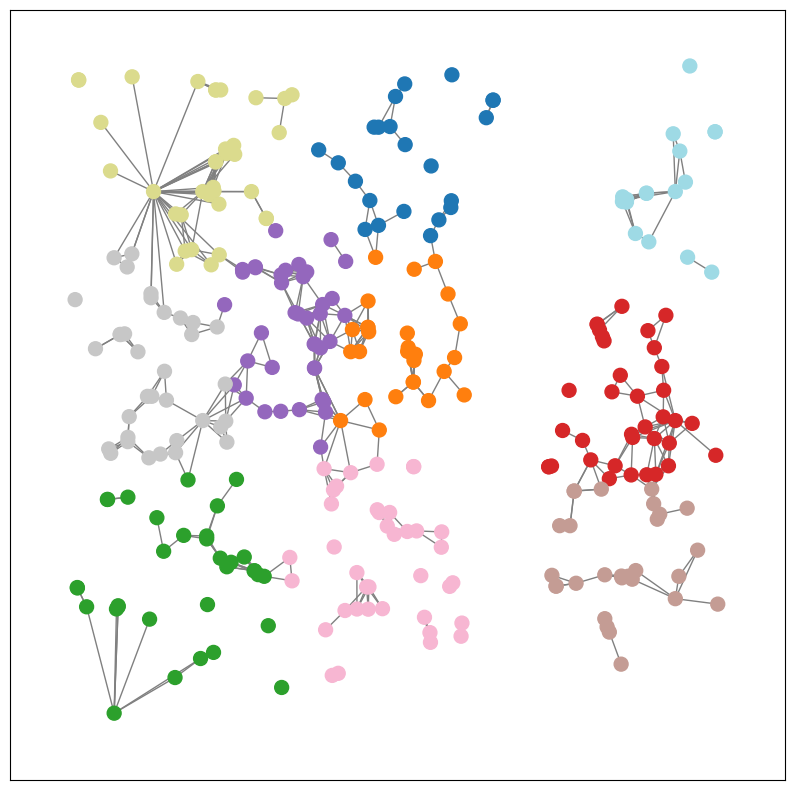

Time:  2
SSE  2  FULL  [30760446.0, 30716288.0]
------------KMeans Baseline Approach---------------
Time:  2 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


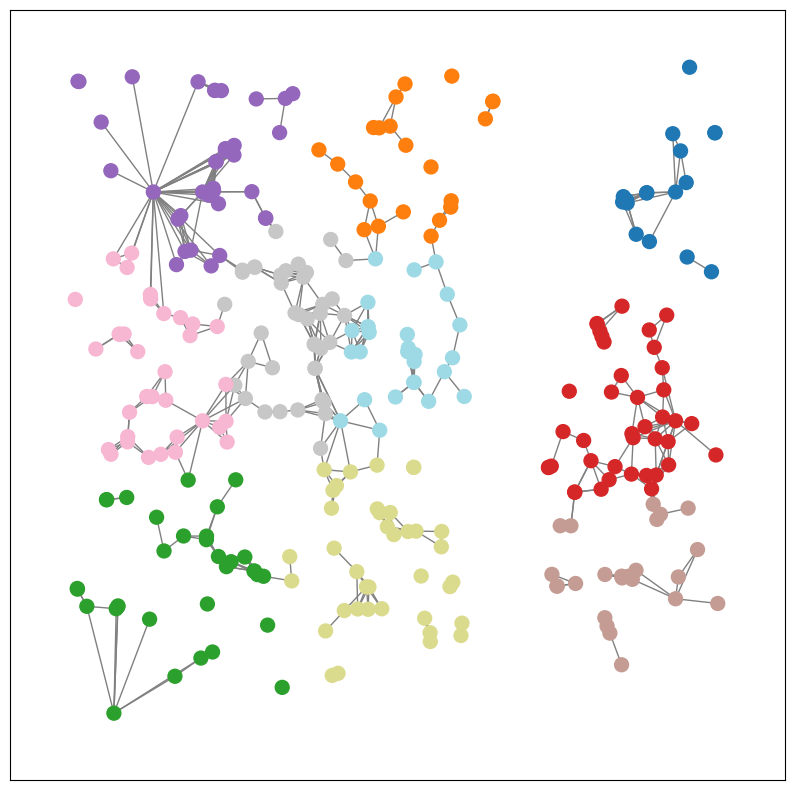

Time:  3
SSE  3  FULL  [30760446.0, 30716288.0, 30664816.0]
------------KMeans Baseline Approach---------------
Time:  3 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


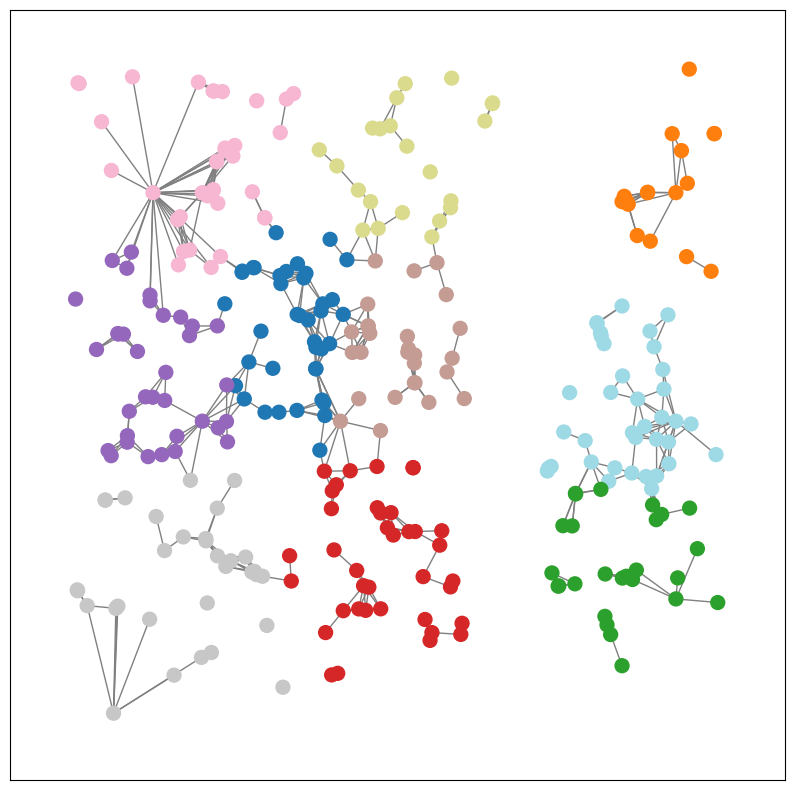

Time:  4
SSE  4  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0]
------------KMeans Baseline Approach---------------
Time:  4 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


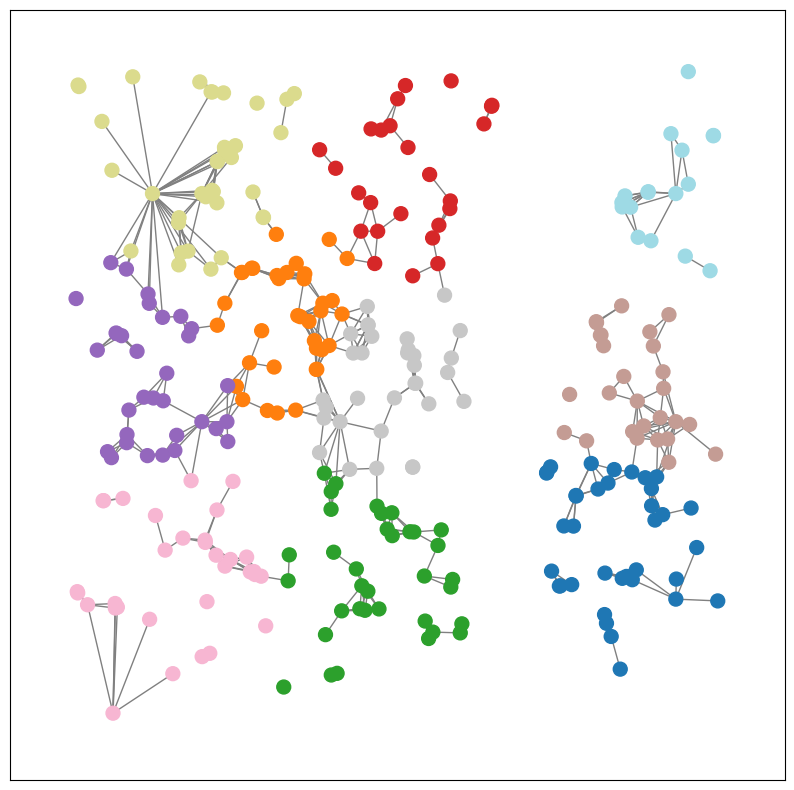

Time:  5
SSE  5  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0]
------------KMeans Baseline Approach---------------
Time:  5 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


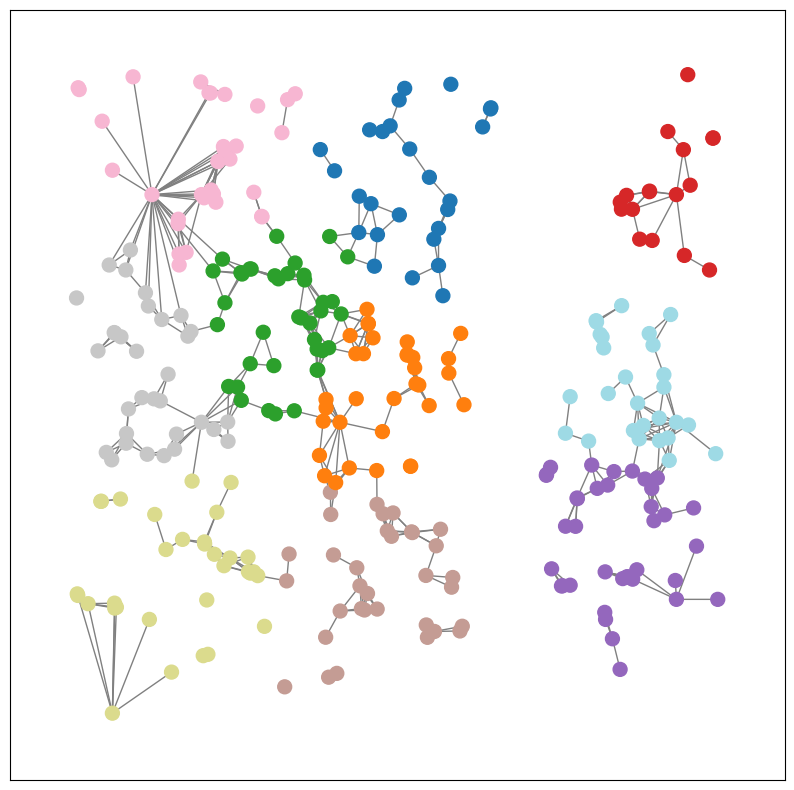

Time:  6
SSE  6  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0]
------------KMeans Baseline Approach---------------
Time:  6 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


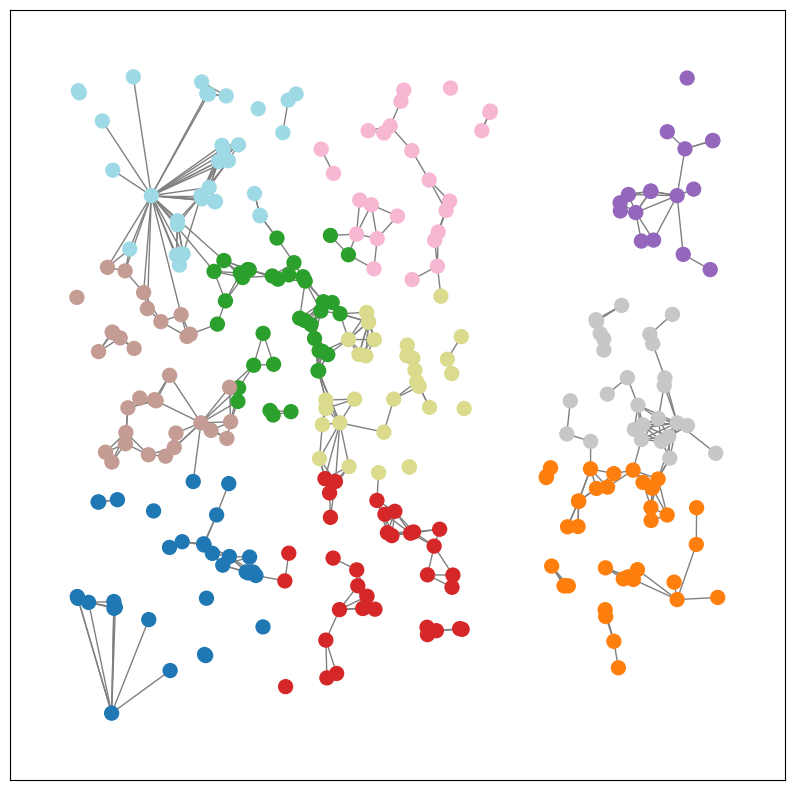

Time:  7
SSE  7  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0]
------------KMeans Baseline Approach---------------
Time:  7 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


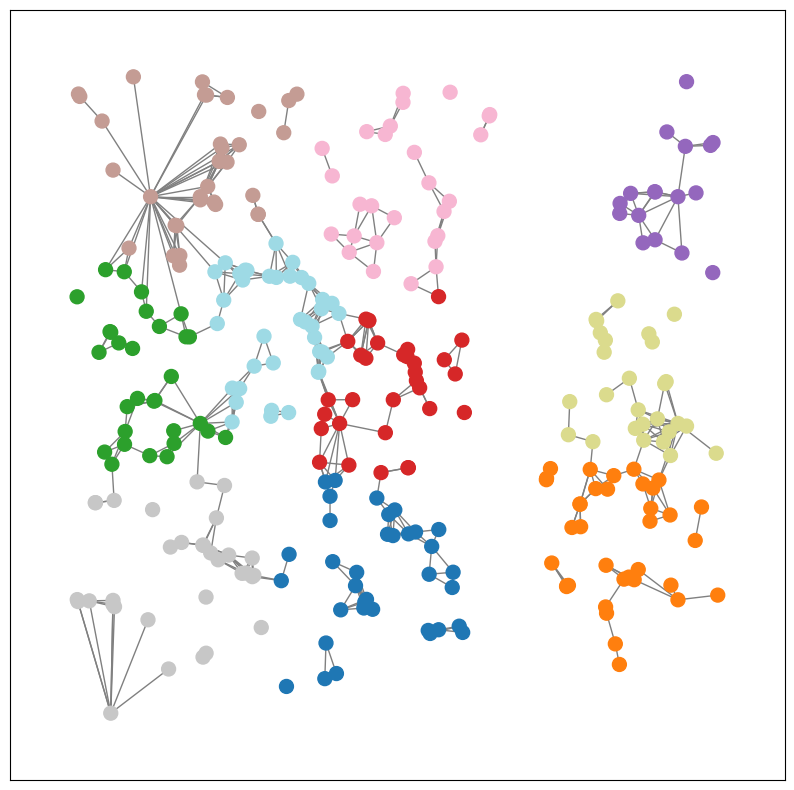

Time:  8
SSE  8  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0]
------------KMeans Baseline Approach---------------
Time:  8 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


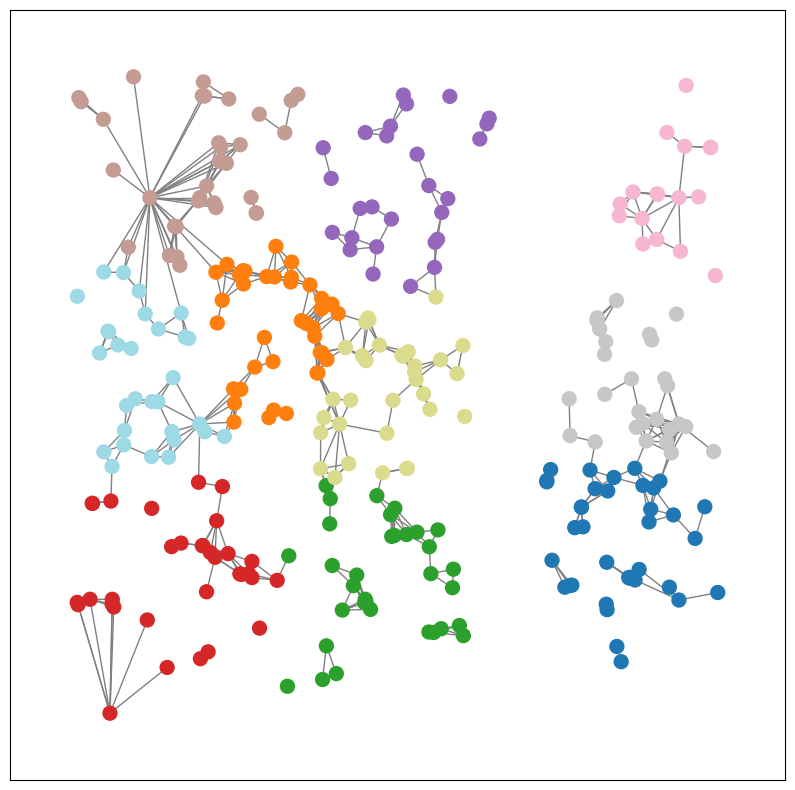

Time:  9
SSE  9  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0]
------------KMeans Baseline Approach---------------
Time:  9 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


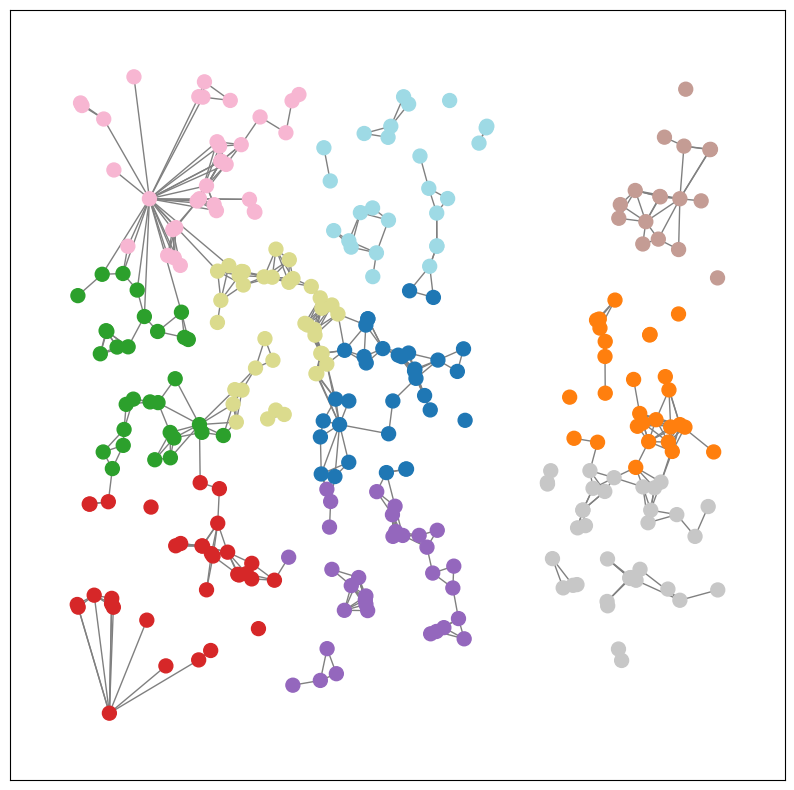

Time:  10
SSE  10  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0]
------------KMeans Baseline Approach---------------
Time:  10 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


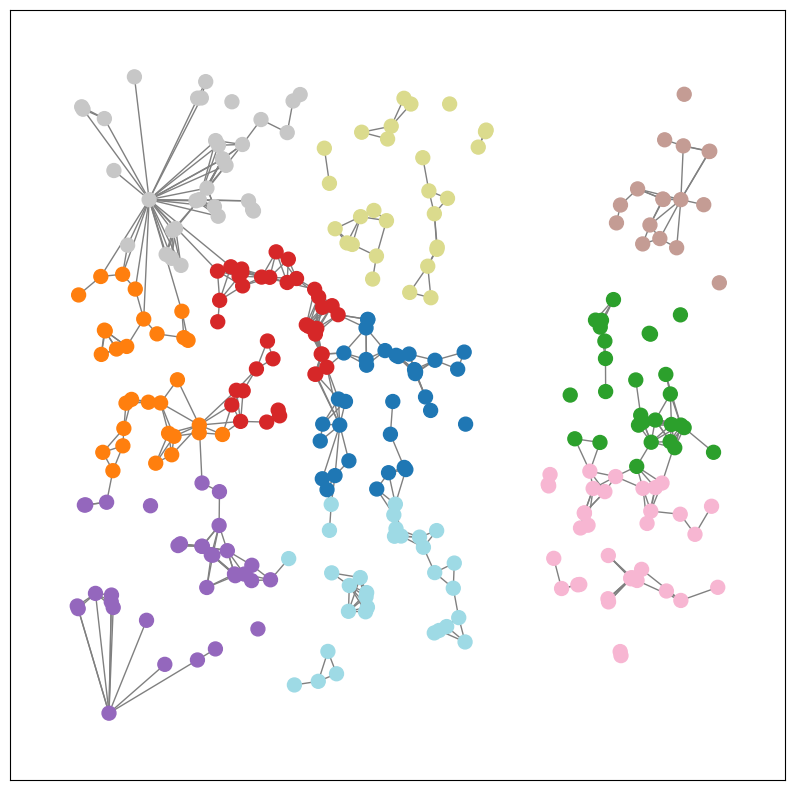

Time:  11
SSE  11  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0]
------------KMeans Baseline Approach---------------
Time:  11 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


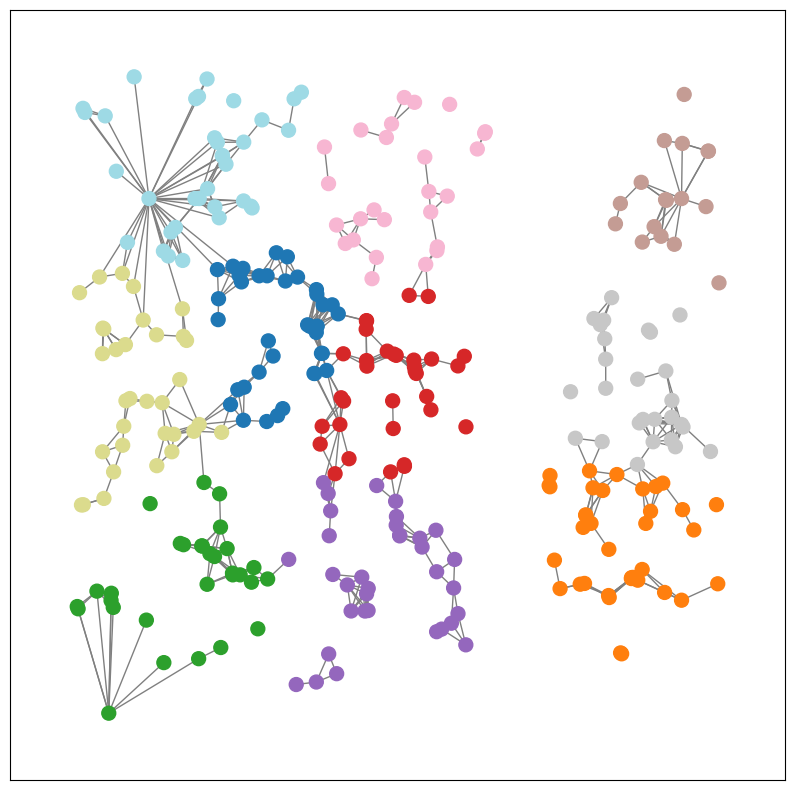

Time:  12
SSE  12  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0]
------------KMeans Baseline Approach---------------
Time:  12 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


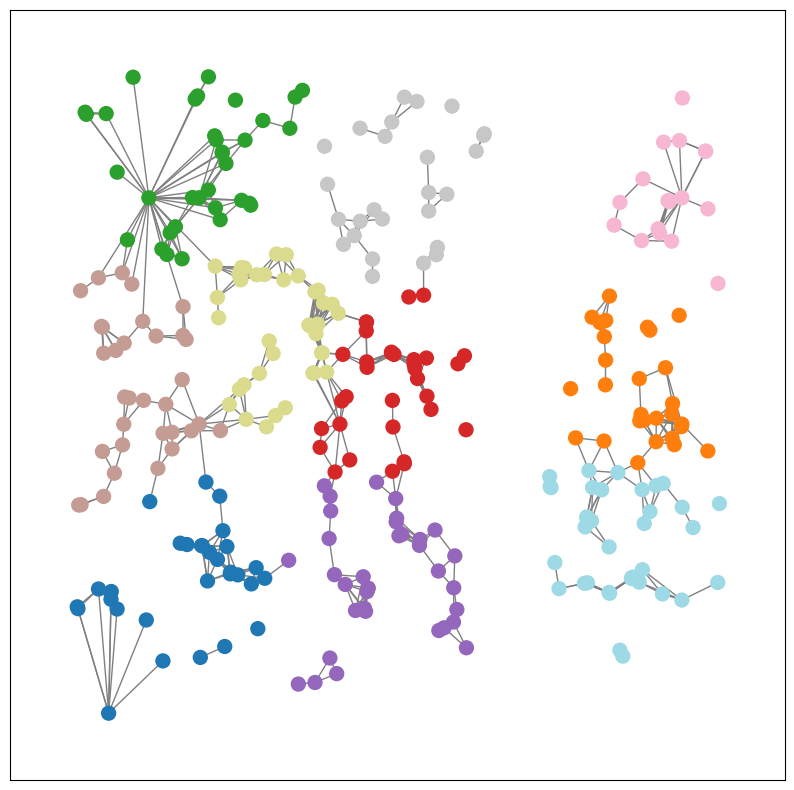

Time:  13
SSE  13  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0]
------------KMeans Baseline Approach---------------
Time:  13 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


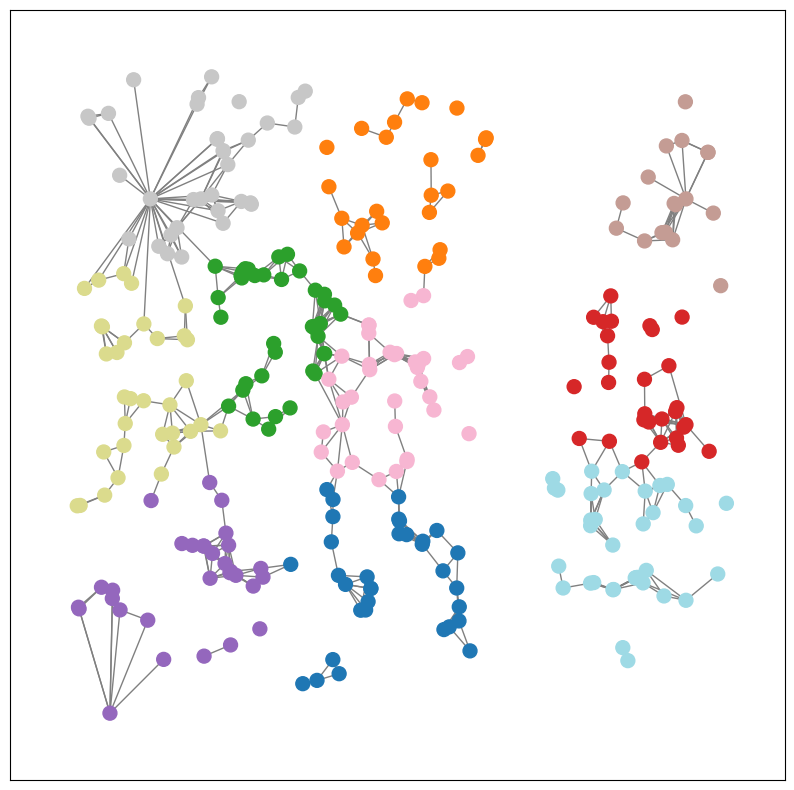

Time:  14
SSE  14  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0]
------------KMeans Baseline Approach---------------
Time:  14 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


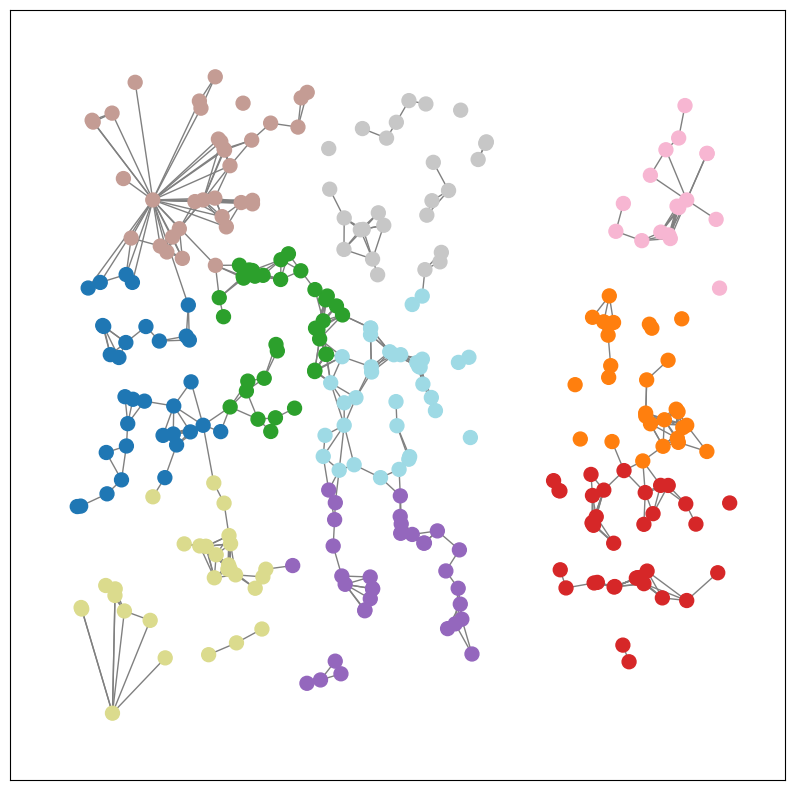

Time:  15
SSE  15  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0]
------------KMeans Baseline Approach---------------
Time:  15 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


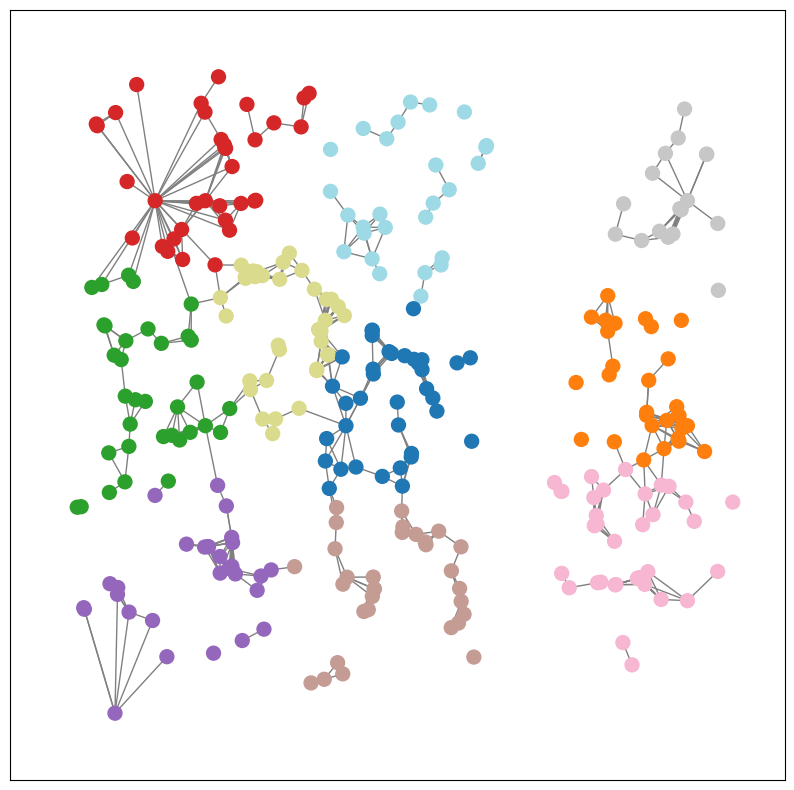

Time:  16
SSE  16  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0]
------------KMeans Baseline Approach---------------
Time:  16 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


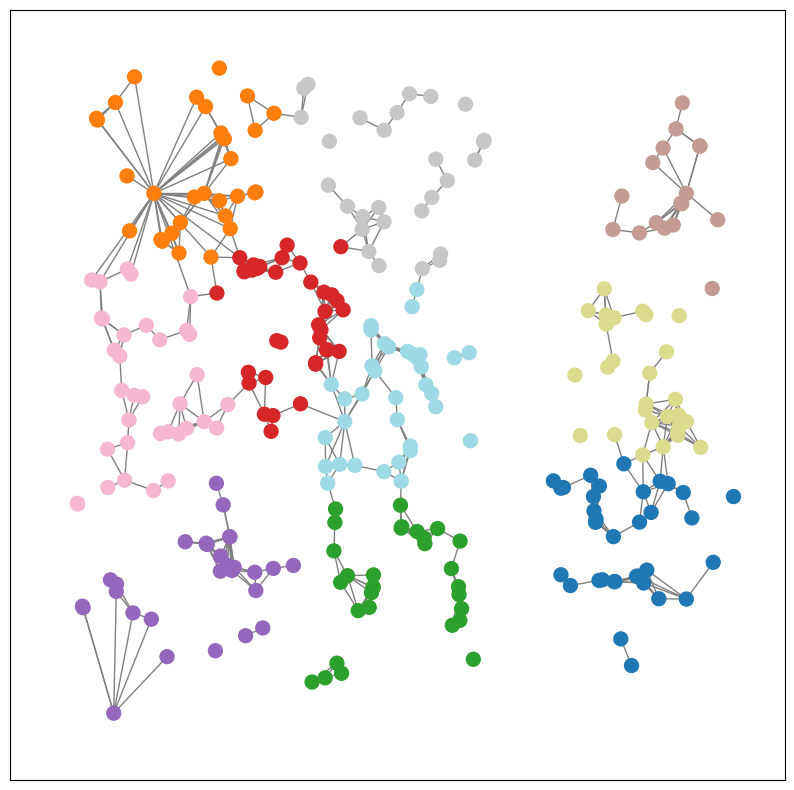

Time:  17
SSE  17  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0]
------------KMeans Baseline Approach---------------
Time:  17 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


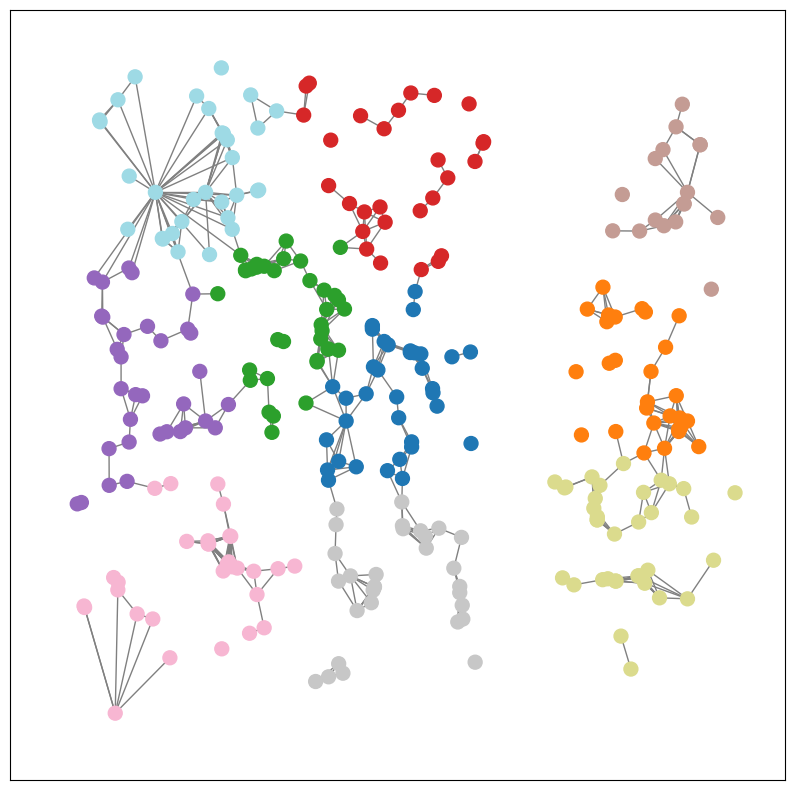

Time:  18
SSE  18  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0]
------------KMeans Baseline Approach---------------
Time:  18 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


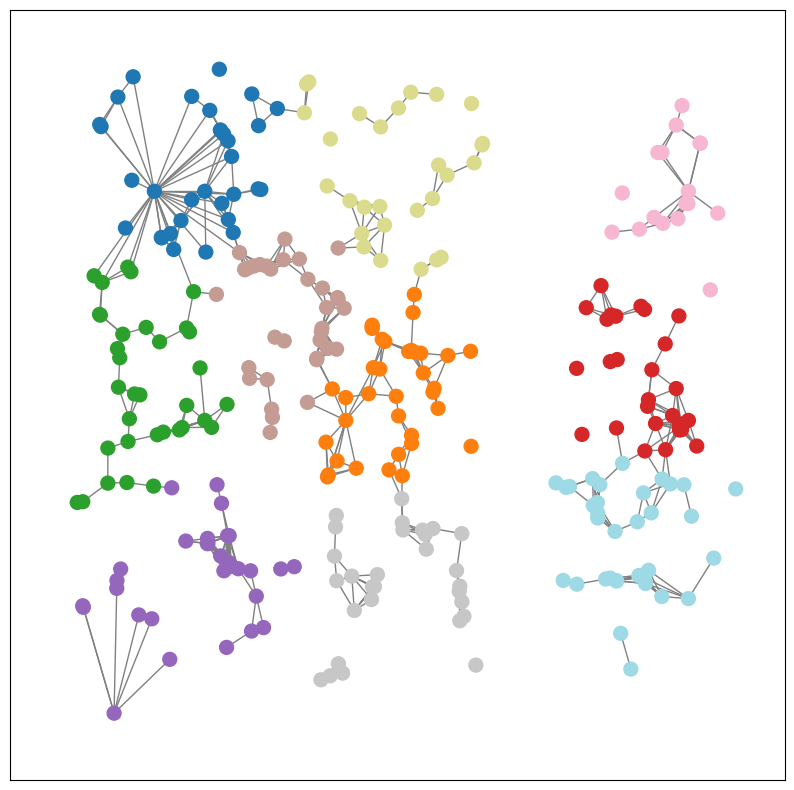

Time:  19
SSE  19  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0]
------------KMeans Baseline Approach---------------
Time:  19 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


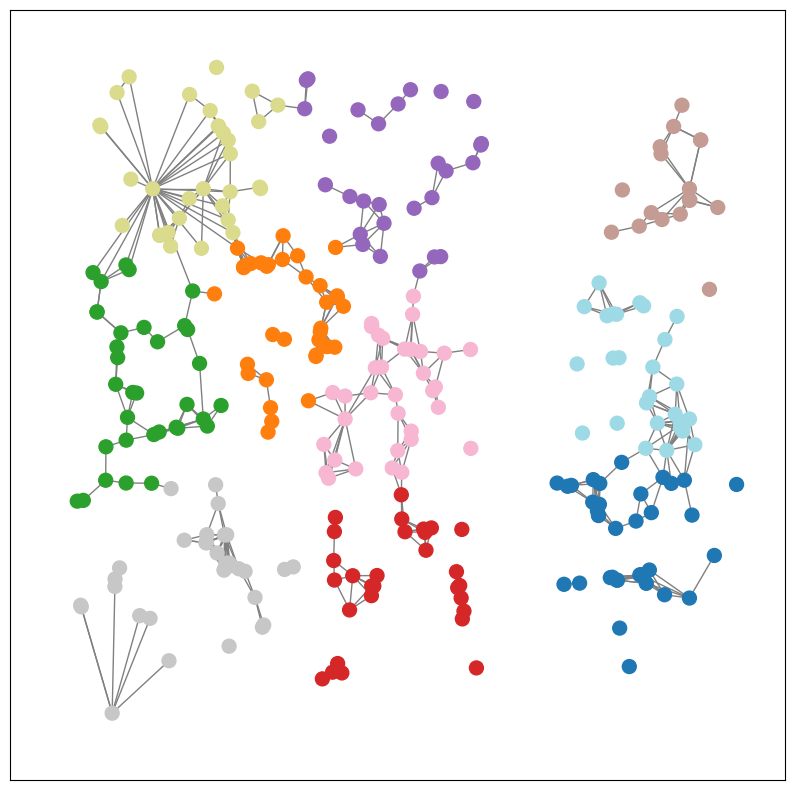

Time:  20
SSE  20  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0]
------------KMeans Baseline Approach---------------
Time:  20 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


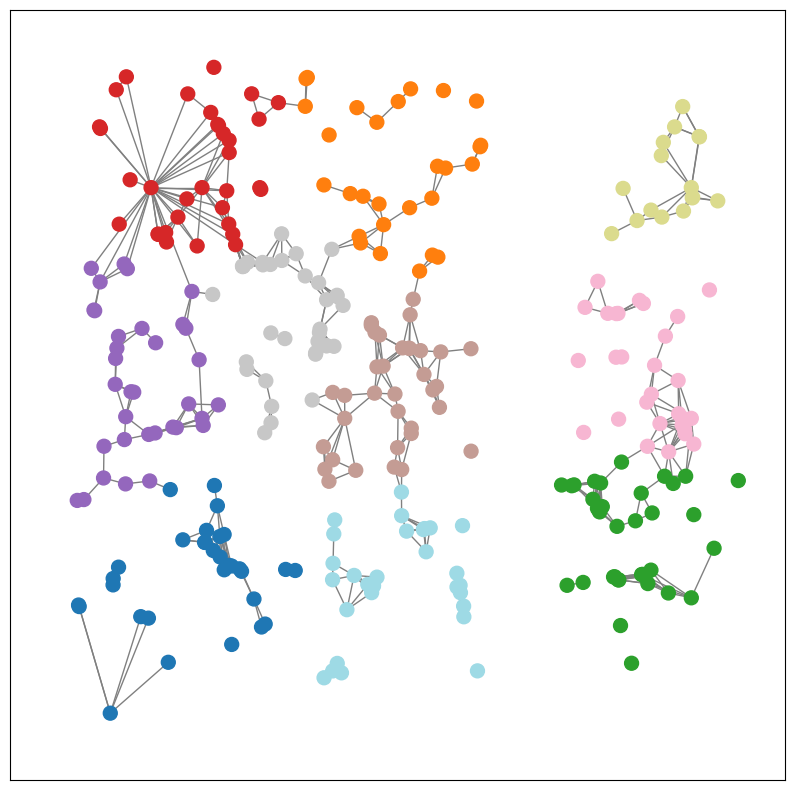

Time:  21
SSE  21  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0]
------------KMeans Baseline Approach---------------
Time:  21 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


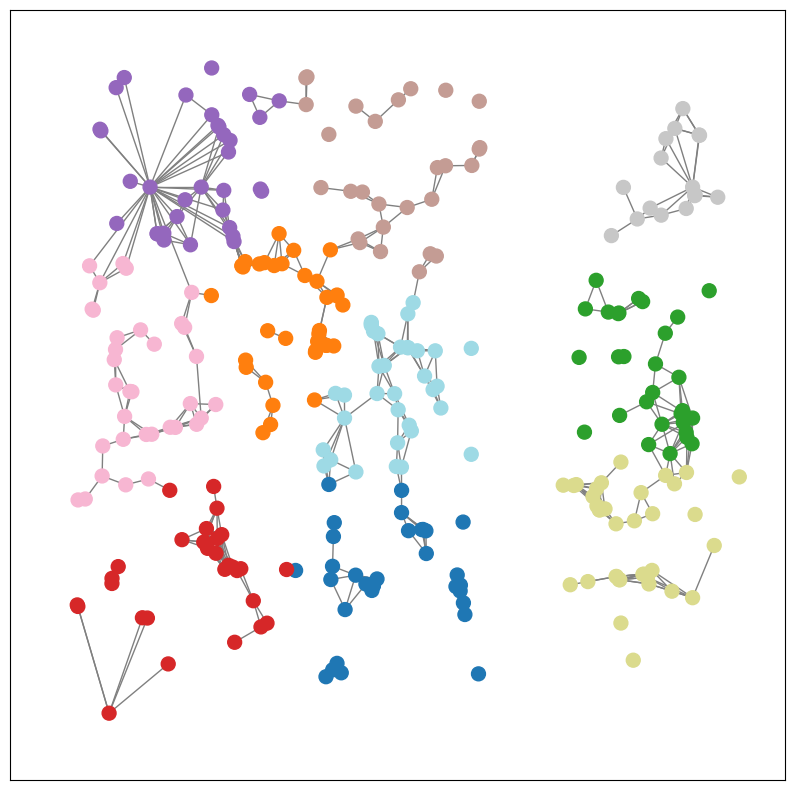

Time:  22
SSE  22  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0]
------------KMeans Baseline Approach---------------
Time:  22 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


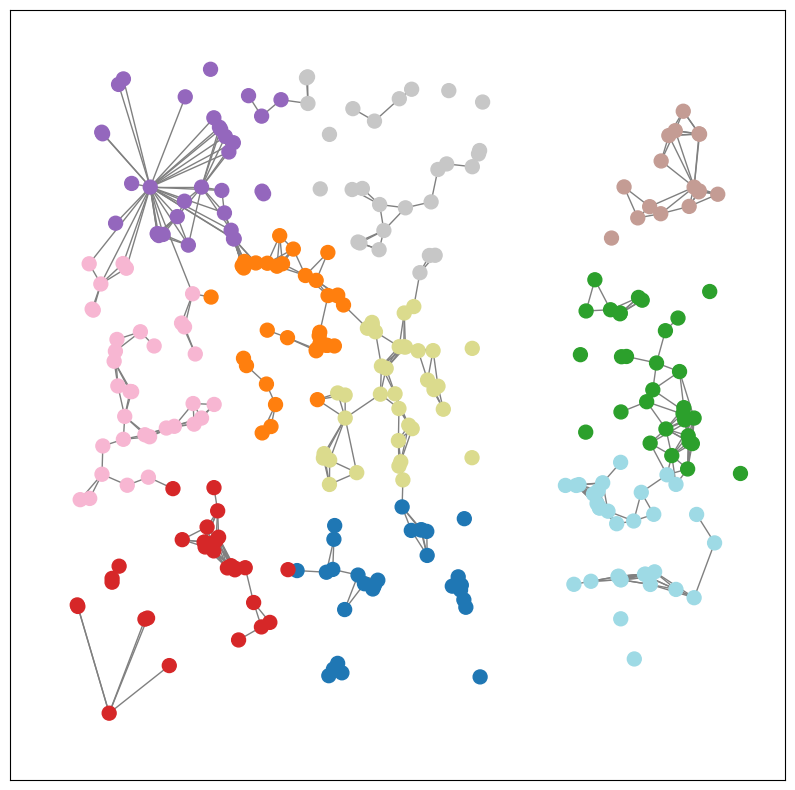

Time:  23
SSE  23  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0]
------------KMeans Baseline Approach---------------
Time:  23 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


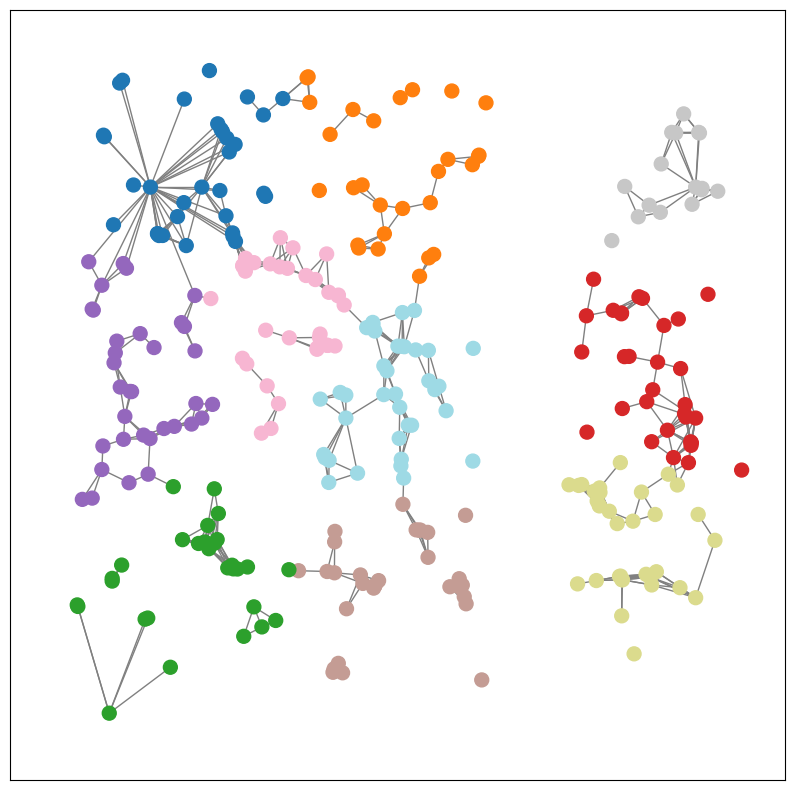

Time:  24
SSE  24  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0]
------------KMeans Baseline Approach---------------
Time:  24 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


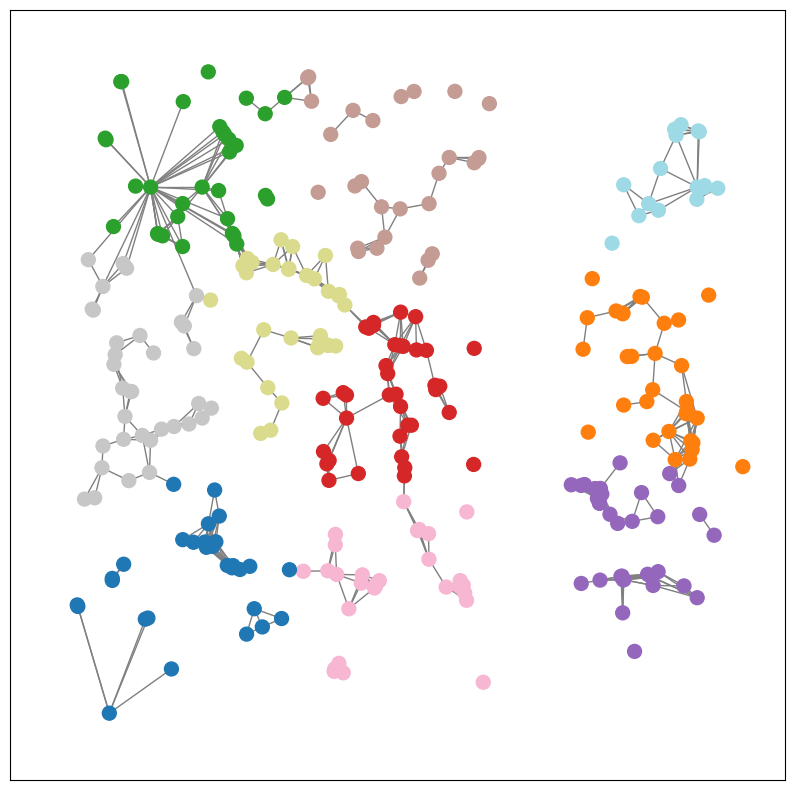

Time:  25
SSE  25  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0]
------------KMeans Baseline Approach---------------
Time:  25 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


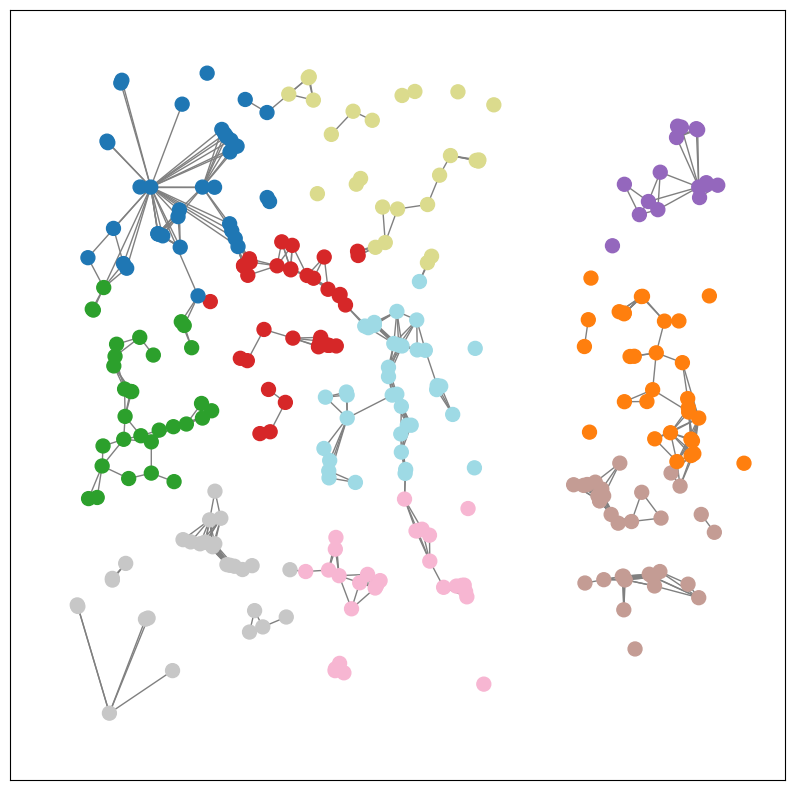

Time:  26
SSE  26  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0]
------------KMeans Baseline Approach---------------
Time:  26 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


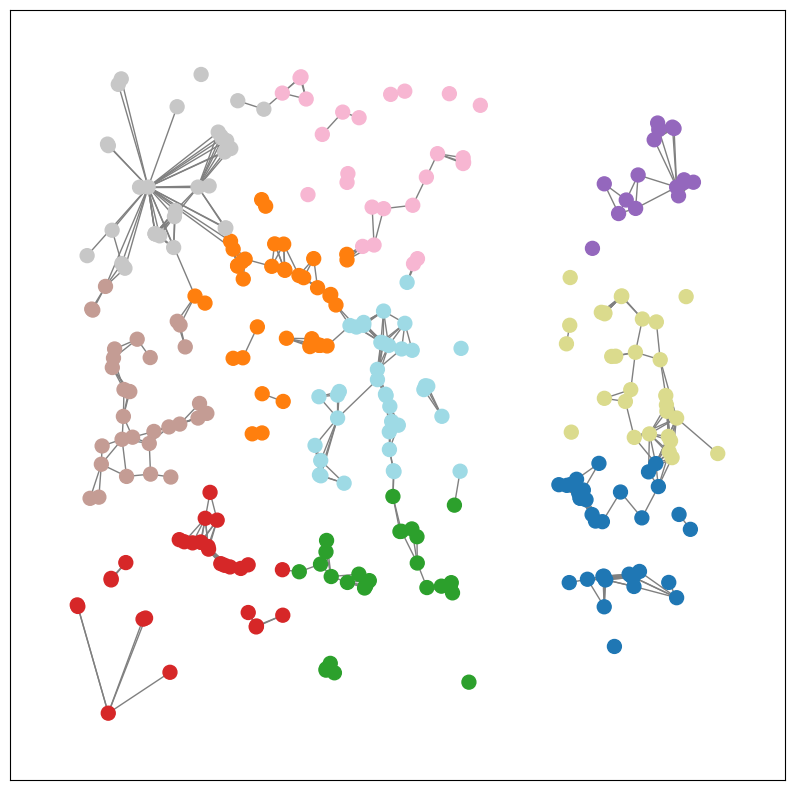

Time:  27
SSE  27  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0]
------------KMeans Baseline Approach---------------
Time:  27 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


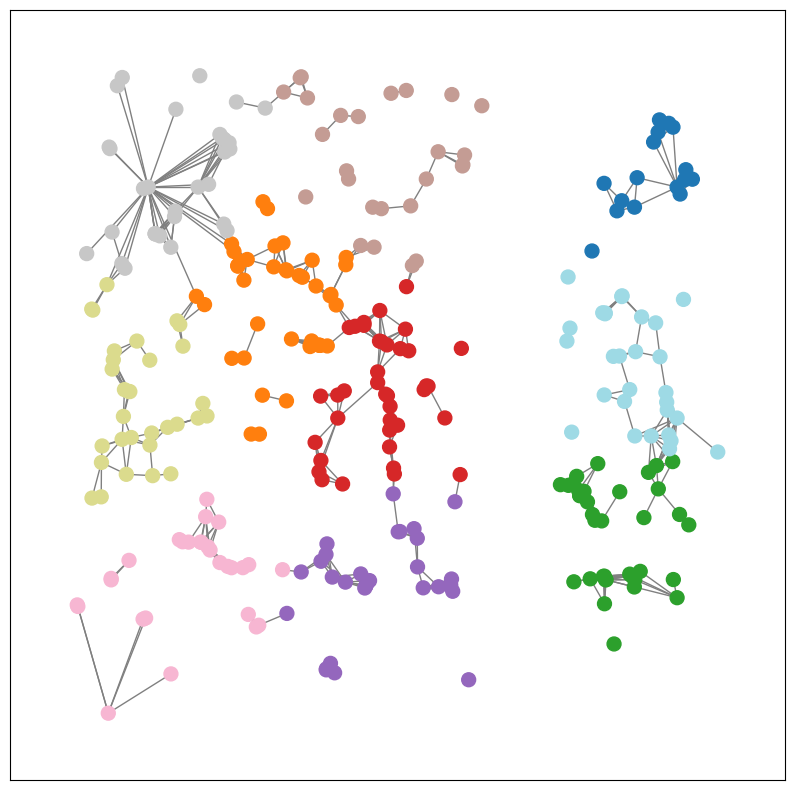

Time:  28
SSE  28  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0]
------------KMeans Baseline Approach---------------
Time:  28 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


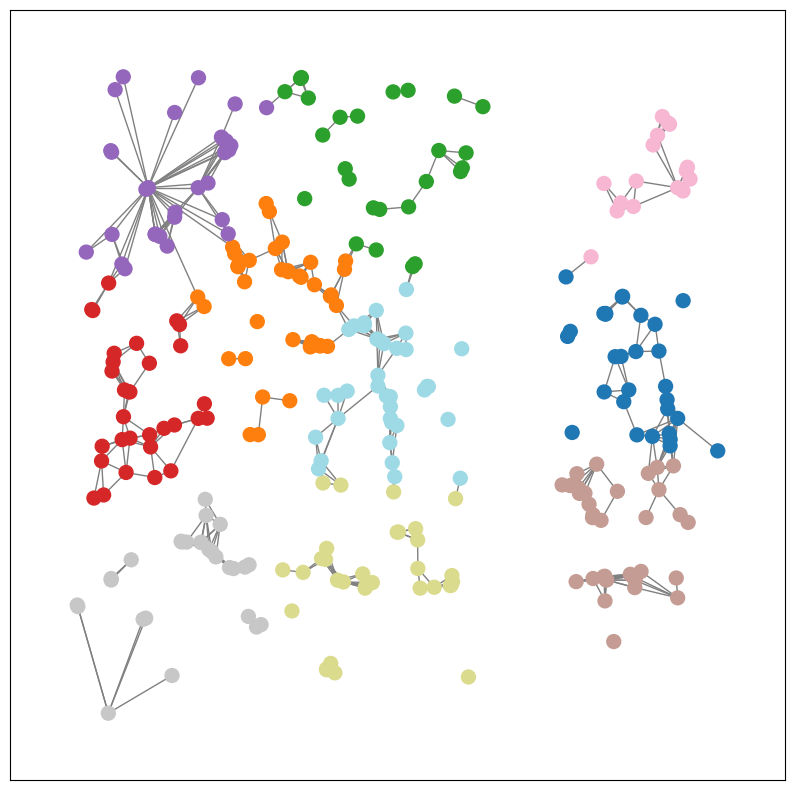

Time:  29
SSE  29  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0]
------------KMeans Baseline Approach---------------
Time:  29 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


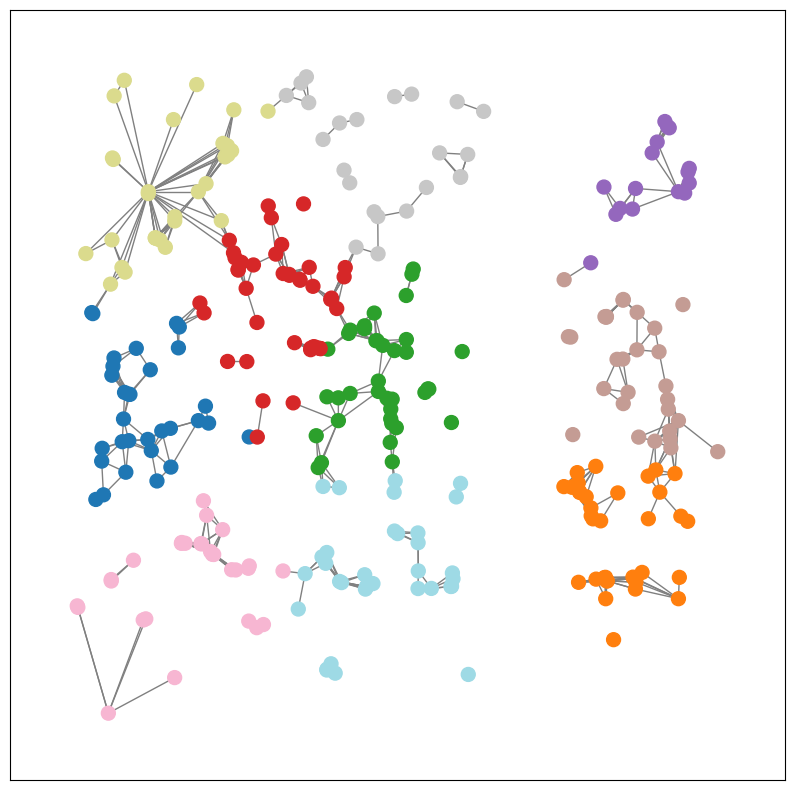

Time:  30
SSE  30  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0]
------------KMeans Baseline Approach---------------
Time:  30 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


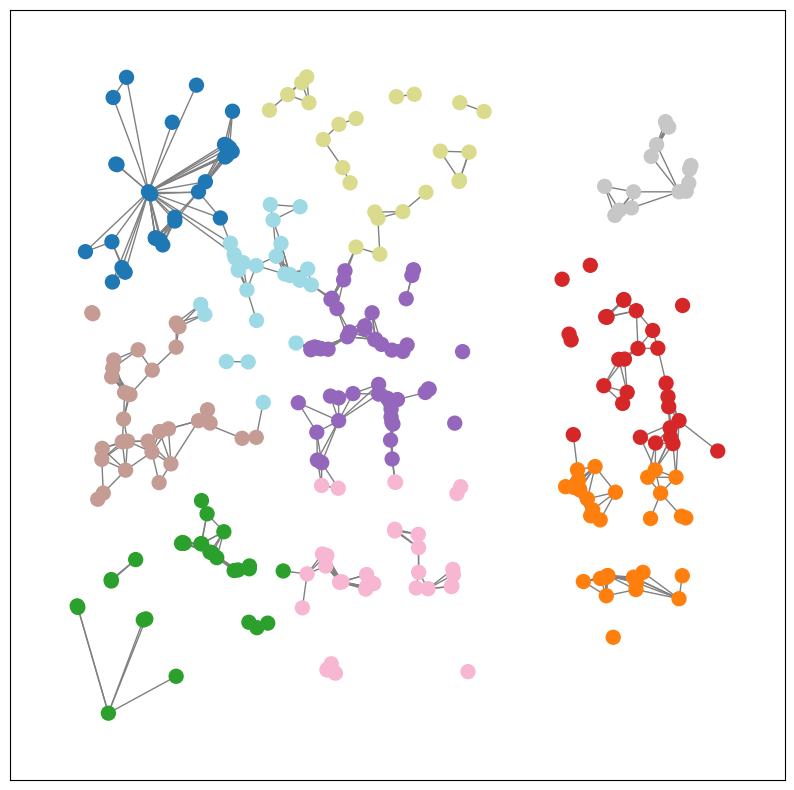

Time:  31
SSE  31  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0]
------------KMeans Baseline Approach---------------
Time:  31 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


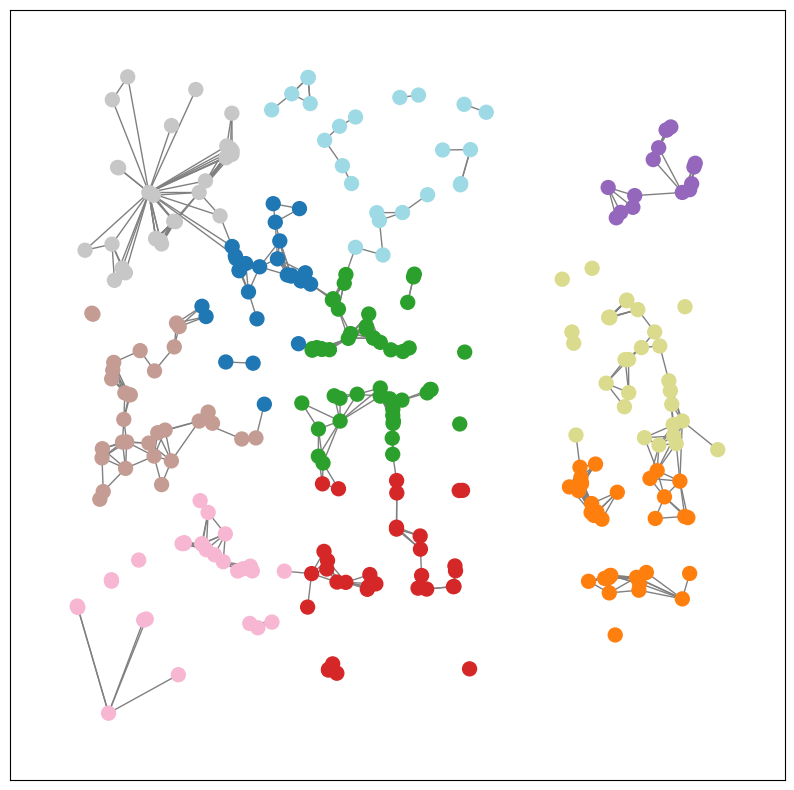

Time:  32
SSE  32  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0]
------------KMeans Baseline Approach---------------
Time:  32 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


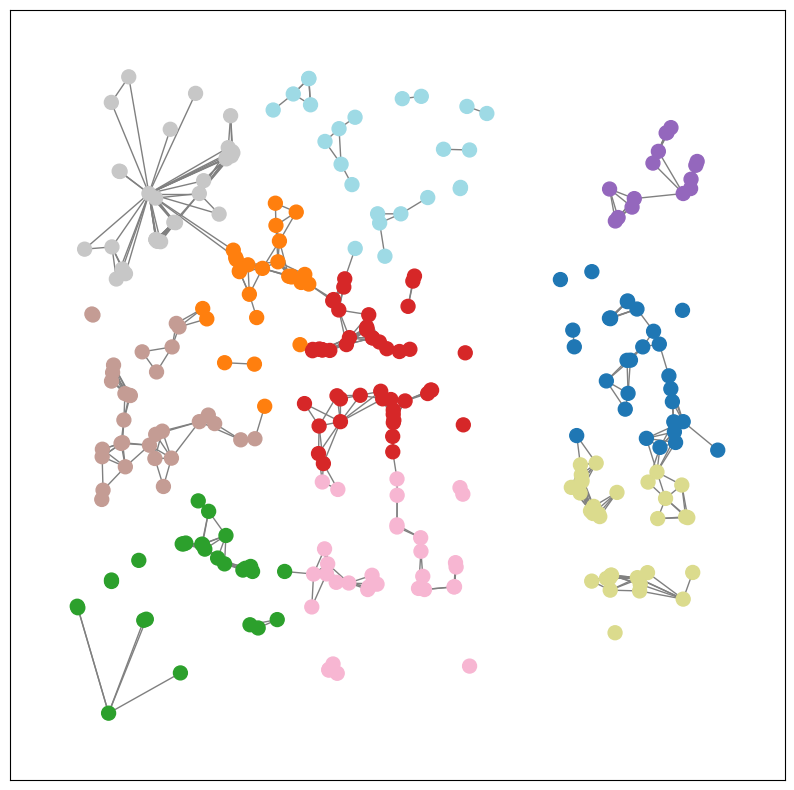

Time:  33
SSE  33  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0]
------------KMeans Baseline Approach---------------
Time:  33 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


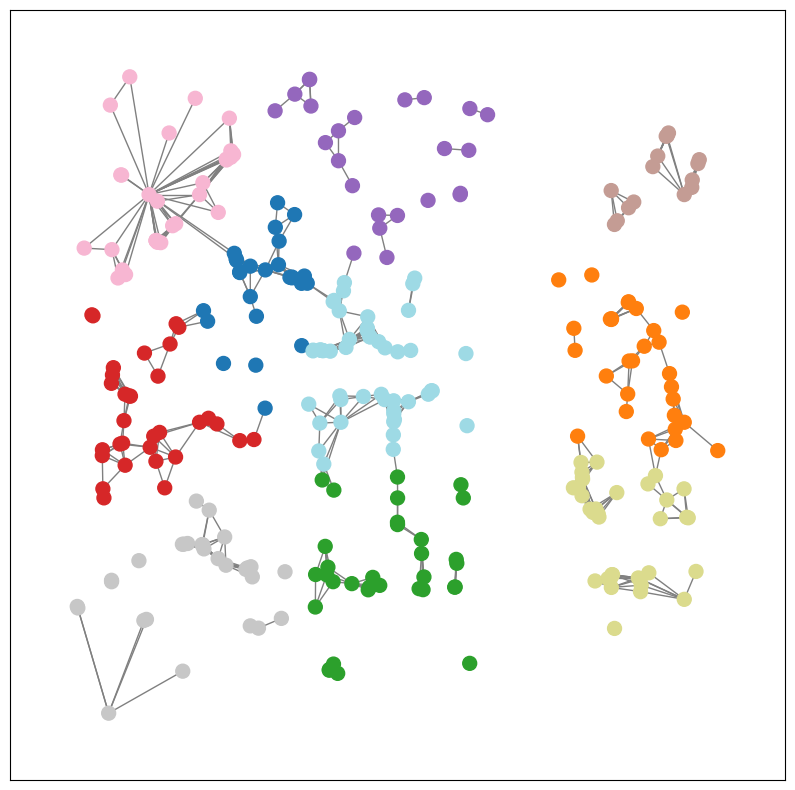

Time:  34
SSE  34  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0]
------------KMeans Baseline Approach---------------
Time:  34 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


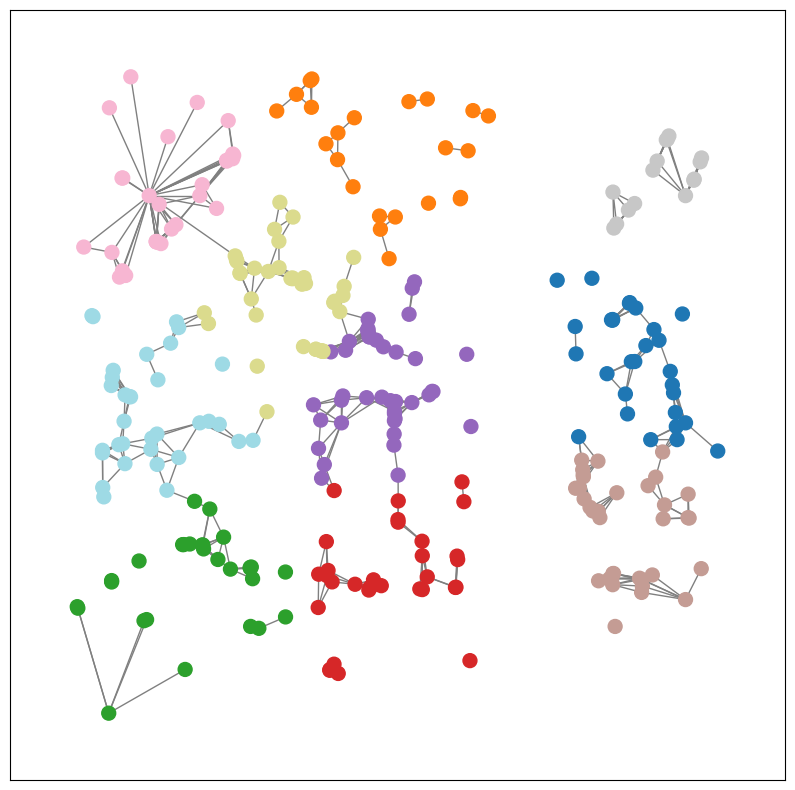

Time:  35
SSE  35  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0]
------------KMeans Baseline Approach---------------
Time:  35 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


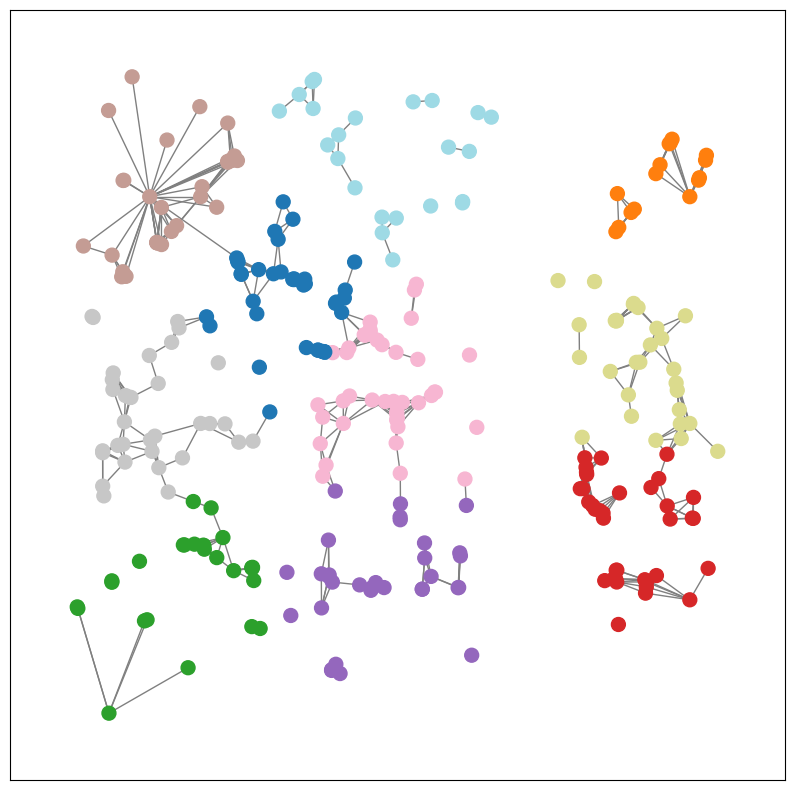

Time:  36
SSE  36  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0]
------------KMeans Baseline Approach---------------
Time:  36 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


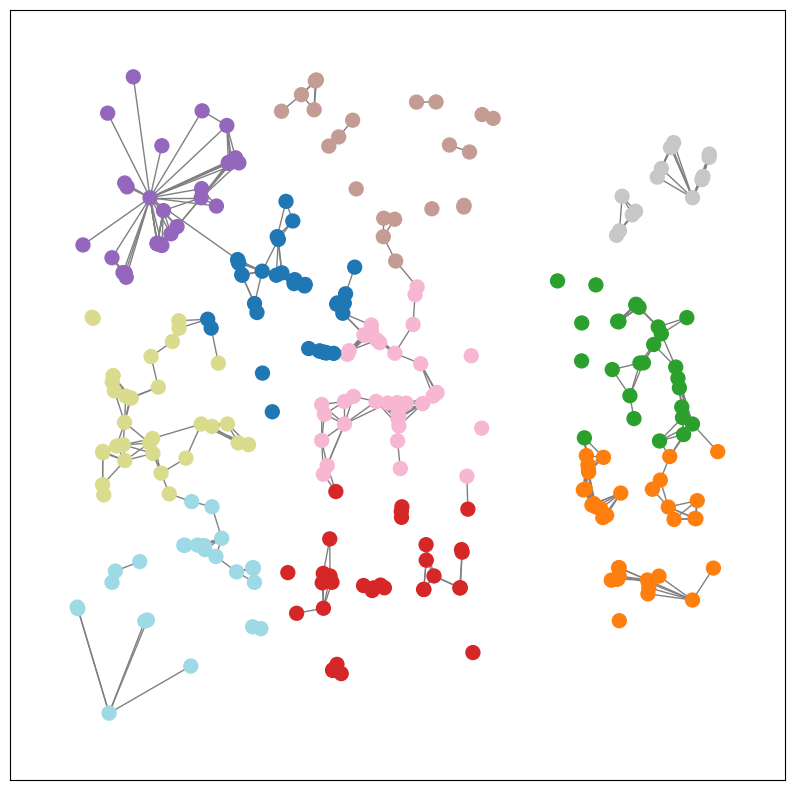

Time:  37
SSE  37  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0]
------------KMeans Baseline Approach---------------
Time:  37 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


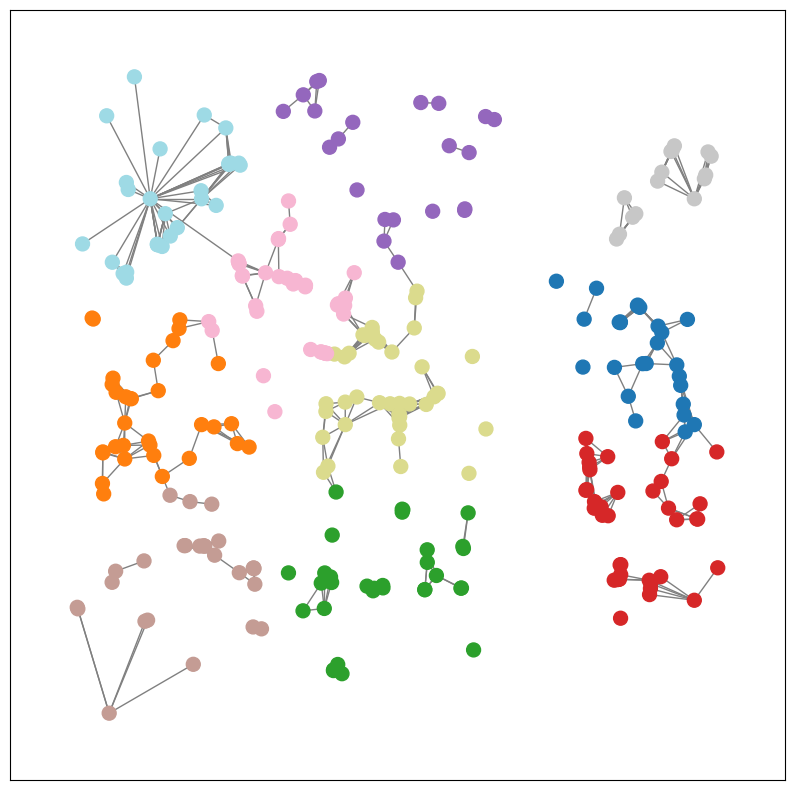

Time:  38
SSE  38  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0]
------------KMeans Baseline Approach---------------
Time:  38 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


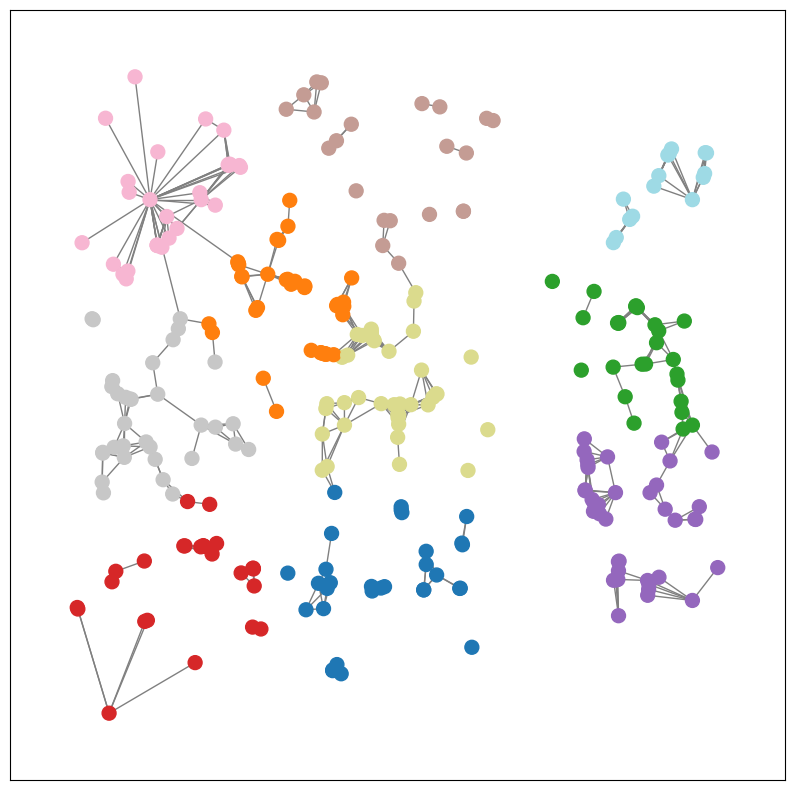

Time:  39
SSE  39  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0]
------------KMeans Baseline Approach---------------
Time:  39 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


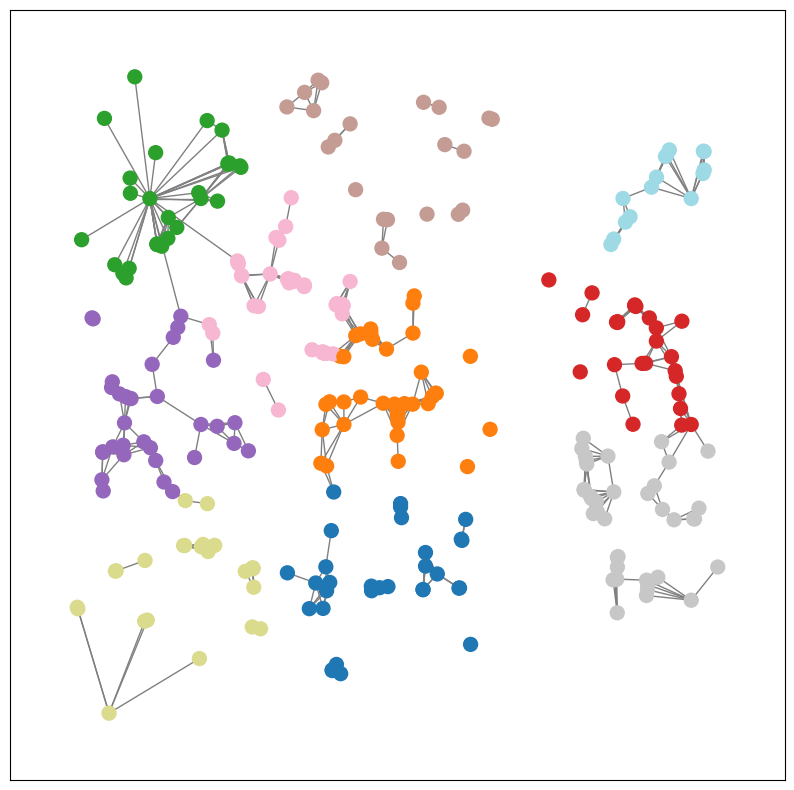

Time:  40
SSE  40  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0]
------------KMeans Baseline Approach---------------
Time:  40 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


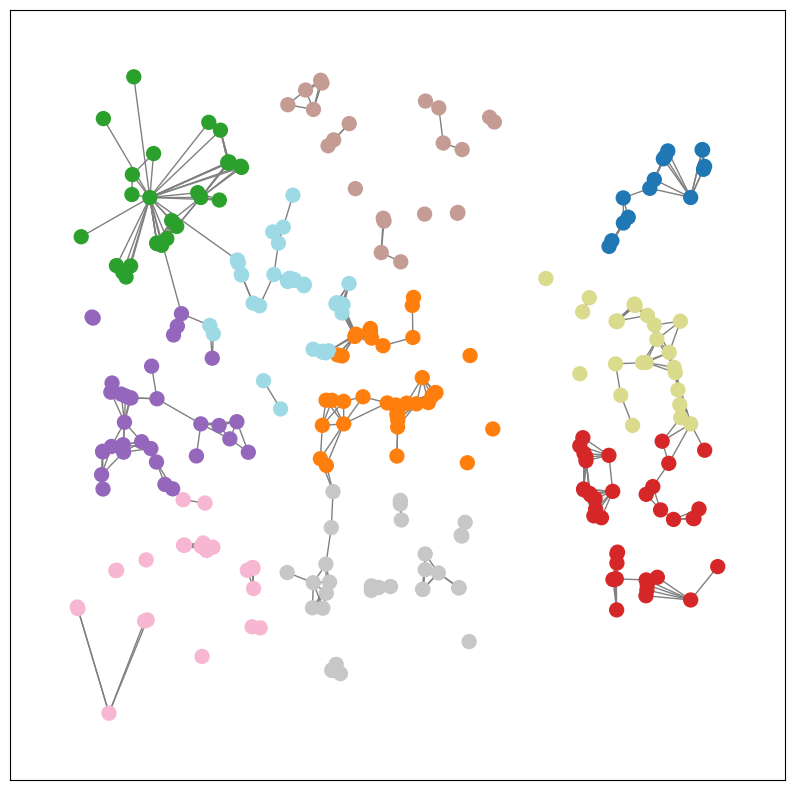

Time:  41
SSE  41  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0]
------------KMeans Baseline Approach---------------
Time:  41 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


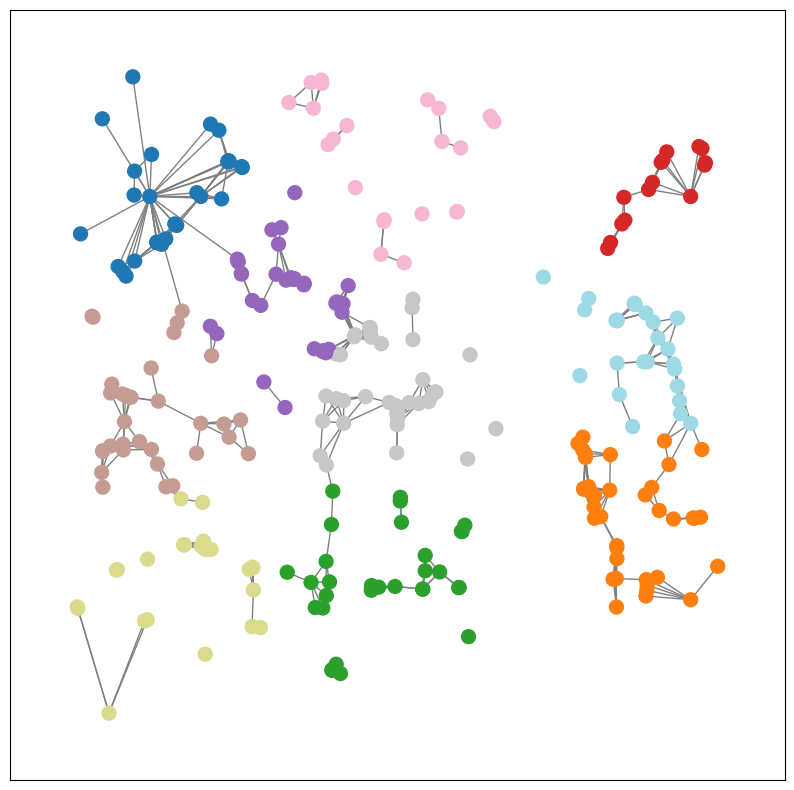

Time:  42
SSE  42  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0]
------------KMeans Baseline Approach---------------
Time:  42 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


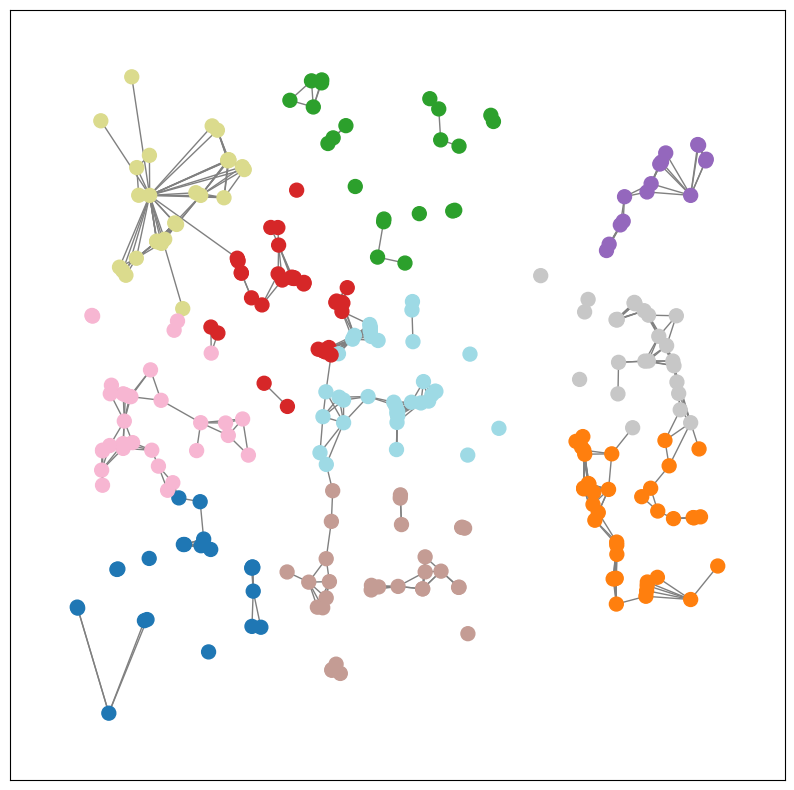

Time:  43
SSE  43  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0]
------------KMeans Baseline Approach---------------
Time:  43 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


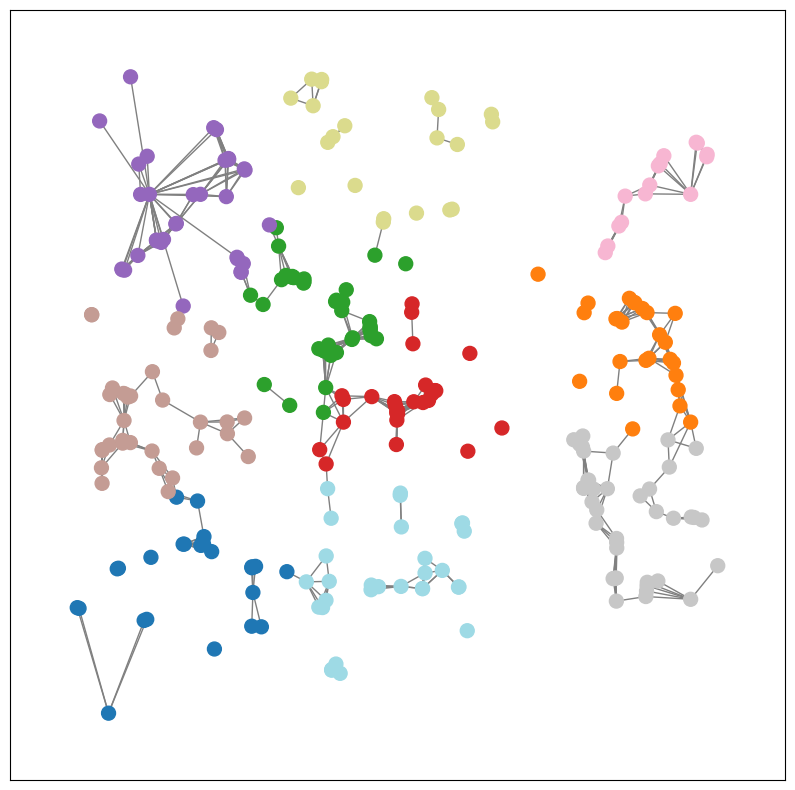

Time:  44
SSE  44  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0]
------------KMeans Baseline Approach---------------
Time:  44 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


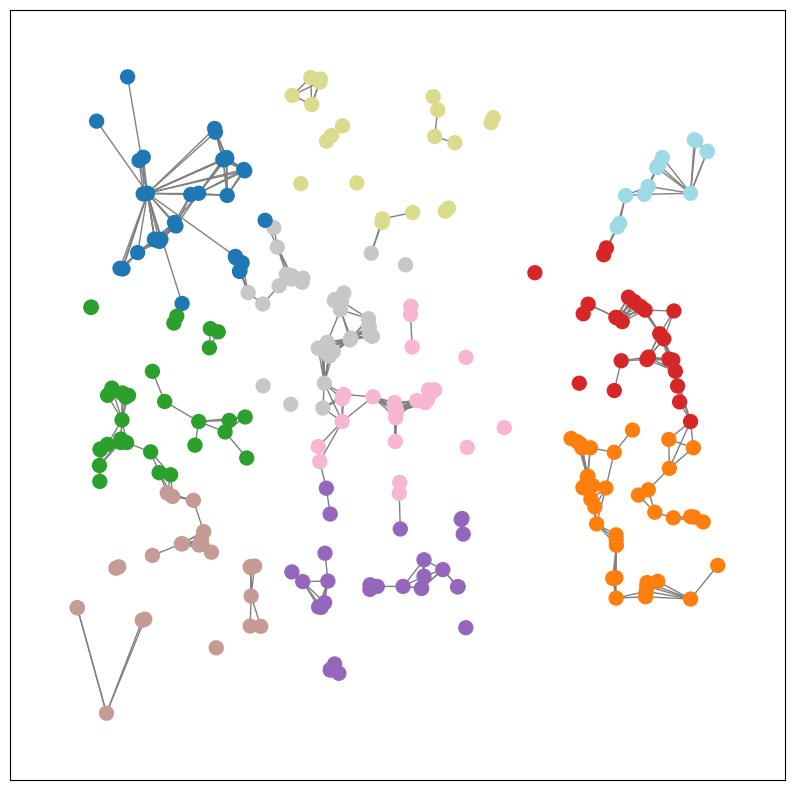

Time:  45
SSE  45  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0]
------------KMeans Baseline Approach---------------
Time:  45 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


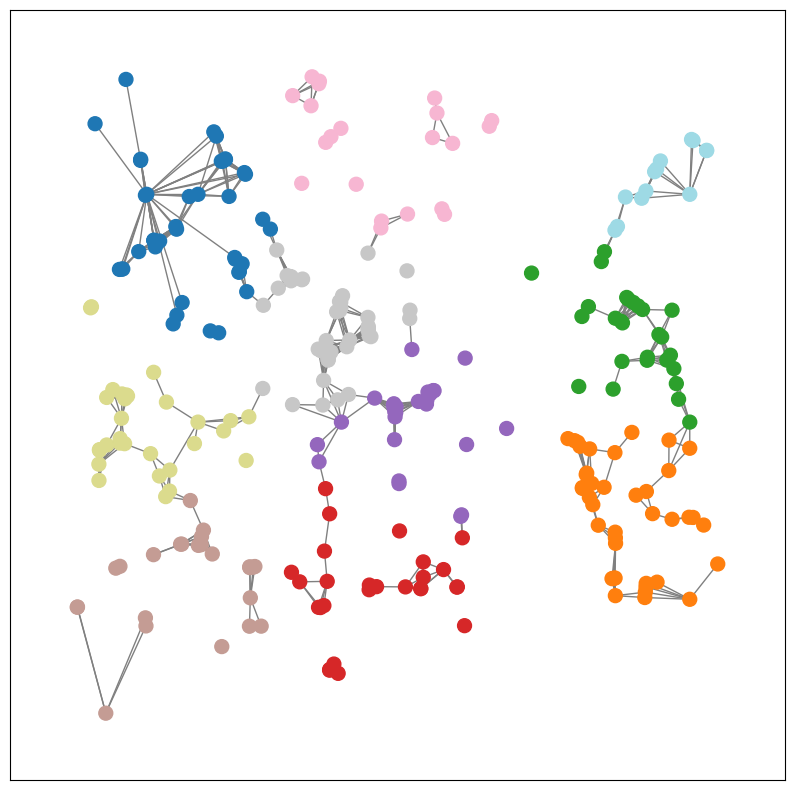

Time:  46
SSE  46  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0]
------------KMeans Baseline Approach---------------
Time:  46 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


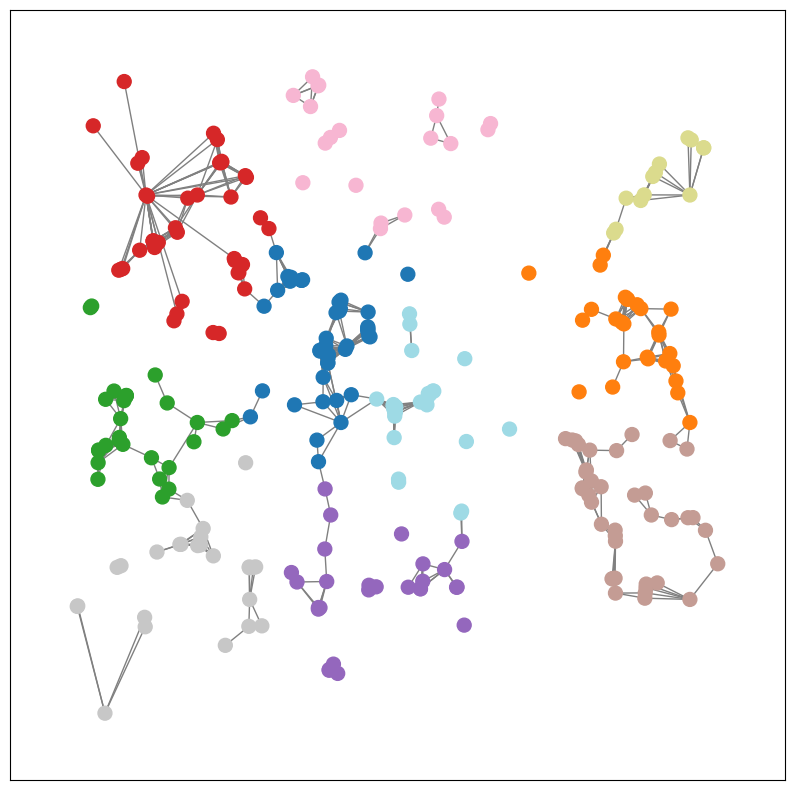

Time:  47
SSE  47  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0]
------------KMeans Baseline Approach---------------
Time:  47 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


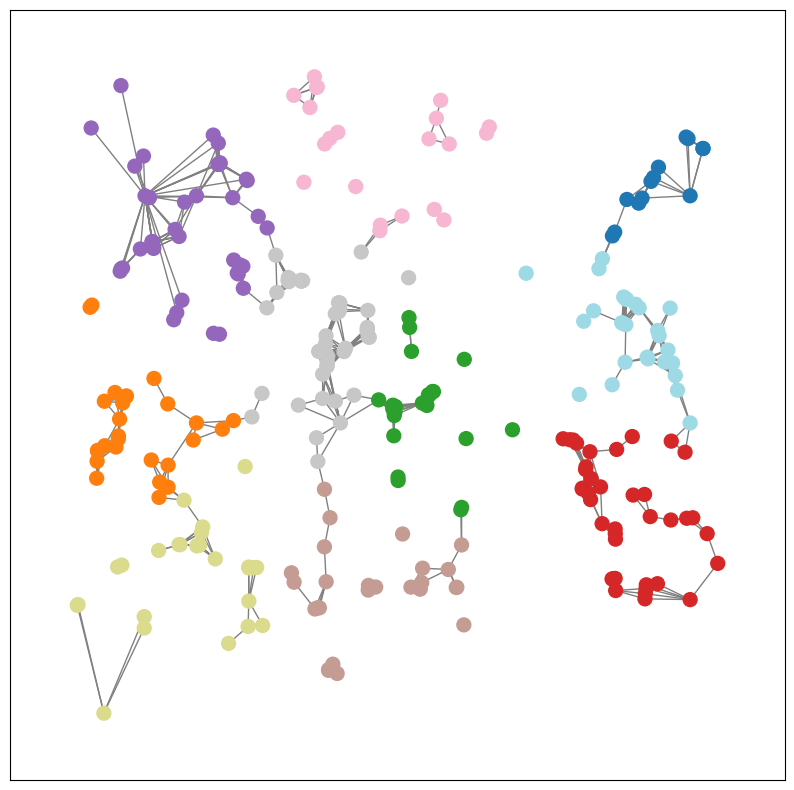

Time:  48
SSE  48  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0]
------------KMeans Baseline Approach---------------
Time:  48 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


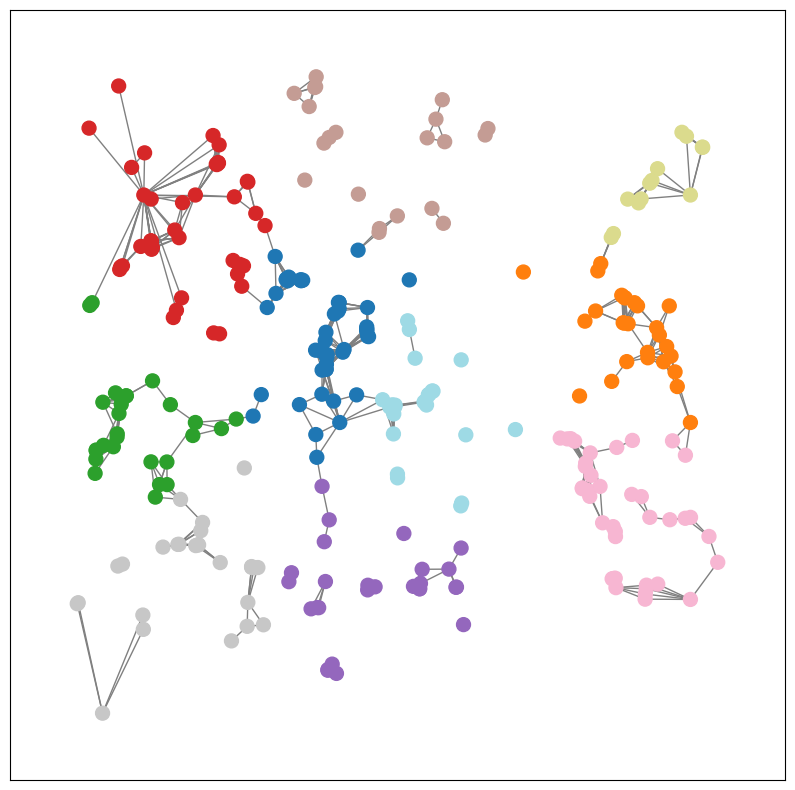

Time:  49
SSE  49  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0]
------------KMeans Baseline Approach---------------
Time:  49 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


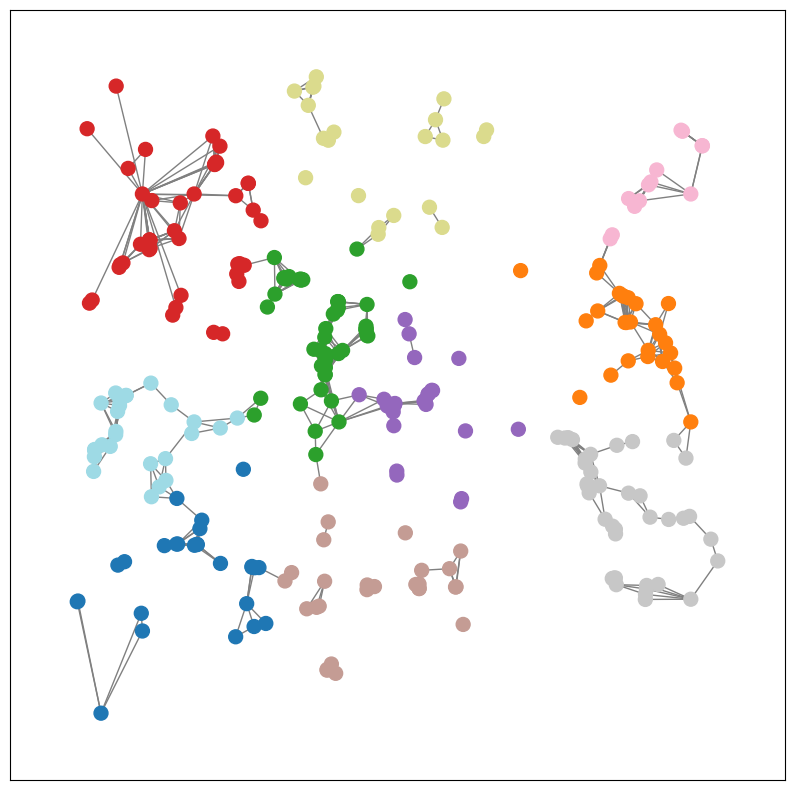

Time:  50
SSE  50  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0]
------------KMeans Baseline Approach---------------
Time:  50 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


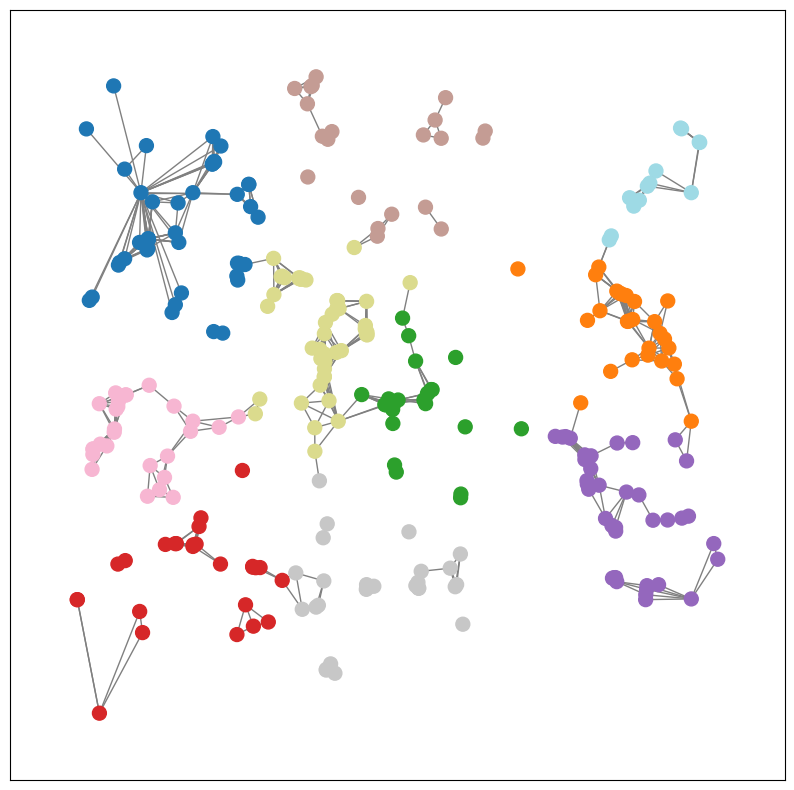

Time:  51
SSE  51  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0]
------------KMeans Baseline Approach---------------
Time:  51 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


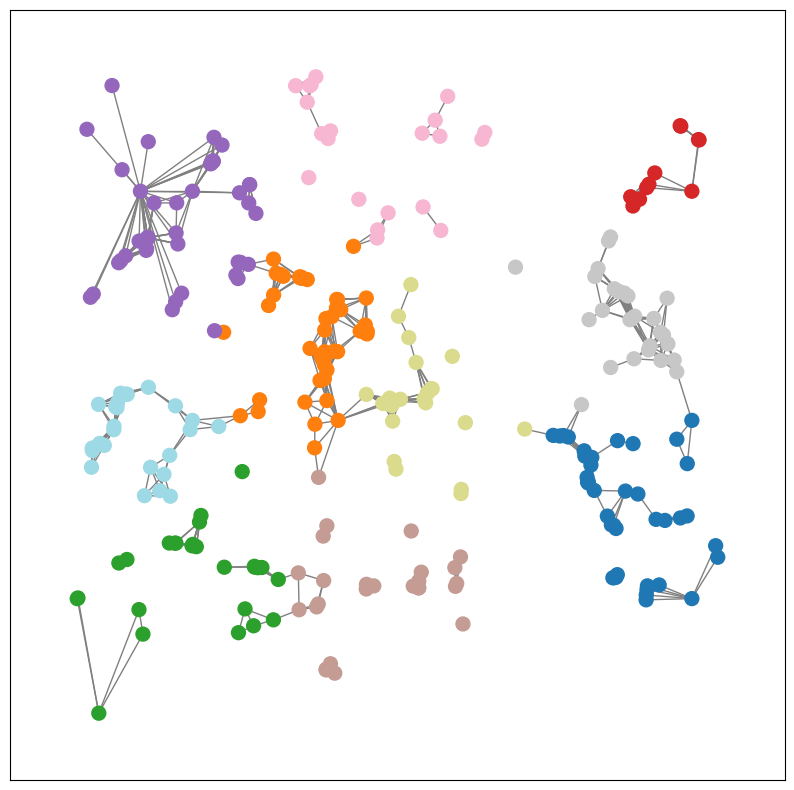

Time:  52
SSE  52  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0]
------------KMeans Baseline Approach---------------
Time:  52 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


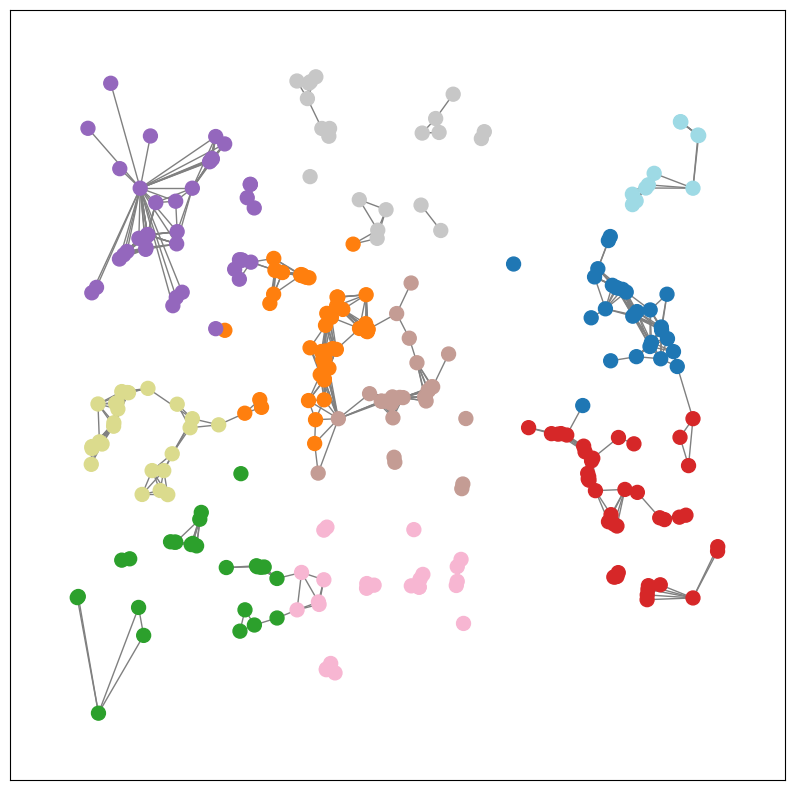

Time:  53
SSE  53  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0]
------------KMeans Baseline Approach---------------
Time:  53 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


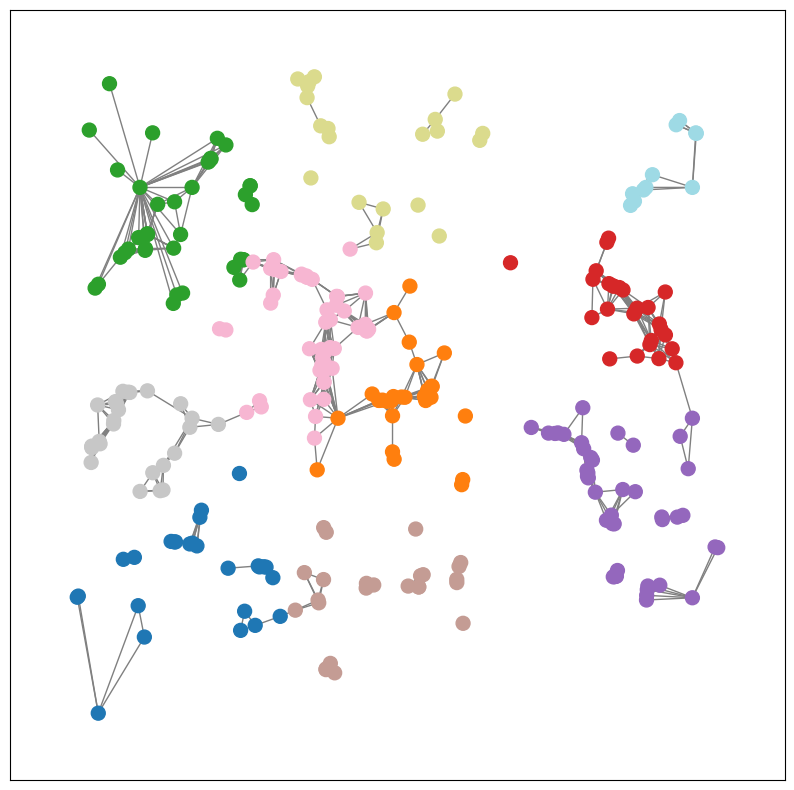

Time:  54
SSE  54  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0]
------------KMeans Baseline Approach---------------
Time:  54 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


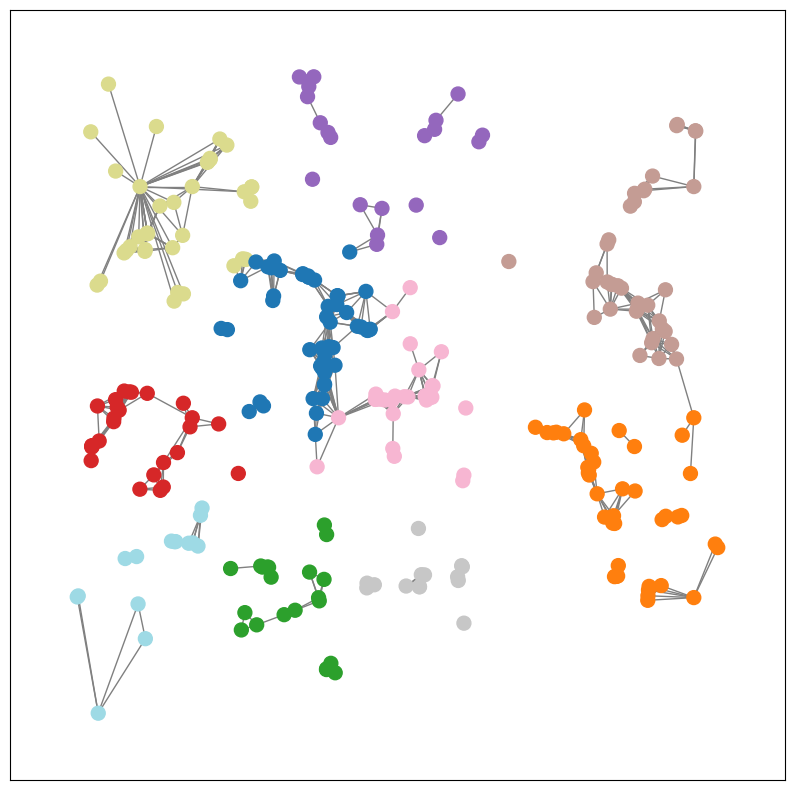

Time:  55
SSE  55  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0]
------------KMeans Baseline Approach---------------
Time:  55 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


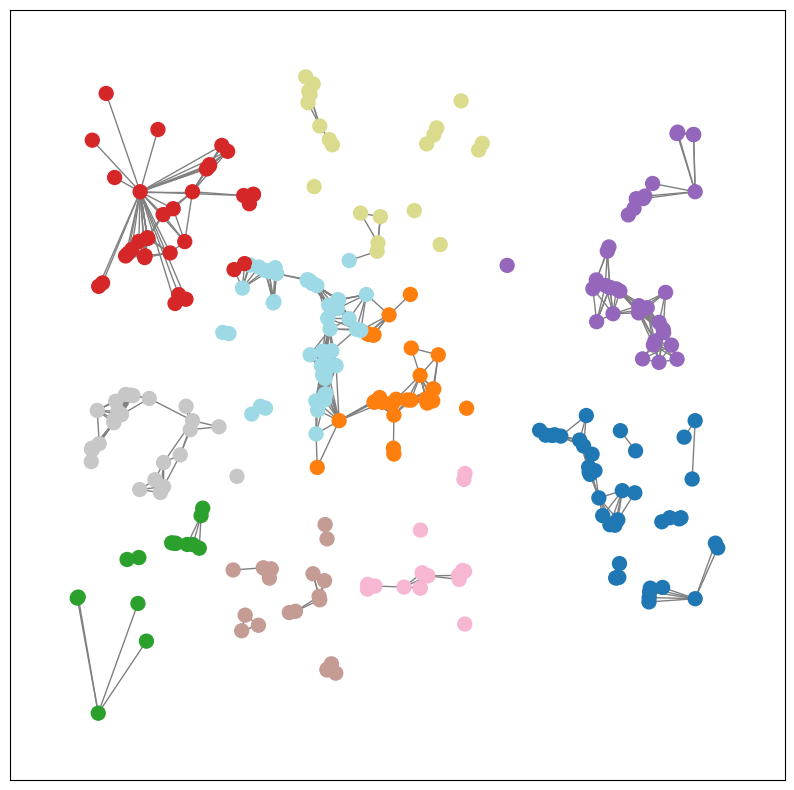

Time:  56
SSE  56  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0]
------------KMeans Baseline Approach---------------
Time:  56 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


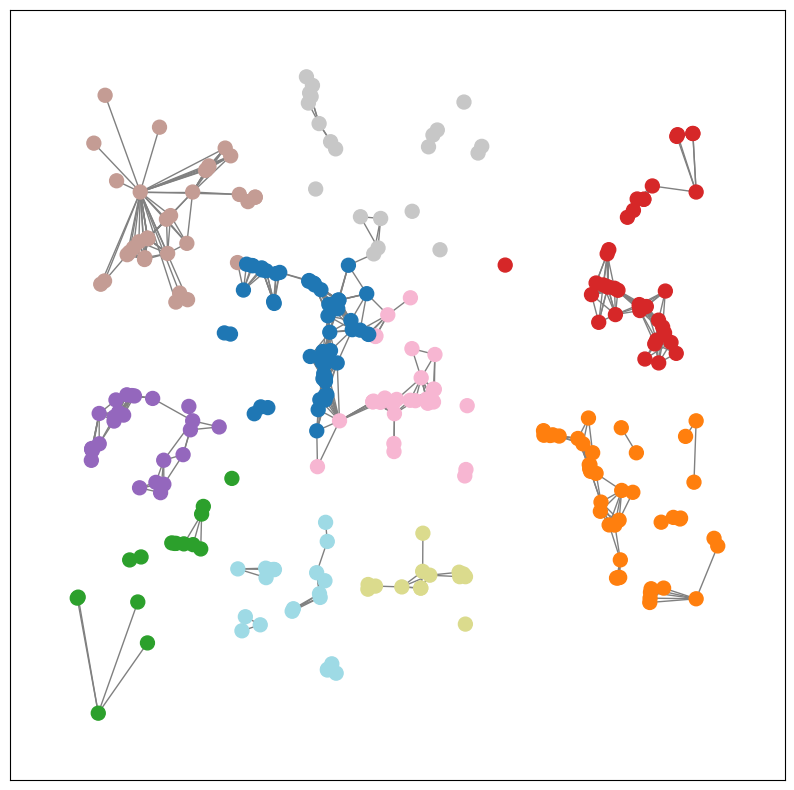

Time:  57
SSE  57  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0]
------------KMeans Baseline Approach---------------
Time:  57 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


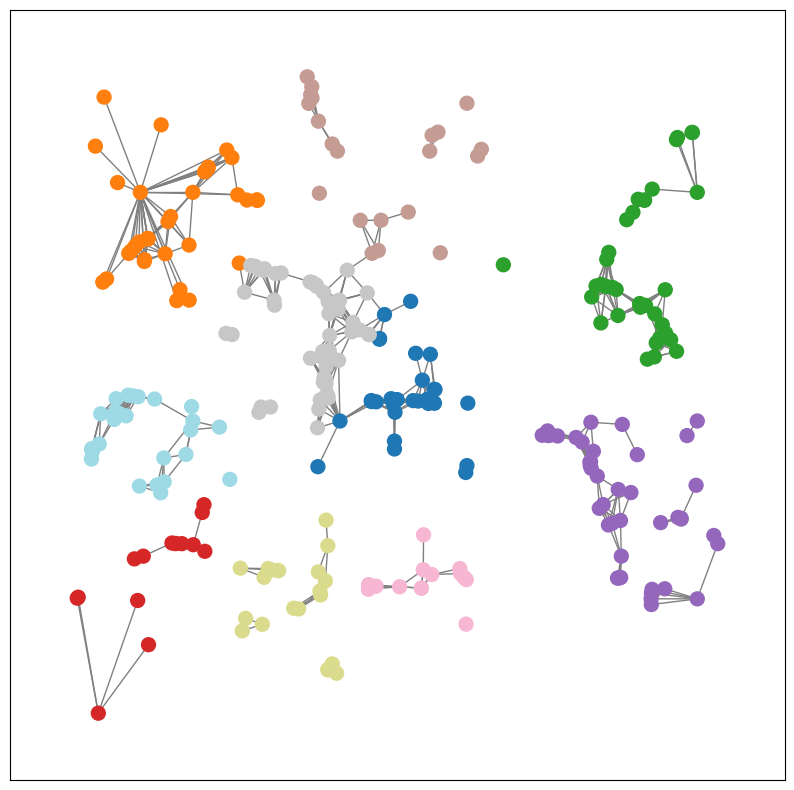

Time:  58
SSE  58  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0]
------------KMeans Baseline Approach---------------
Time:  58 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


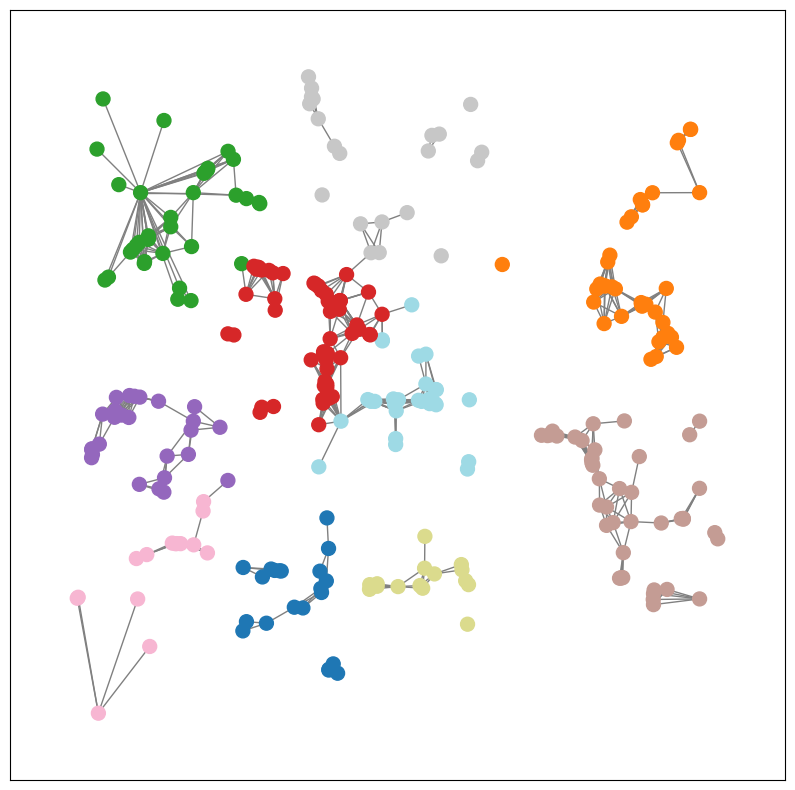

Time:  59
SSE  59  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0]
------------KMeans Baseline Approach---------------
Time:  59 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


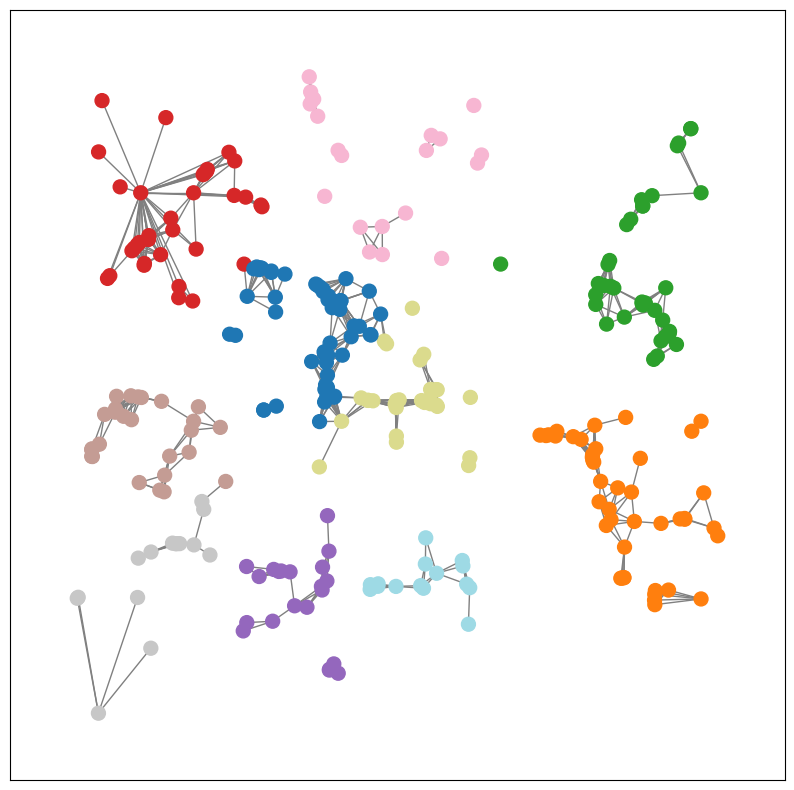

Time:  60
SSE  60  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0]
------------KMeans Baseline Approach---------------
Time:  60 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


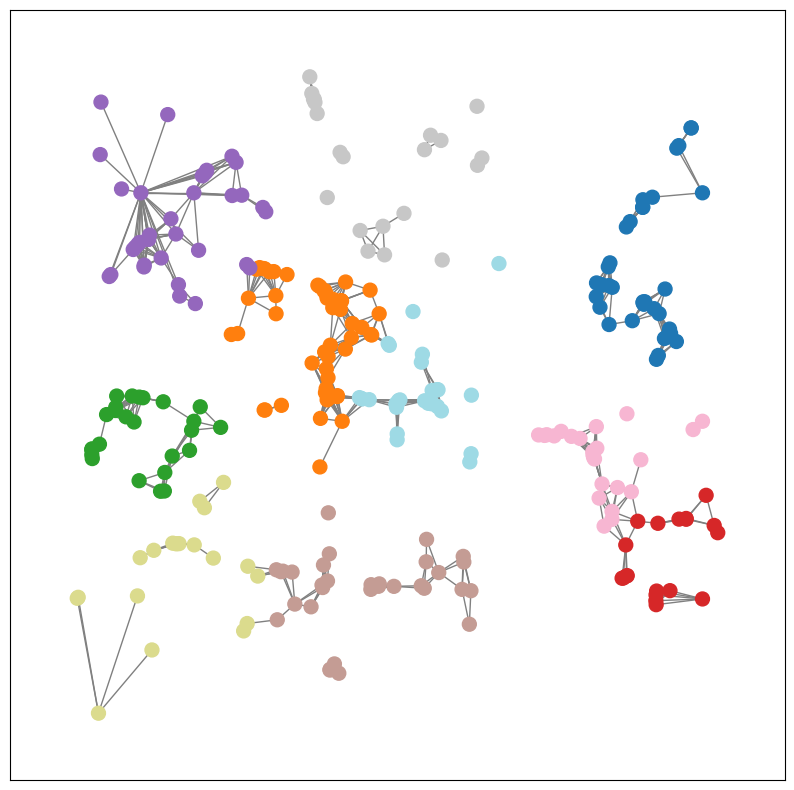

Time:  61
SSE  61  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0]
------------KMeans Baseline Approach---------------
Time:  61 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


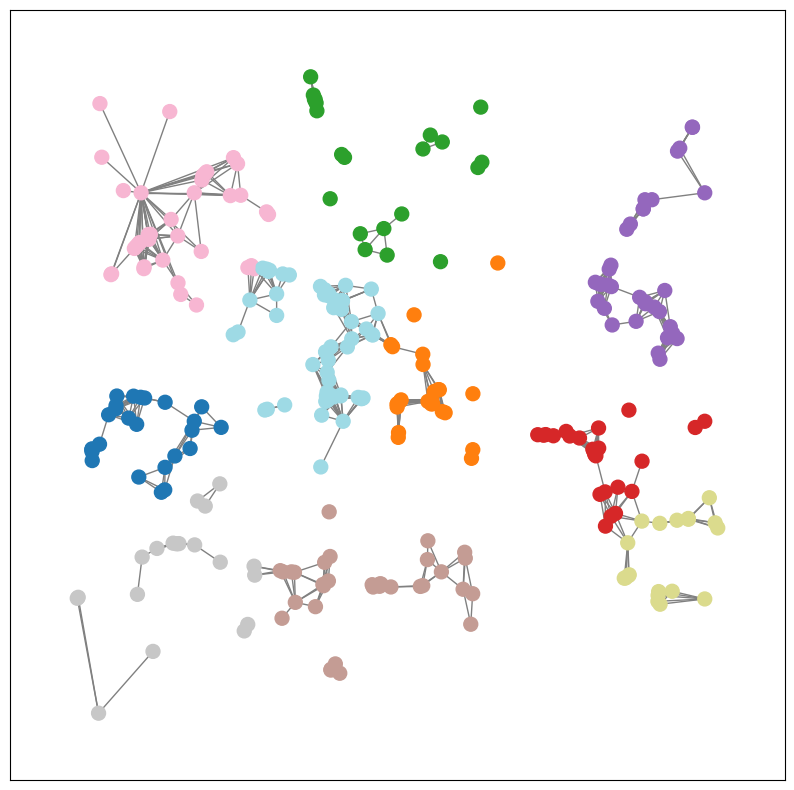

Time:  62
SSE  62  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0]
------------KMeans Baseline Approach---------------
Time:  62 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


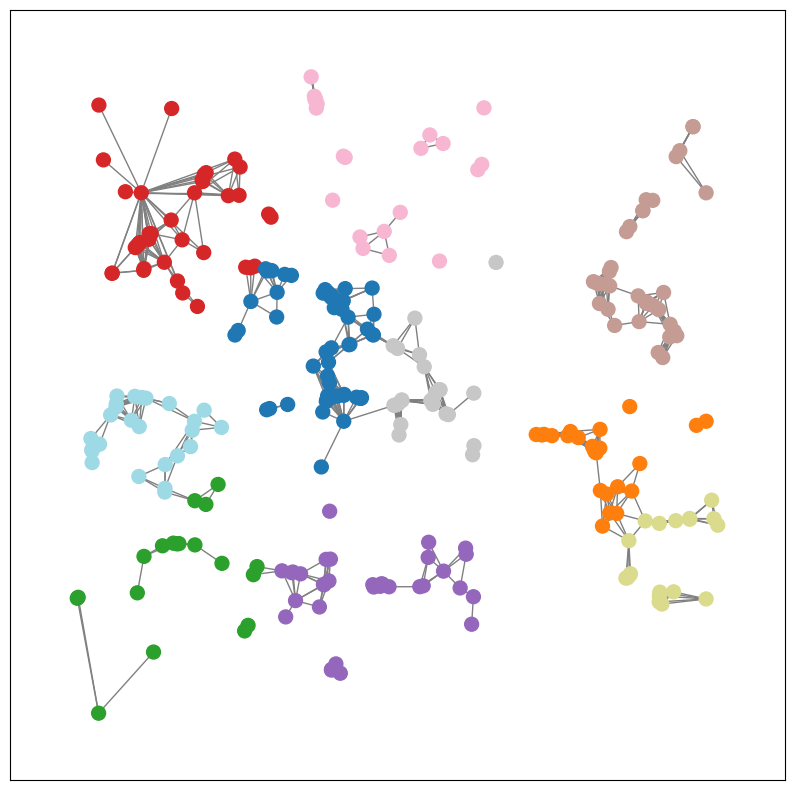

Time:  63
SSE  63  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0]
------------KMeans Baseline Approach---------------
Time:  63 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


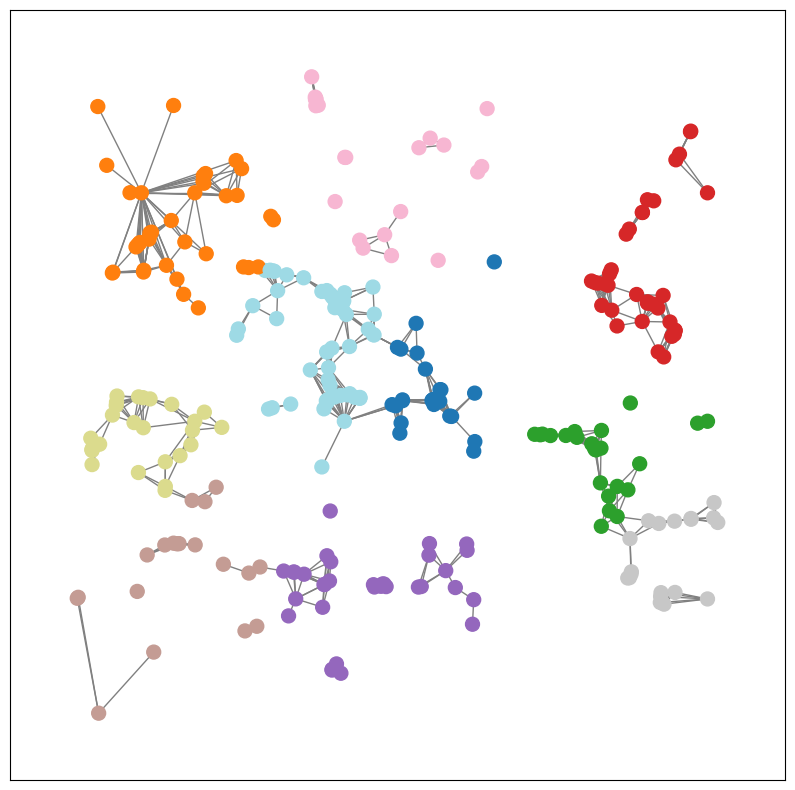

Time:  64
SSE  64  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0]
------------KMeans Baseline Approach---------------
Time:  64 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


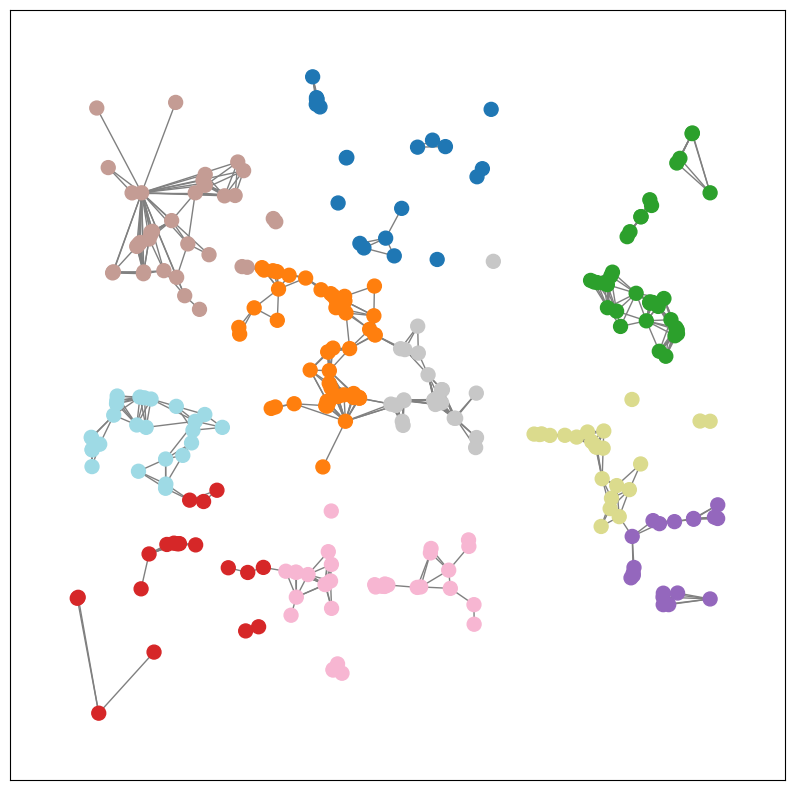

Time:  65
SSE  65  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0]
------------KMeans Baseline Approach---------------
Time:  65 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


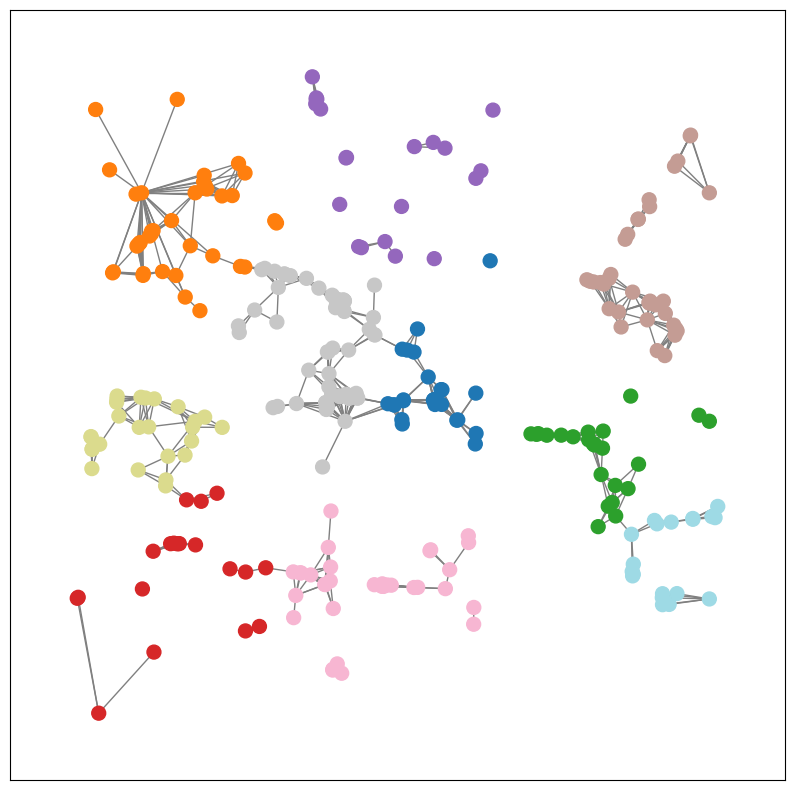

Time:  66
SSE  66  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0]
------------KMeans Baseline Approach---------------
Time:  66 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


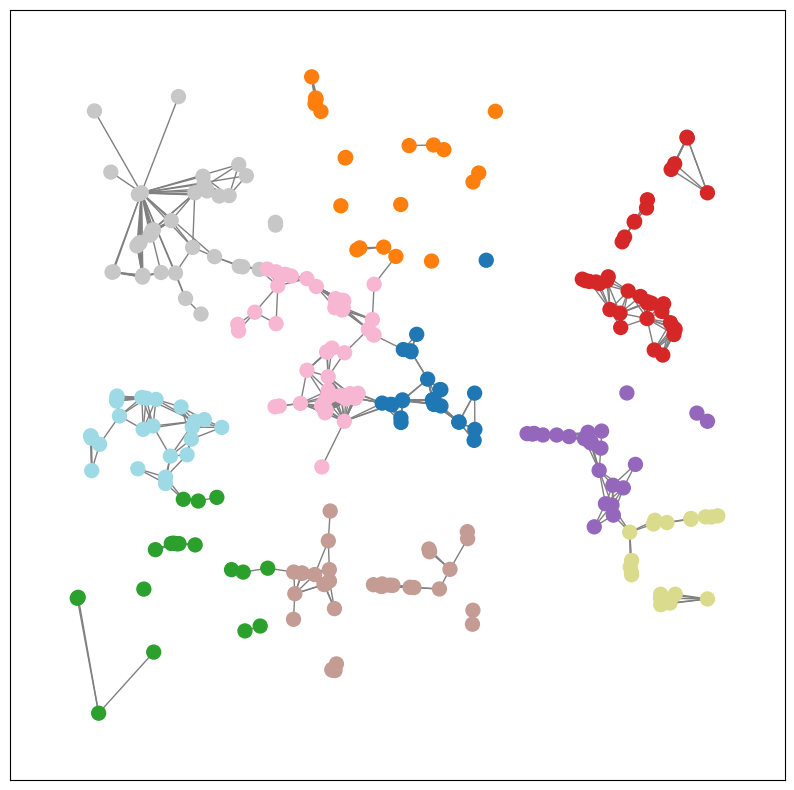

Time:  67
SSE  67  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0]
------------KMeans Baseline Approach---------------
Time:  67 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


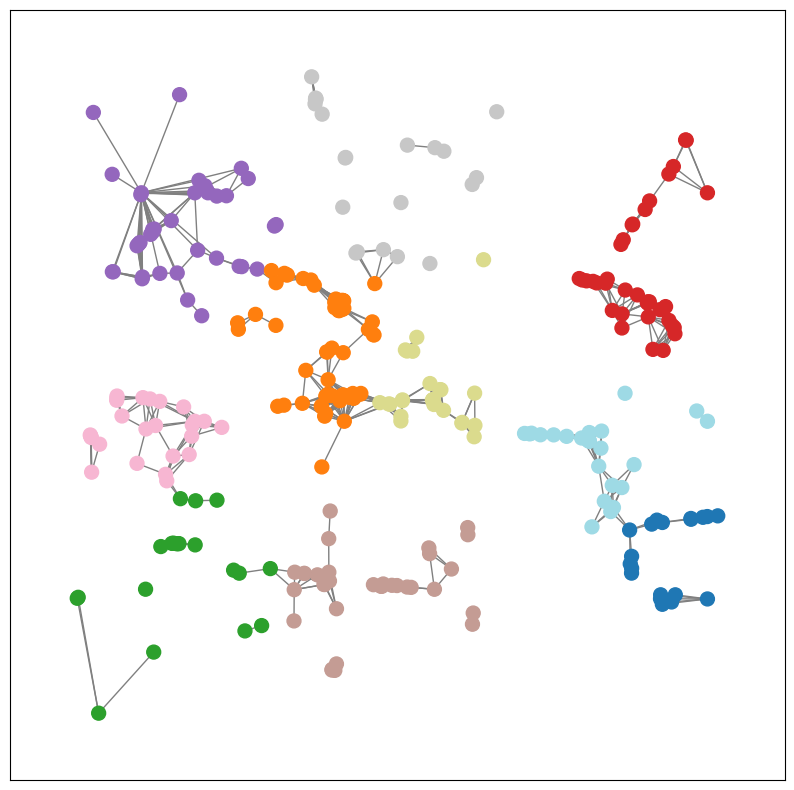

Time:  68
SSE  68  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0]
------------KMeans Baseline Approach---------------
Time:  68 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


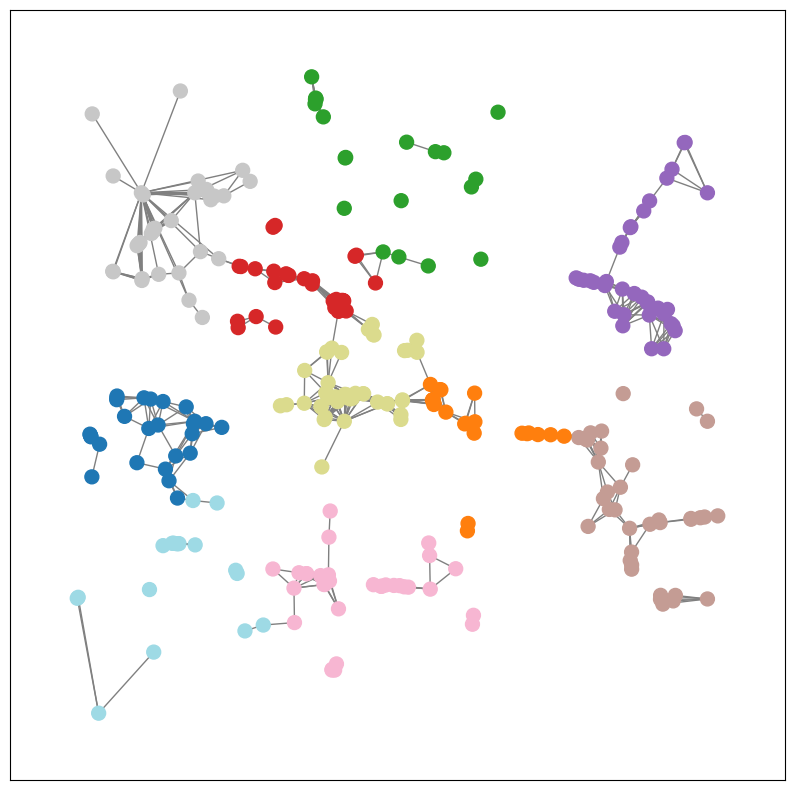

Time:  69
SSE  69  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0]
------------KMeans Baseline Approach---------------
Time:  69 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


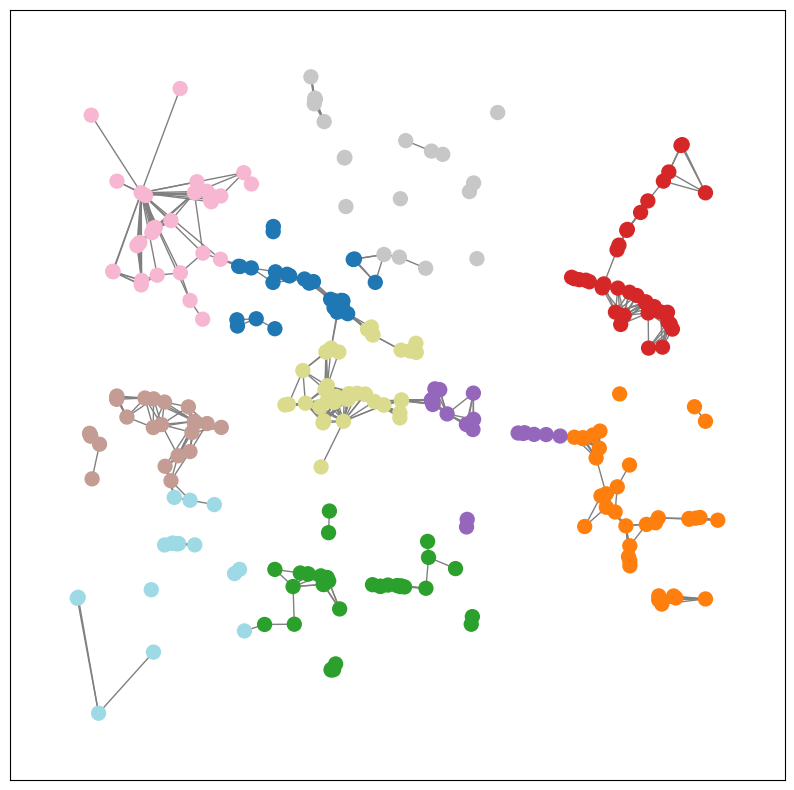

Time:  70
SSE  70  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0]
------------KMeans Baseline Approach---------------
Time:  70 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


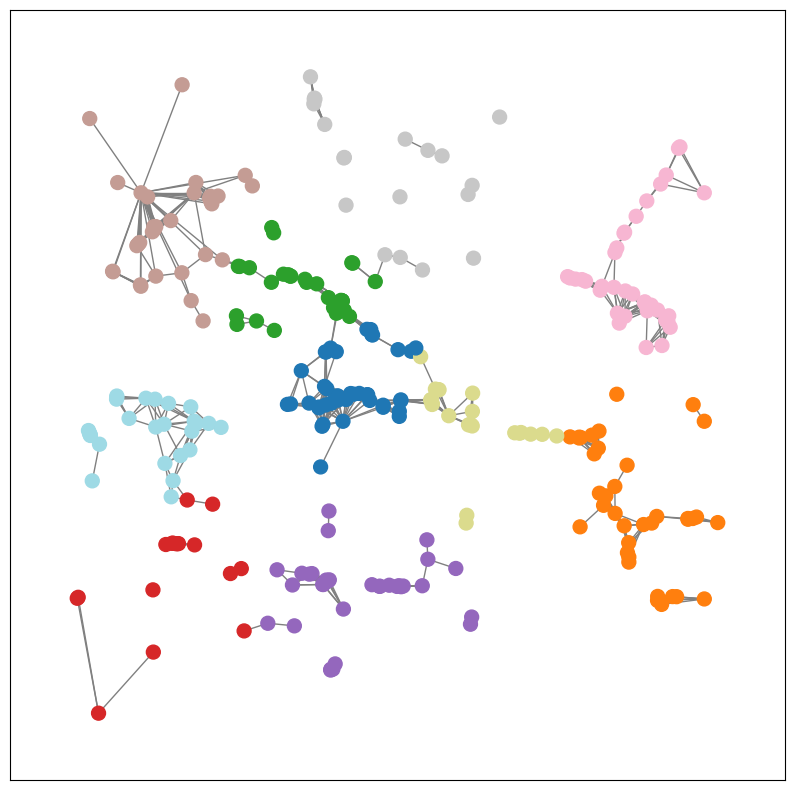

Time:  71
SSE  71  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0]
------------KMeans Baseline Approach---------------
Time:  71 ---------------------------------Number Clusters:  10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


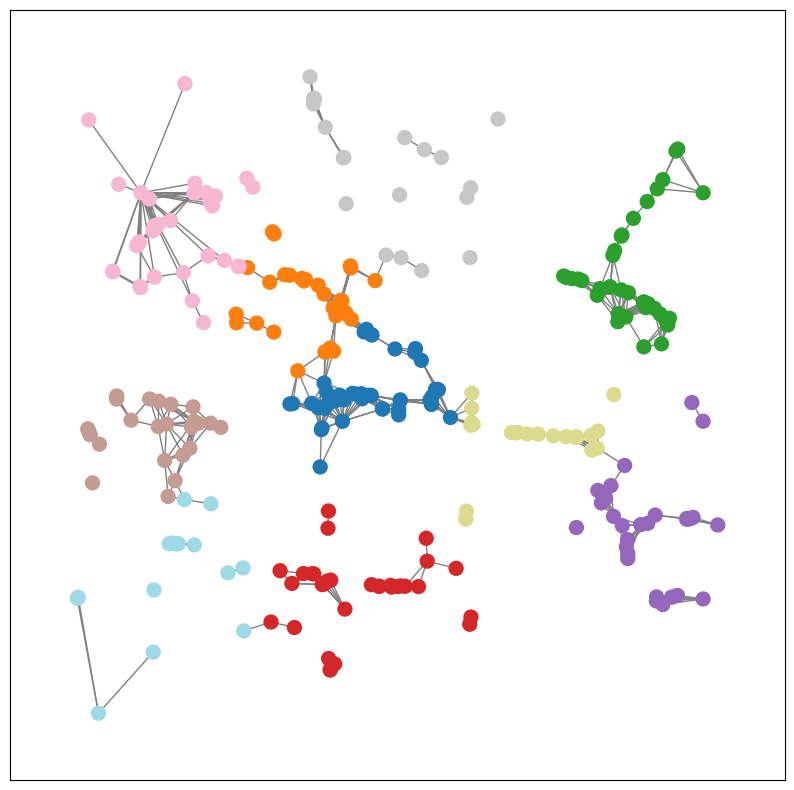

Time:  72
SSE  72  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0]
------------KMeans Baseline Approach---------------
Time:  72 ---------------------------------Number Clusters

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


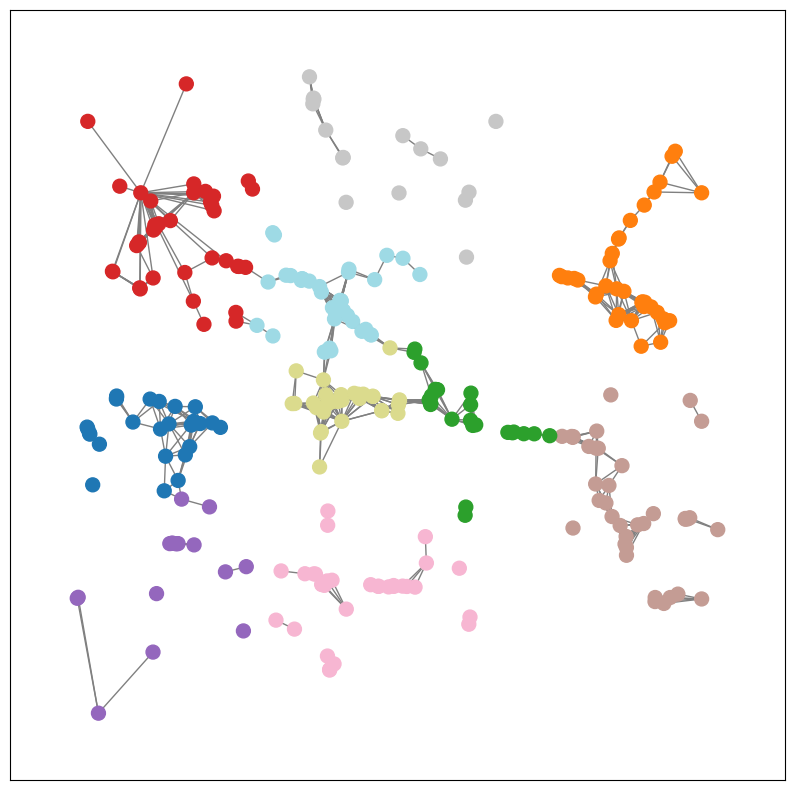

Time:  73
SSE  73  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0]
------------KMeans Baseline Approach---------------
Time:  73 ---------------------------------Num

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


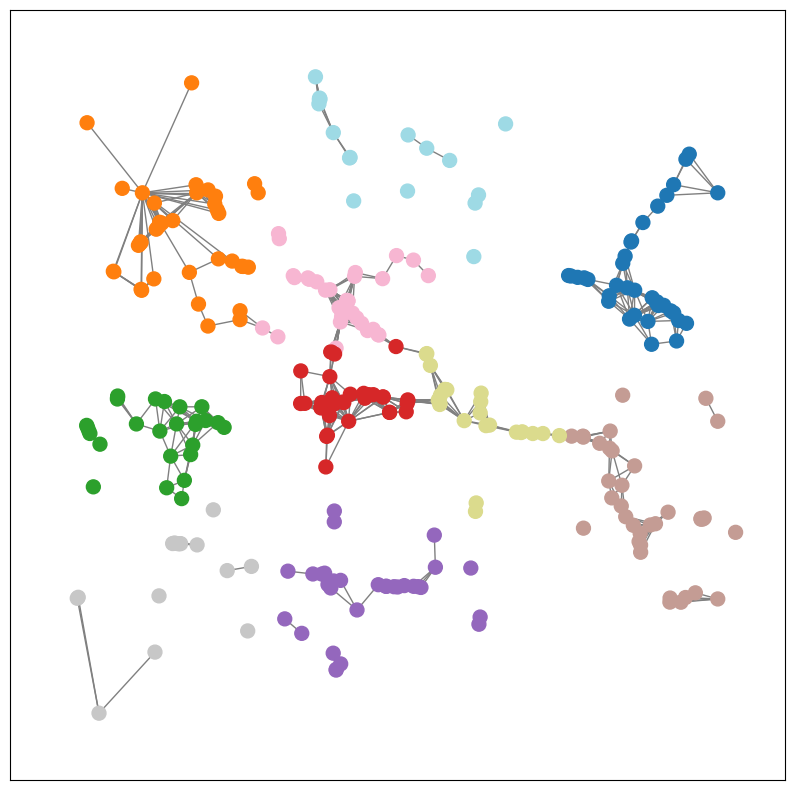

Time:  74
SSE  74  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0]
------------KMeans Baseline Approach---------------
Time:  74 ------------------------

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


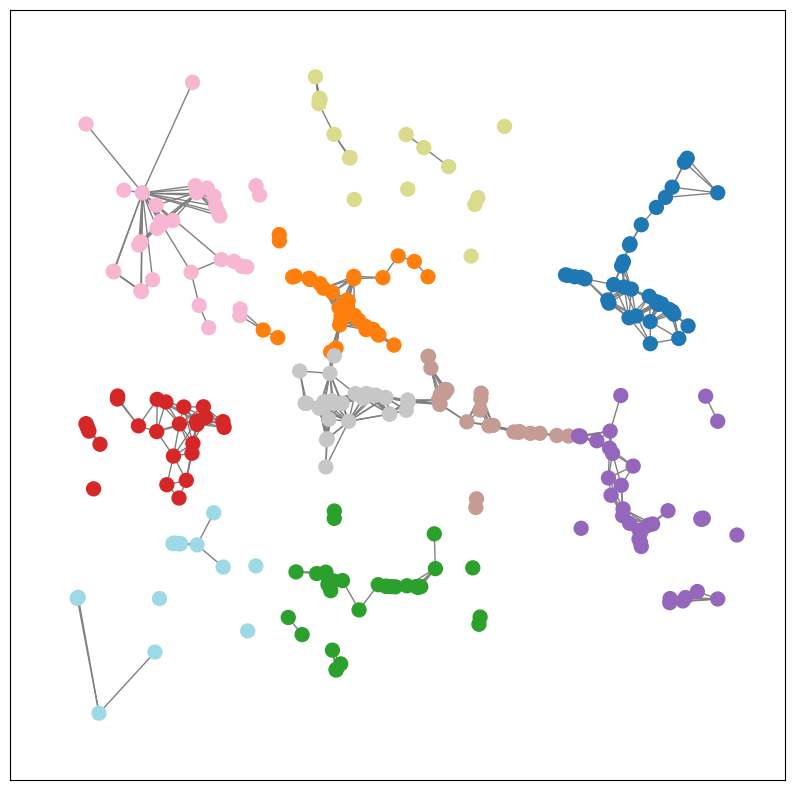

Time:  75
SSE  75  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0]
------------KMeans Baseline Approach---------------
Time:  75 ------------

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


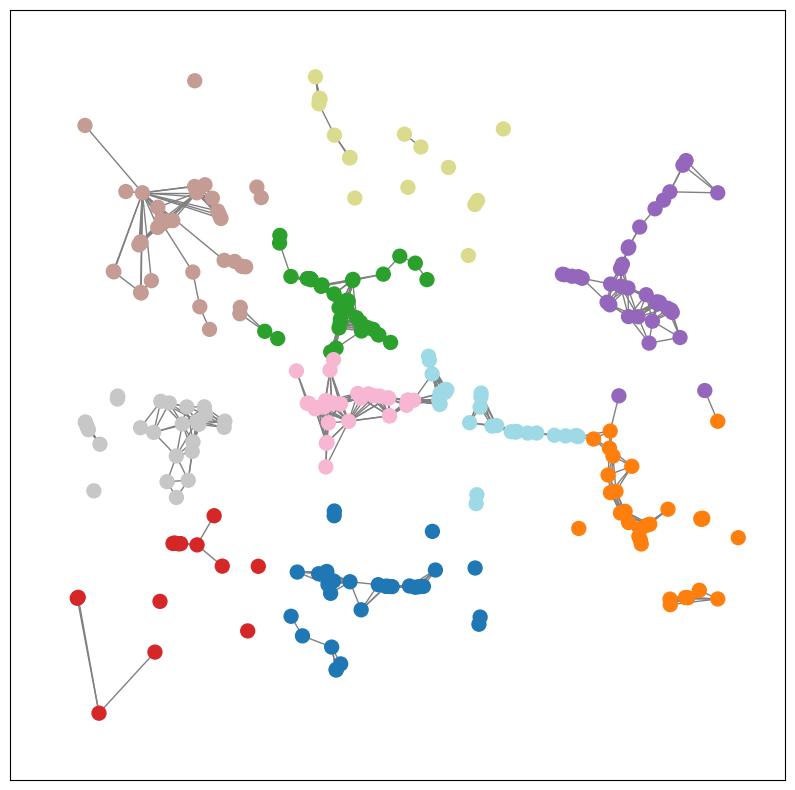

Time:  76
SSE  76  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0]
------------KMeans Baseline Approach---------------
Time:  76 

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


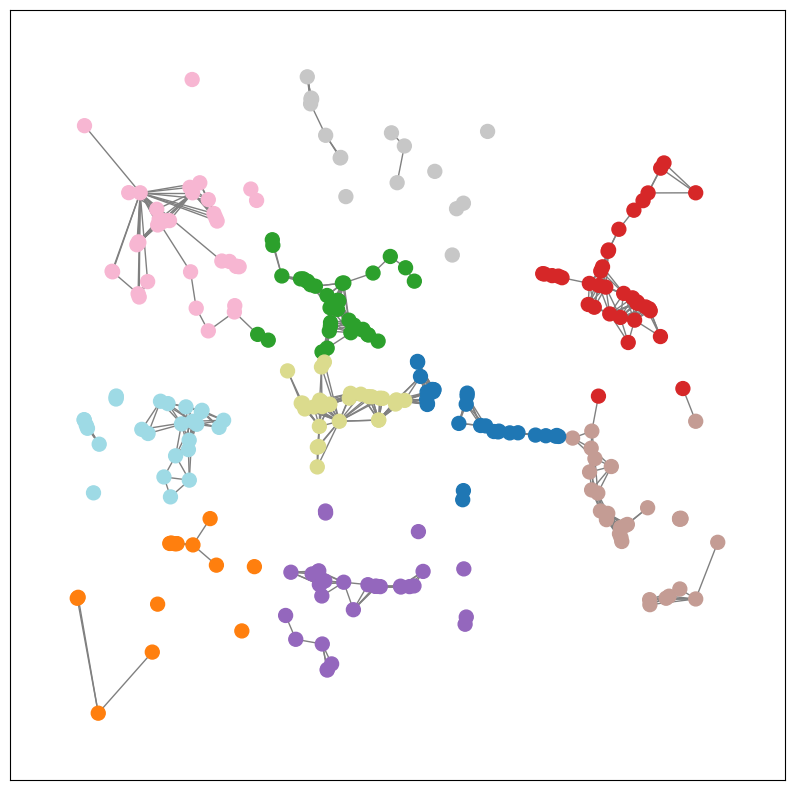

Time:  77
SSE  77  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0]
------------KMeans Baseline Approach--------------

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


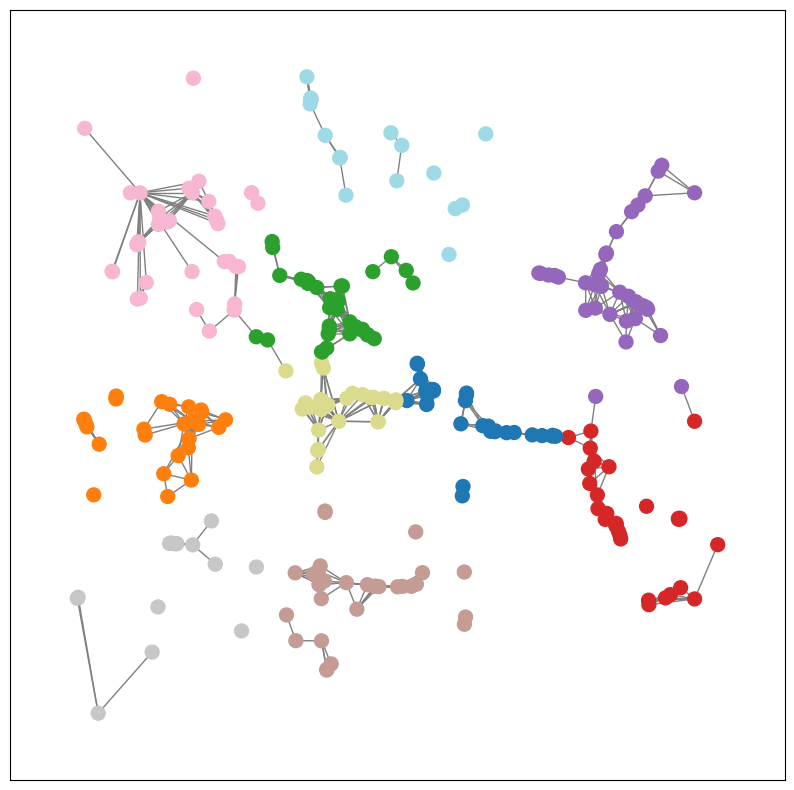

Time:  78
SSE  78  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0]
------------KMeans Baseline Approach--

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


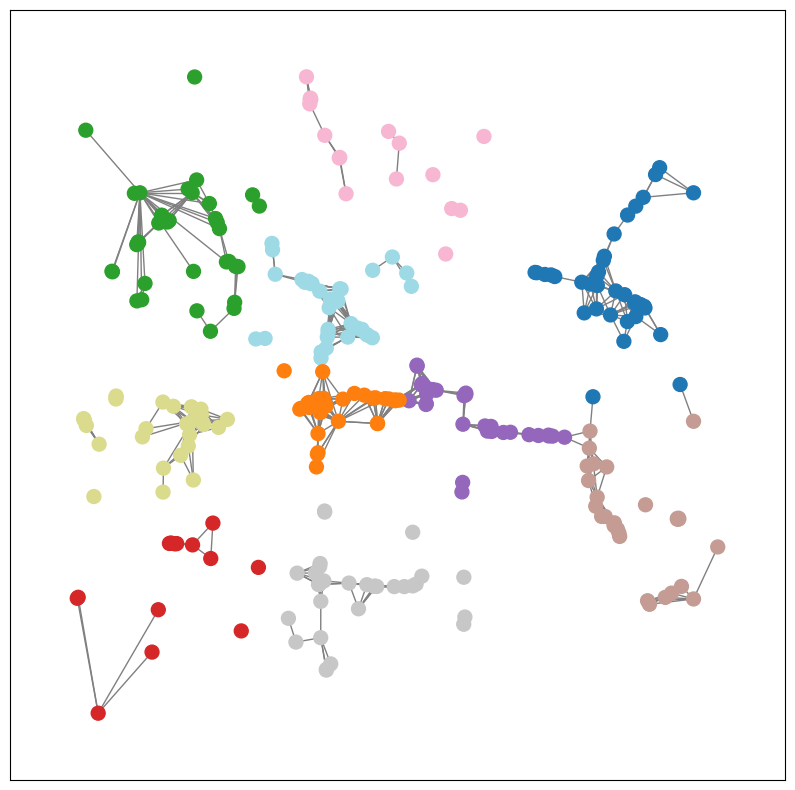

Time:  79
SSE  79  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0]
------------KMeans Baselin

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


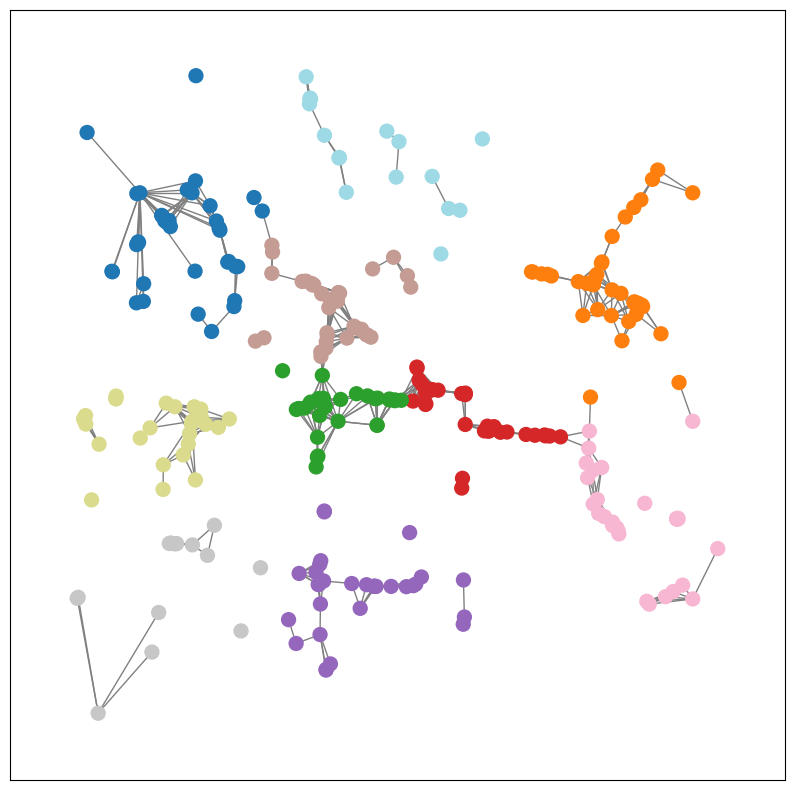

Time:  80
SSE  80  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0]
------------KM

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


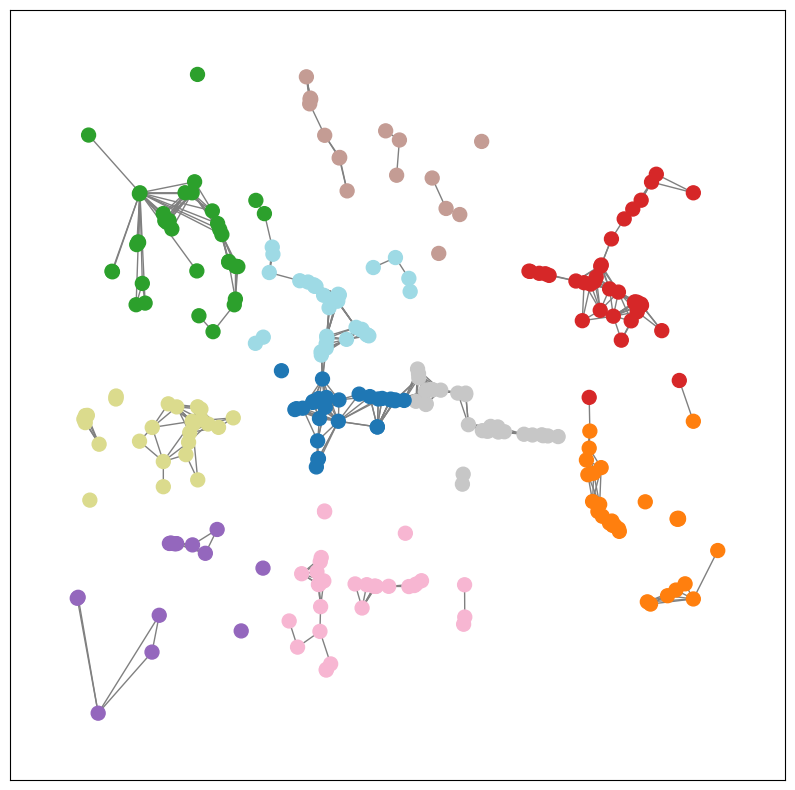

Time:  81
SSE  81  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0]
--

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


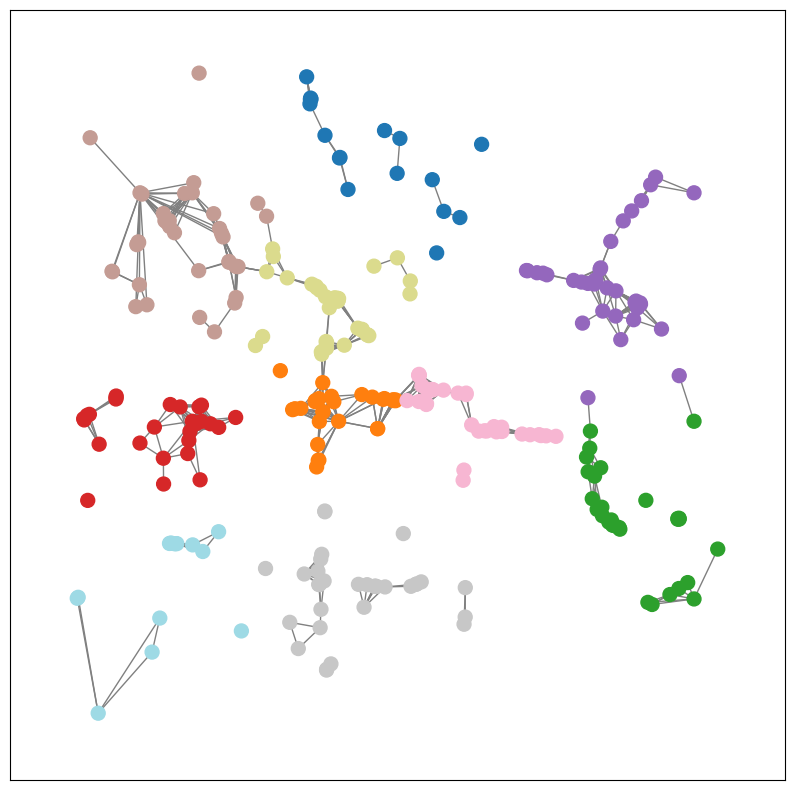

Time:  82
SSE  82  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


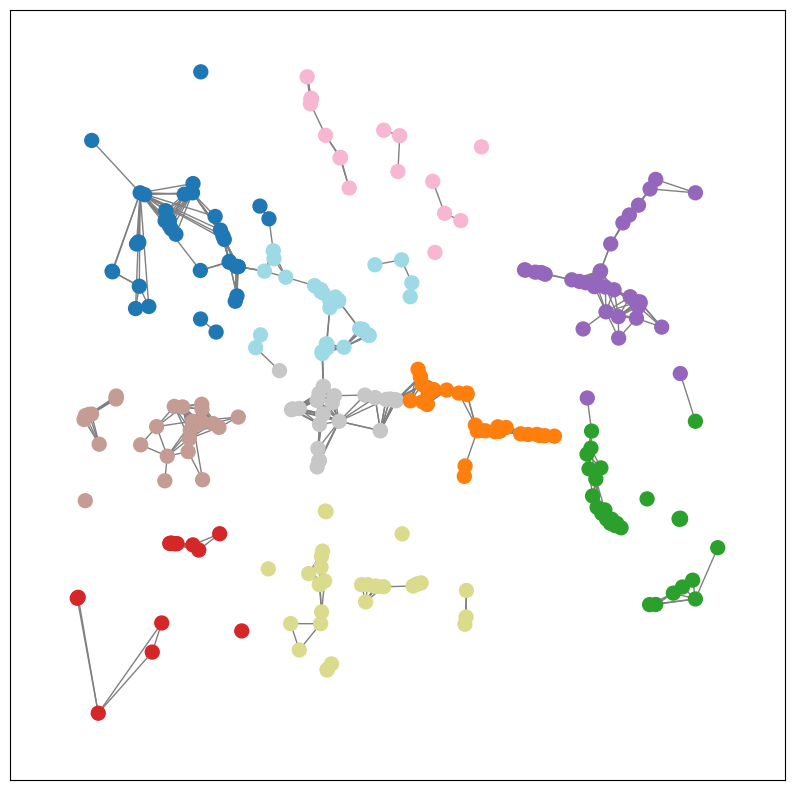

Time:  83
SSE  83  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


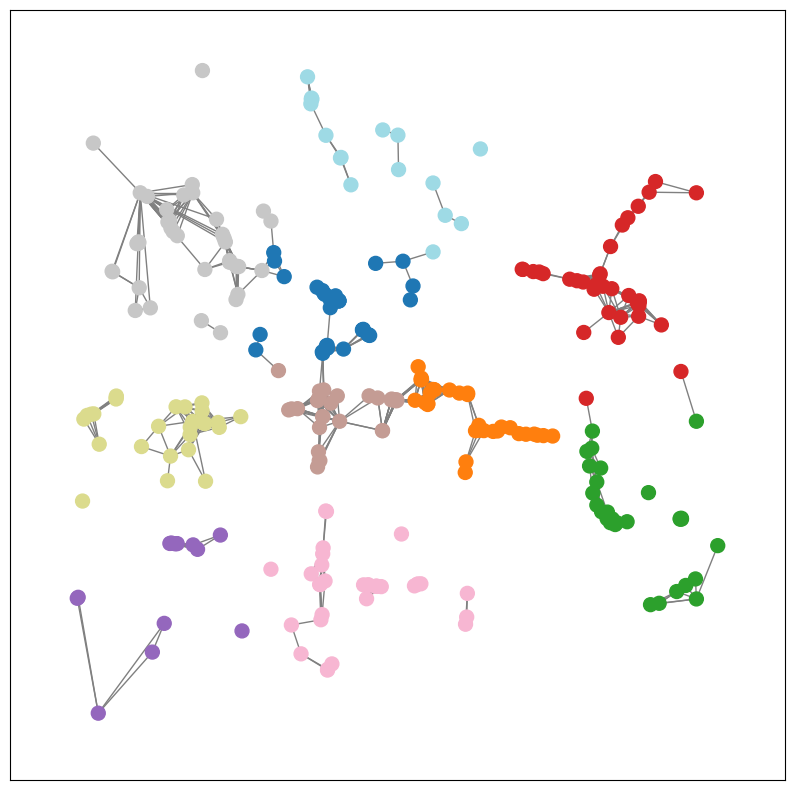

Time:  84
SSE  84  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


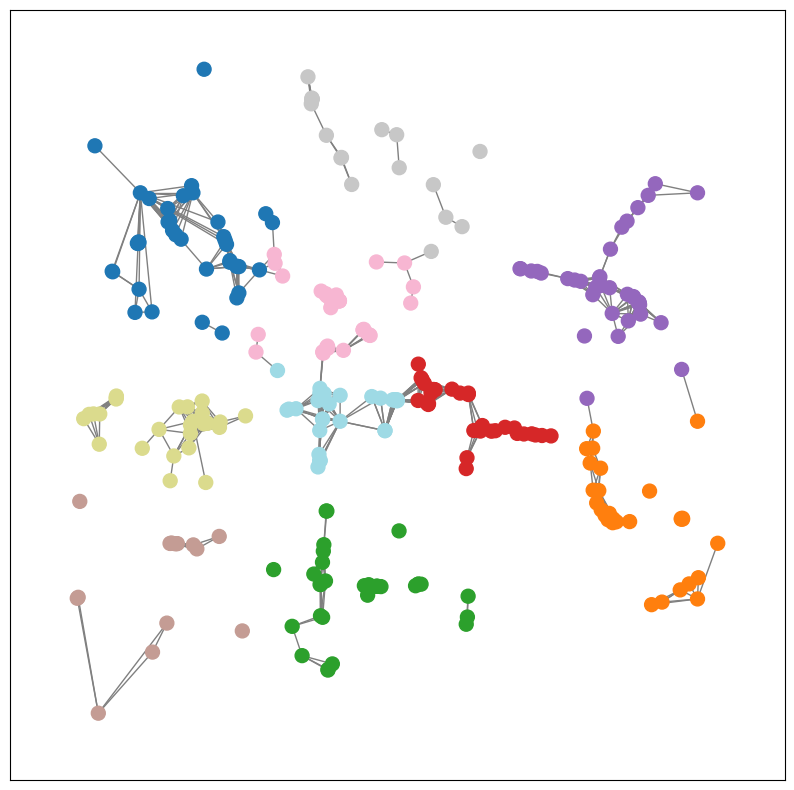

Time:  85
SSE  85  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


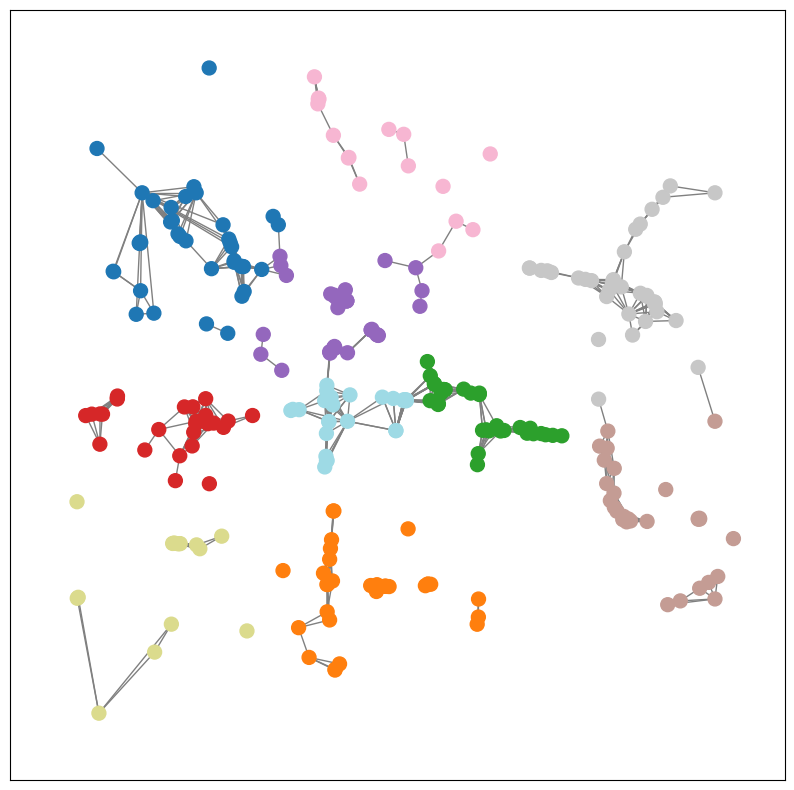

Time:  86
SSE  86  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


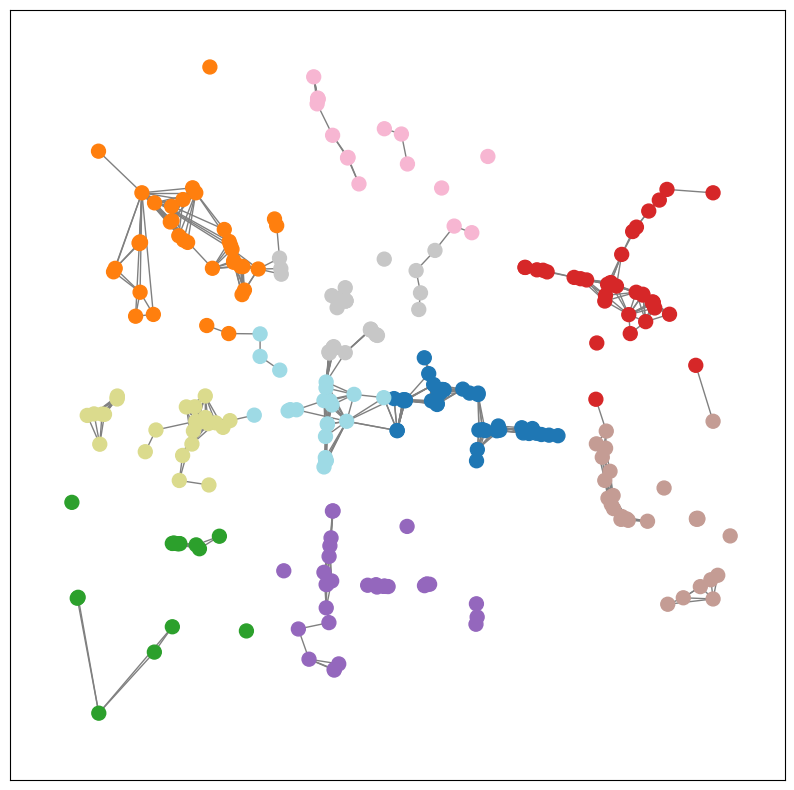

Time:  87
SSE  87  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


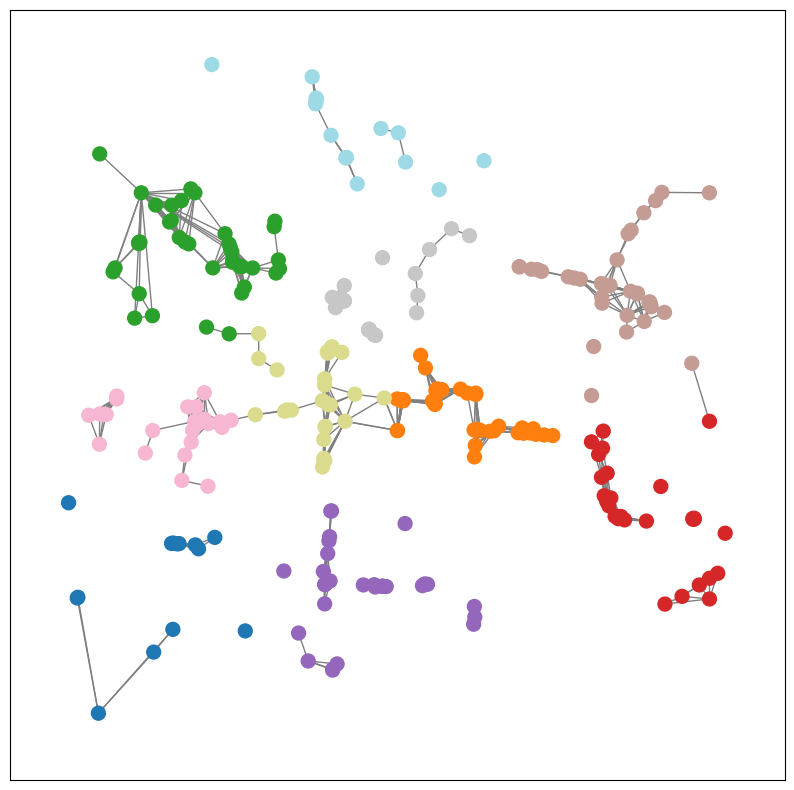

Time:  88
SSE  88  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


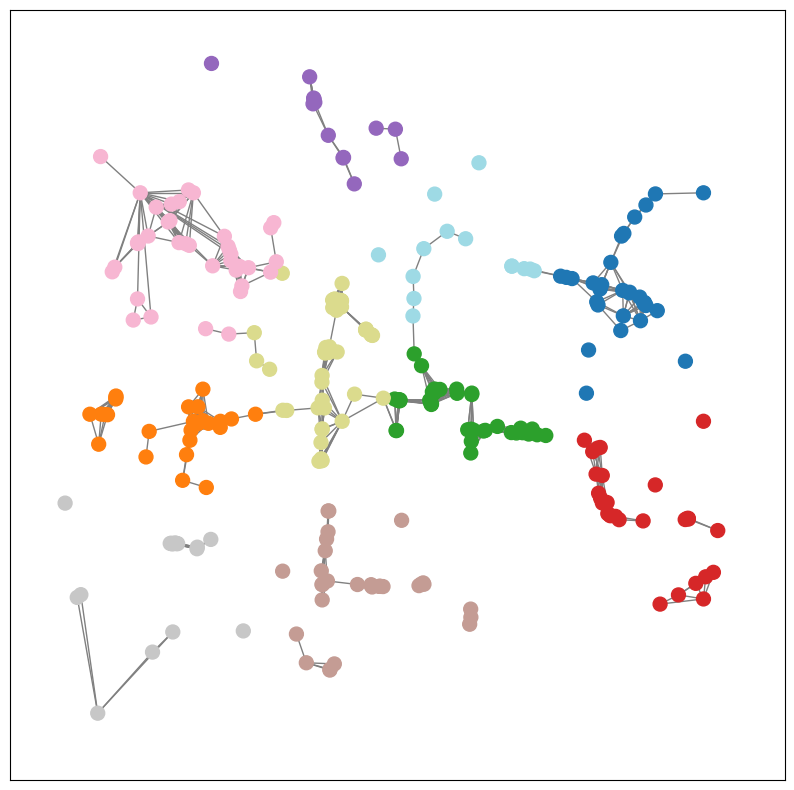

Time:  89
SSE  89  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


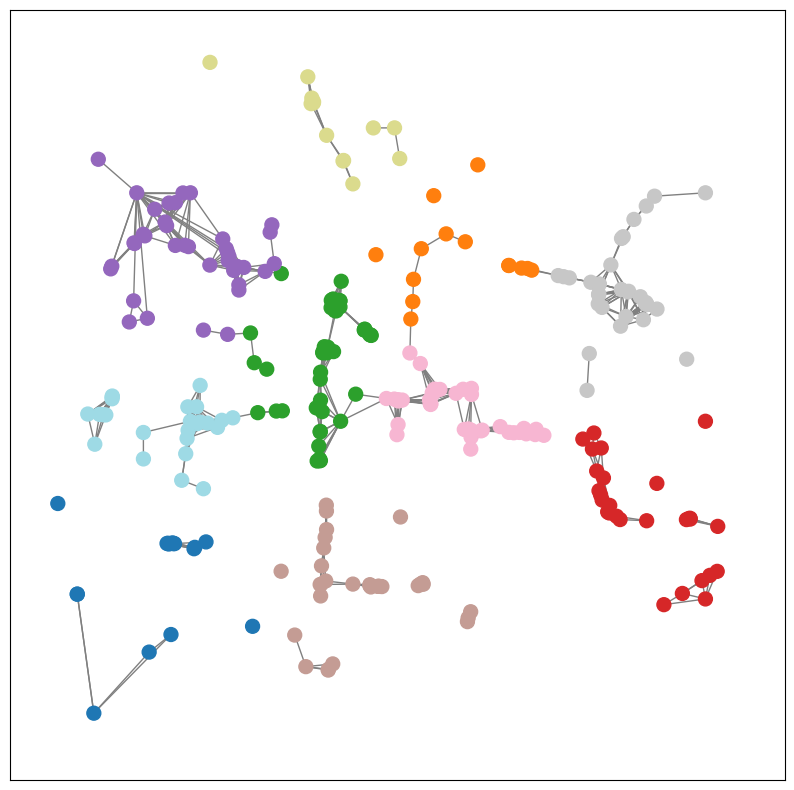

Time:  90
SSE  90  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


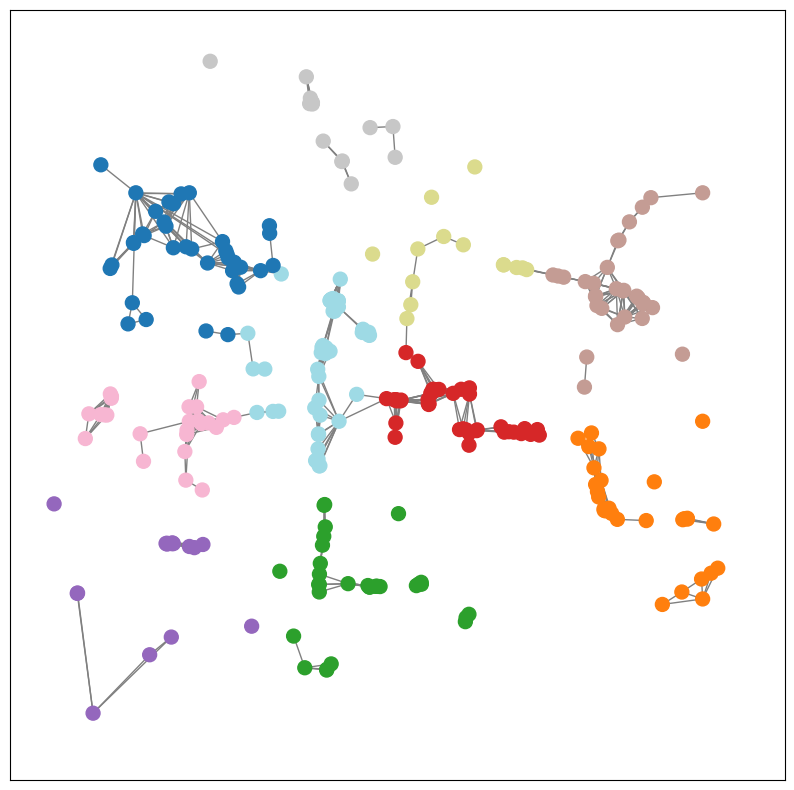

Time:  91
SSE  91  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


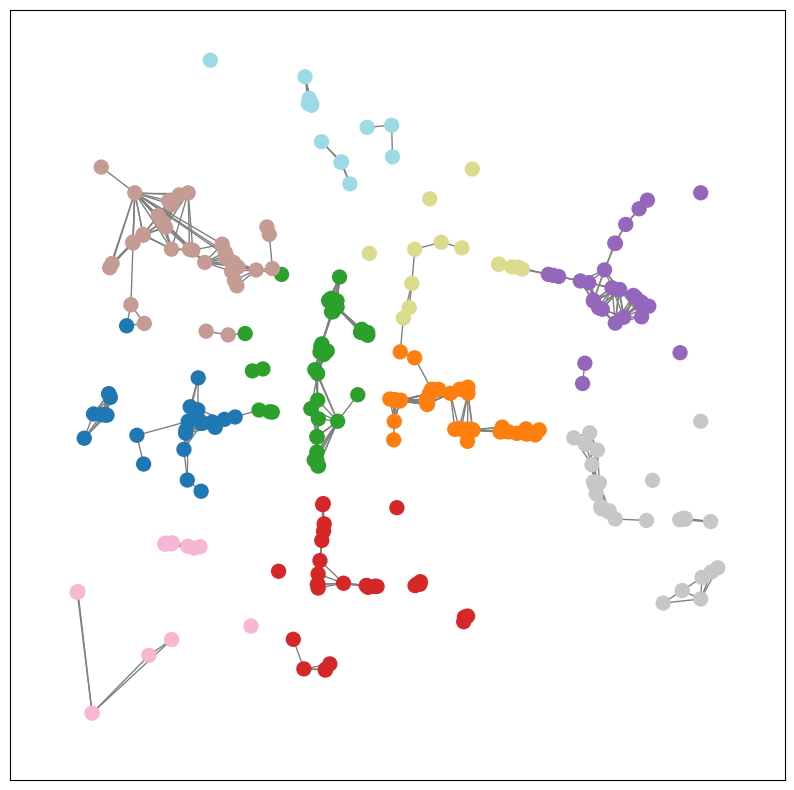

Time:  92
SSE  92  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


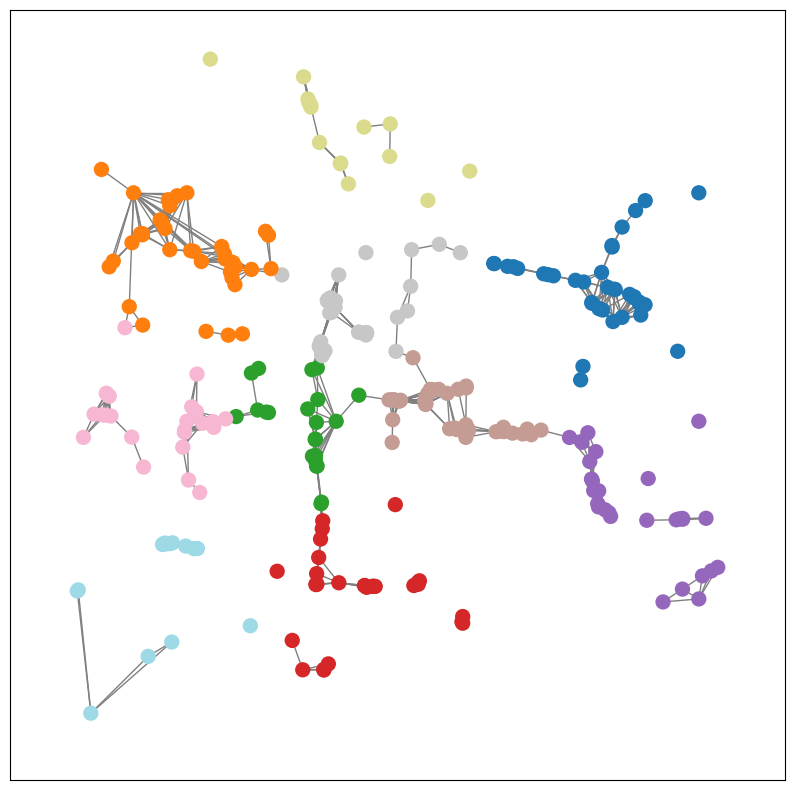

Time:  93
SSE  93  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


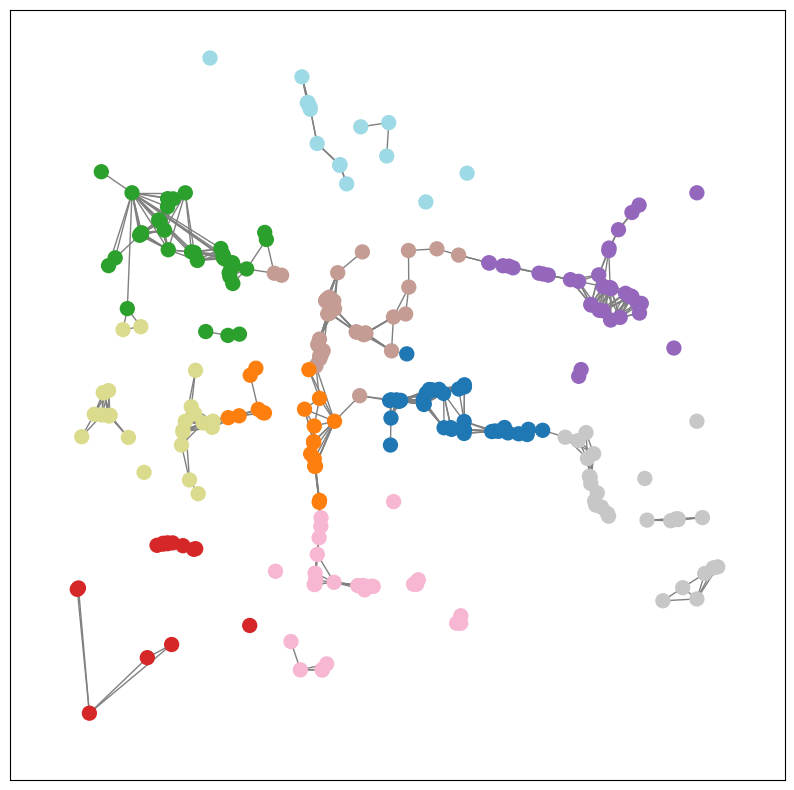

Time:  94
SSE  94  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


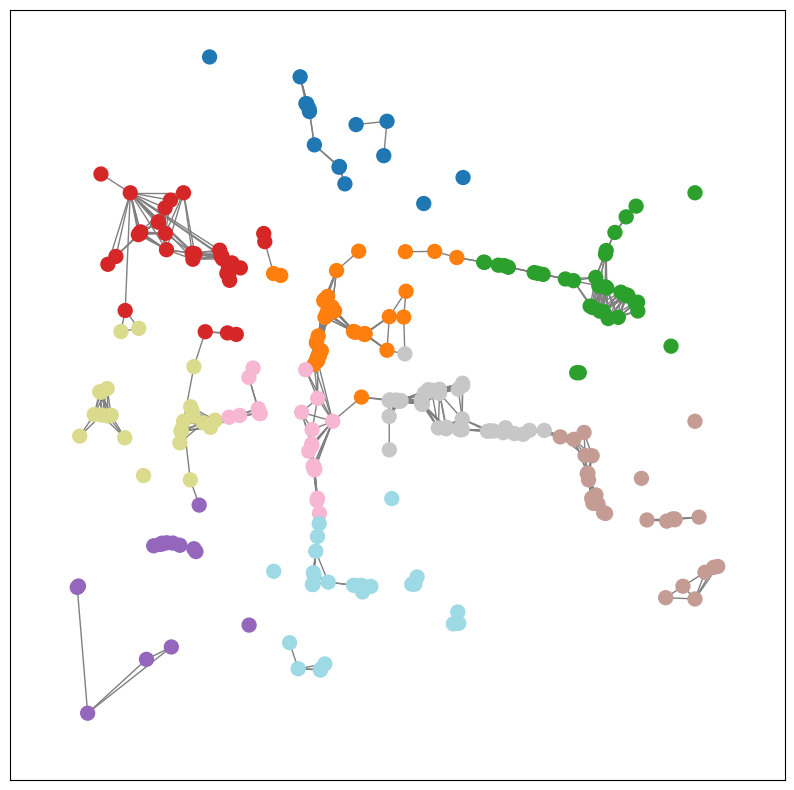

Time:  95
SSE  95  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


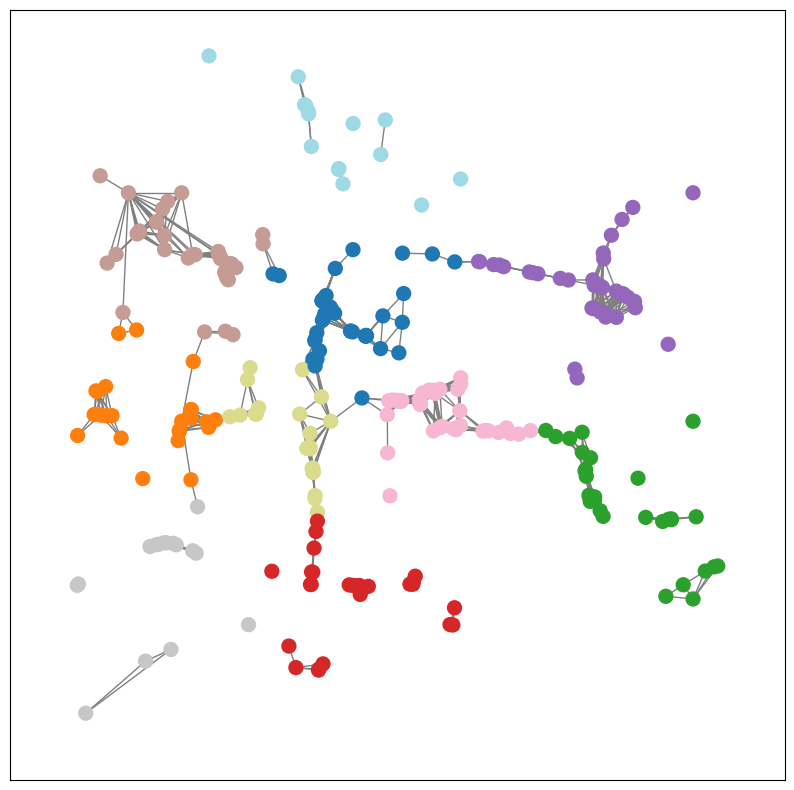

Time:  96
SSE  96  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


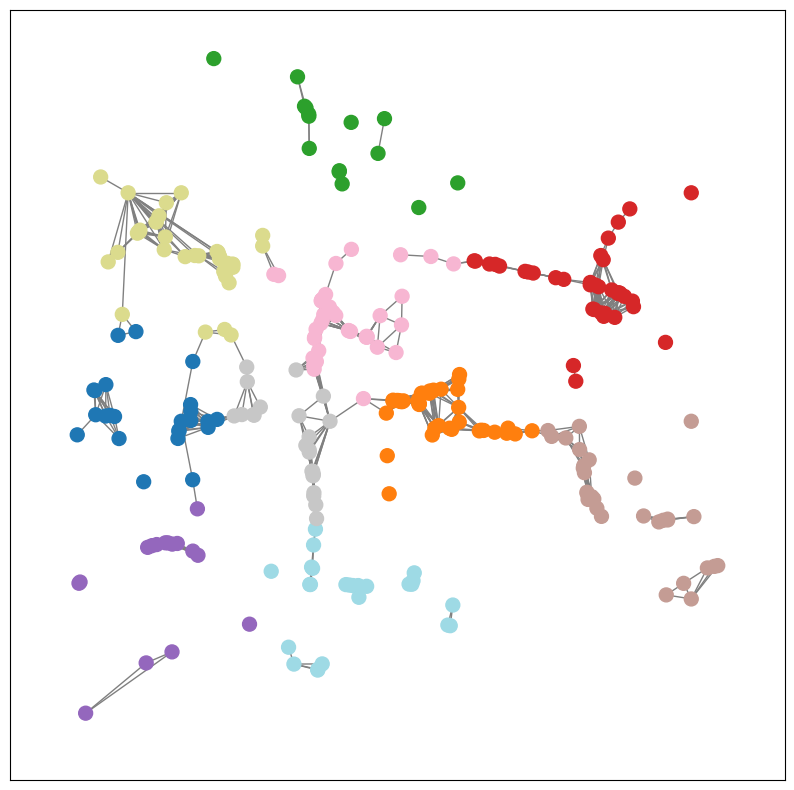

Time:  97
SSE  97  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


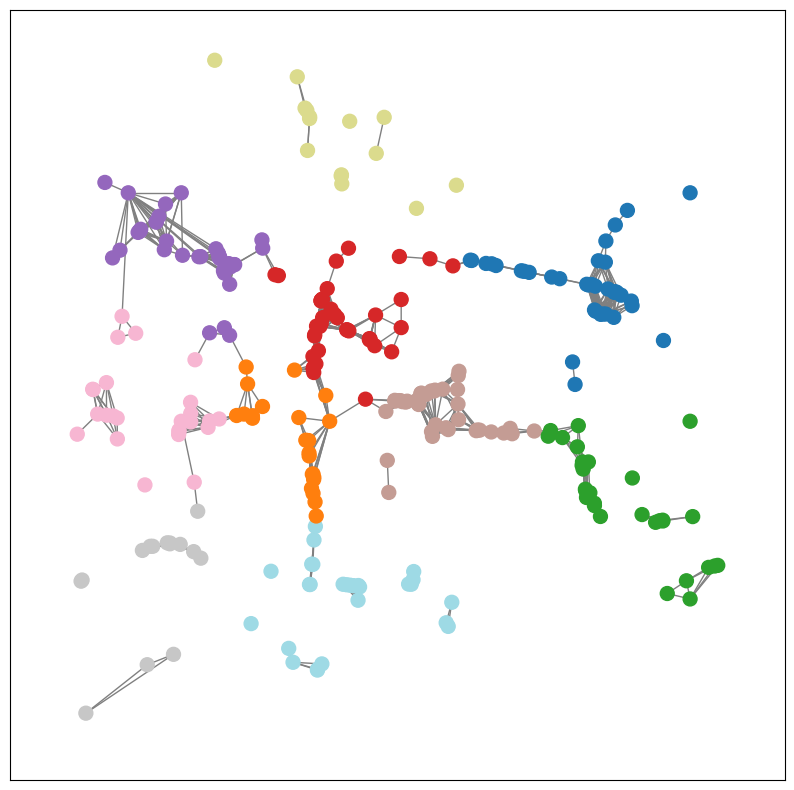

Time:  98
SSE  98  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


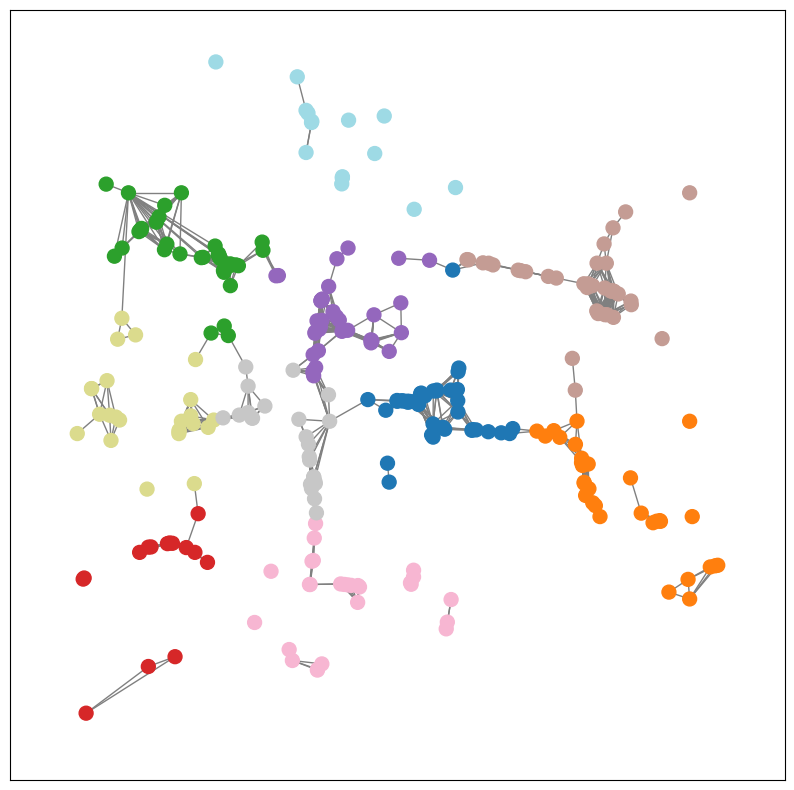

Time:  99
SSE  99  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 20

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


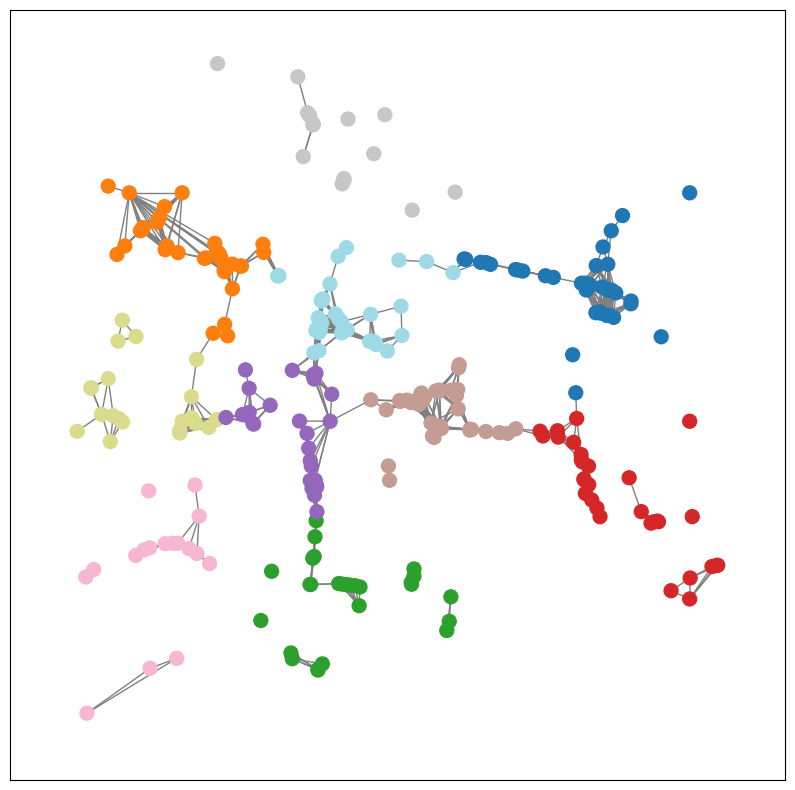

Time:  100
SSE  100  FULL  [30760446.0, 30716288.0, 30664816.0, 30622044.0, 30499086.0, 30351184.0, 30136688.0, 29891244.0, 29685230.0, 29567480.0, 29343630.0, 29181782.0, 29065308.0, 29001396.0, 29023080.0, 28825652.0, 28751850.0, 28574840.0, 28478700.0, 28348764.0, 28173060.0, 28103926.0, 27946270.0, 27862500.0, 27830210.0, 27686052.0, 27536694.0, 27330580.0, 27164010.0, 26905780.0, 26666164.0, 26504050.0, 26423152.0, 26340564.0, 26244936.0, 26030540.0, 25961056.0, 25886218.0, 25816780.0, 25740952.0, 25746424.0, 25573794.0, 25538636.0, 25395778.0, 25132486.0, 24837320.0, 24673234.0, 24569164.0, 24514218.0, 24424756.0, 24361936.0, 24155030.0, 24041702.0, 23880542.0, 23723082.0, 23523336.0, 23287276.0, 23143758.0, 23059848.0, 23000534.0, 22830020.0, 22548656.0, 22279064.0, 22064608.0, 21880222.0, 21804282.0, 21665950.0, 21584254.0, 21392204.0, 21273196.0, 21083780.0, 20874384.0, 20653910.0, 20563902.0, 20400136.0, 20252456.0, 20206068.0, 20161958.0, 20124970.0, 20083912.0, 20091612.0, 

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


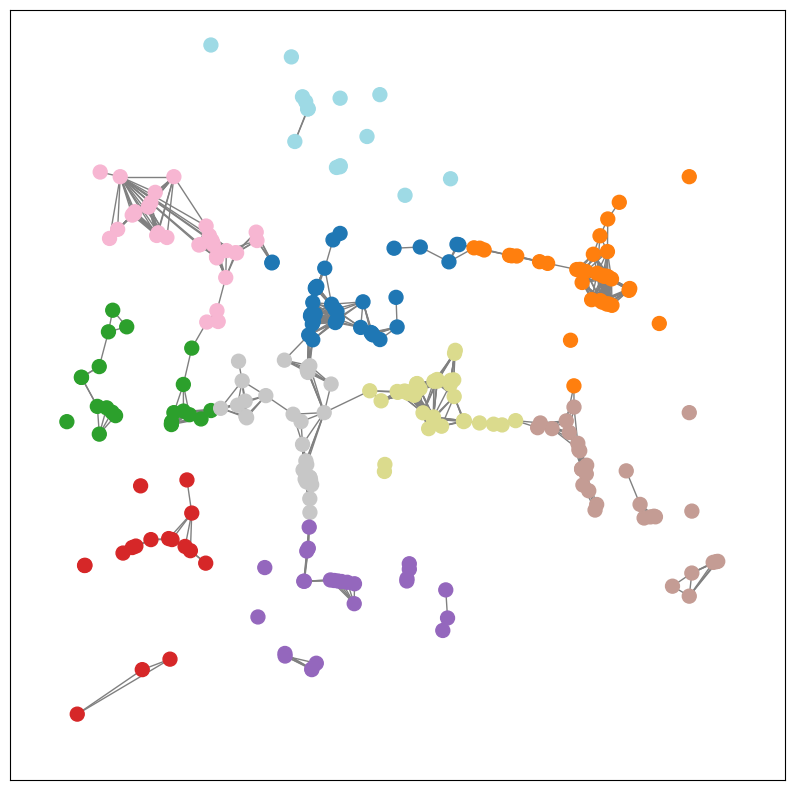

In [21]:
# Call the method and iterate through each graph
for t in range(0, len(gnn_datas)):
    visualize_node_clusters(gnn_datas, num_clusters, t)

save_node_metrics(t, num_clusters)

### KMeans Clustering with Graph and Features

In [22]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

def visualize_gnn_clusters_orig(hidden_ch, model, gnn_datasets, num_clusters, t, device):
    print("Time ", t)

    remaining_cpu_memory = psutil.virtual_memory().available
    # print("Remaining CPU Memory:", remaining_cpu_memory)
    # print("Remaining Memory ", (torch.cuda.max_memory_allocated() - torch.cuda.memory_allocated()))

    model.eval()
    with torch.no_grad():
        gnn = gnn_datas[t].to(device)
        z = model.encode(gnn.x, gnn.edge_index)

    z = z.cpu().detach().numpy()
    gnn_kmeans = KMeans(n_clusters=num_clusters, n_init=n).fit(z)
    gnn_kmeans_model.append(gnn_kmeans)
    gnn_eval_data = gnn
    gnn_X = gnn_eval_data.x[:, [0, 1]].cpu().detach().numpy()
    gnn_df = pd.DataFrame(gnn_X, columns=['X', 'Y'])

    gnn_G = to_networkx(gnn_eval_data)
    gnn_G = gnn_G.to_undirected()
    gnn_labels = gnn_kmeans.labels_
    gnn_cluster_centers.append(gnn_kmeans.cluster_centers_)

    gnn_pos = dict(zip(range(gnn_X[:, 0].size), gnn_X))


    # Metric calculations
    calculate_gnn_metrics(gnn_kmeans, gnn_X, gnn_labels, gnn_cluster_centers[t-1])
    save_array_to_csv(f'GNN_SSE', gnn_sse_values[t-1], num_clusters, 'num_clusers', 'Cluster', t, num_clusters)

    fig, ax = plt.subplots(figsize=(10, 10))
    nx.draw_networkx_nodes(gnn_G, gnn_pos, cmap=plt.get_cmap('tab20'), node_color=gnn_labels, node_size=100, ax=ax)
    nx.draw_networkx_edges(gnn_G, gnn_pos, edge_color='grey', ax=ax)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')

    plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-gnn-cluster{num_clusters}-gnn', format='png', dpi=300)
    plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-gnn-cluster{num_clusters}-gnn', format='eps', dpi=300)

    # plt.show()
    del gnn_G, gnn_eval_data, gnn_X, gnn_labels, gnn_pos, gnn

Pre-Trained  1
Epoch: 1000, Loss: 29.1837, AUC: 0.5000, AP: 0.5000
Epoch: 2000, Loss: 31.3489, AUC: 0.5000, AP: 0.5000
Epoch: 3000, Loss: 29.0240, AUC: 0.5000, AP: 0.5000
Epoch: 4000, Loss: 29.8710, AUC: 0.5000, AP: 0.5000
Epoch: 5000, Loss: 30.3250, AUC: 0.5000, AP: 0.5000
Epoch 5000
1  len  1
Index  0
Average AUC: 0.5 | Highest AUC: 0.5 | Lowest AUC: 0.5
Average AP: 0.5 | Highest AP: 0.5 | Lowest AP: 0.5
Pre-Trained  2
Epoch: 1000, Loss: 28.5242, AUC: 0.5000, AP: 0.5000
Epoch: 2000, Loss: 27.5977, AUC: 0.5000, AP: 0.5000
Epoch: 3000, Loss: 28.5602, AUC: 0.5112, AP: 0.5056
Epoch: 4000, Loss: 31.5202, AUC: 0.5196, AP: 0.5100
Epoch: 5000, Loss: 31.6575, AUC: 0.5363, AP: 0.5188
Epoch 5000
2  len  2
Index  1
Average AUC: 0.5092359383290159 | Highest AUC: 0.558659217877095 | Lowest AUC: 0.5
Average AP: 0.5047688274970747 | Highest AP: 0.5311572700296736 | Lowest AP: 0.5
Pre-Trained  3
Epoch: 1000, Loss: 27.8681, AUC: 0.5503, AP: 0.5265
Epoch: 2000, Loss: 28.8483, AUC: 0.5000, AP: 0.5000
Ep

<ipython-input-22-4250e3697605>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 10))


Time  22
Time  23
Time  24
Time  25
Time  26
Time  27
Time  28
Time  29
Time  30
Time  31
Time  32
Time  33
Time  34
Time  35
Time  36
Time  37
Time  38
Time  39
Time  40
Time  41
Time  42
Time  43
Time  44
Time  45
Time  46
Time  47
Time  48
Time  49
Time  50
Time  51
Time  52
Time  53
Time  54
Time  55
Time  56
Time  57
Time  58
Time  59
Time  60
Time  61
Time  62
Time  63
Time  64
Time  65
Time  66
Time  67
Time  68
Time  69
Time  70
Time  71
Time  72
Time  73
Time  74
Time  75
Time  76
Time  77
Time  78
Time  79
Time  80
Time  81
Time  82
Time  83
Time  84
Time  85
Time  86
Time  87
Time  88
Time  89
Time  90
Time  91
Time  92
Time  93
Time  94
Time  95
Time  96
Time  97
Time  98
Time  99


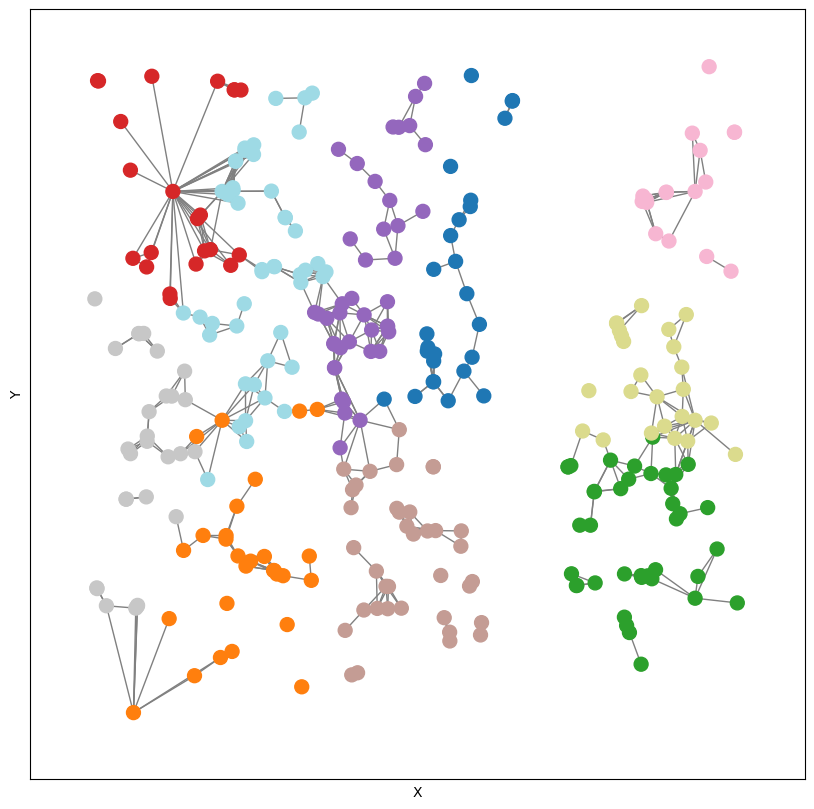

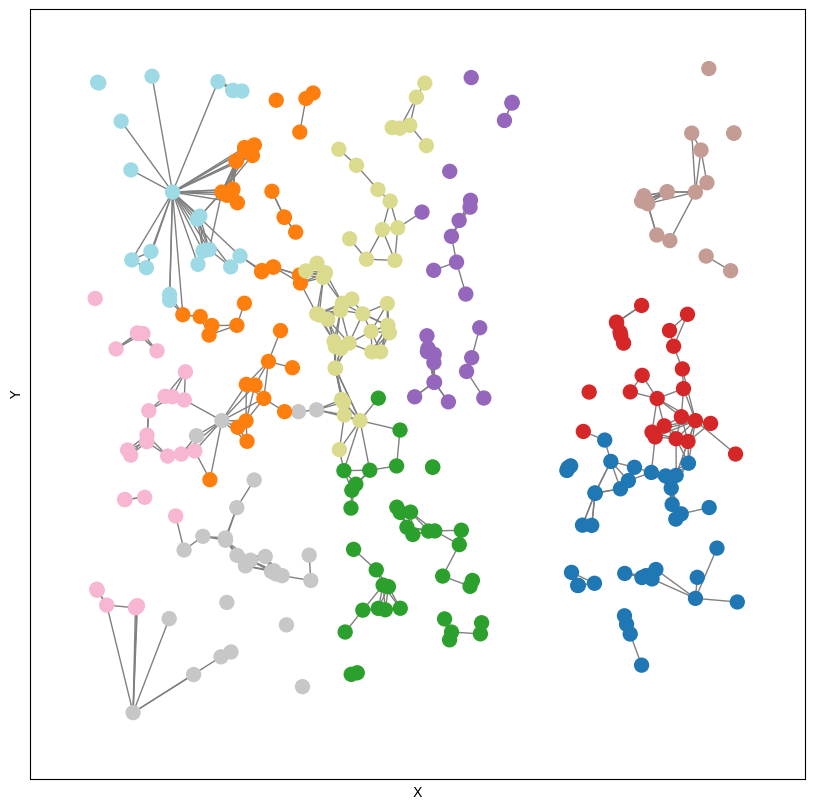

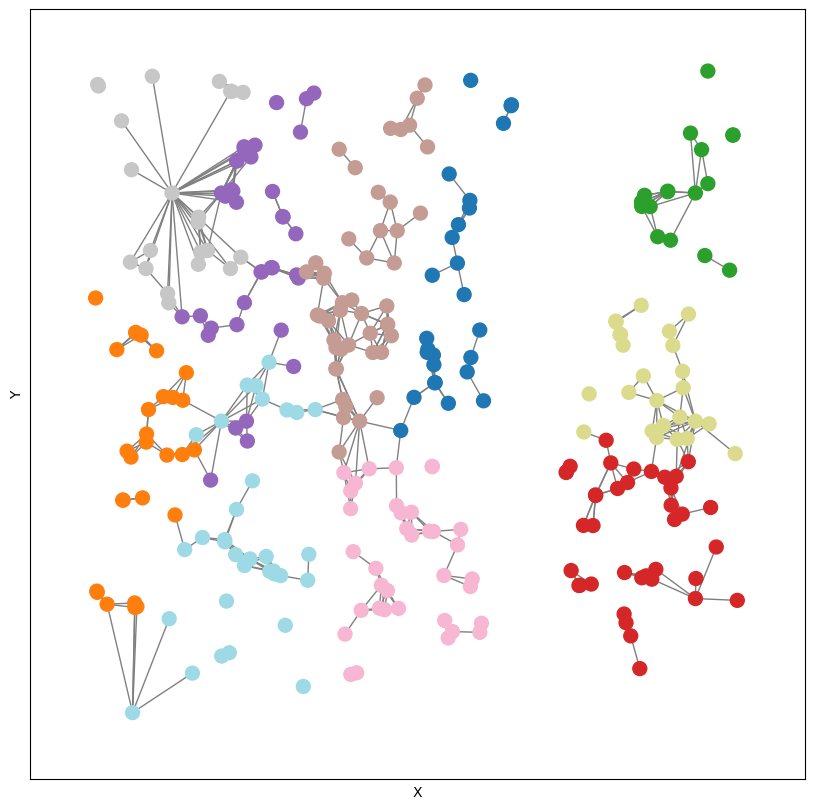

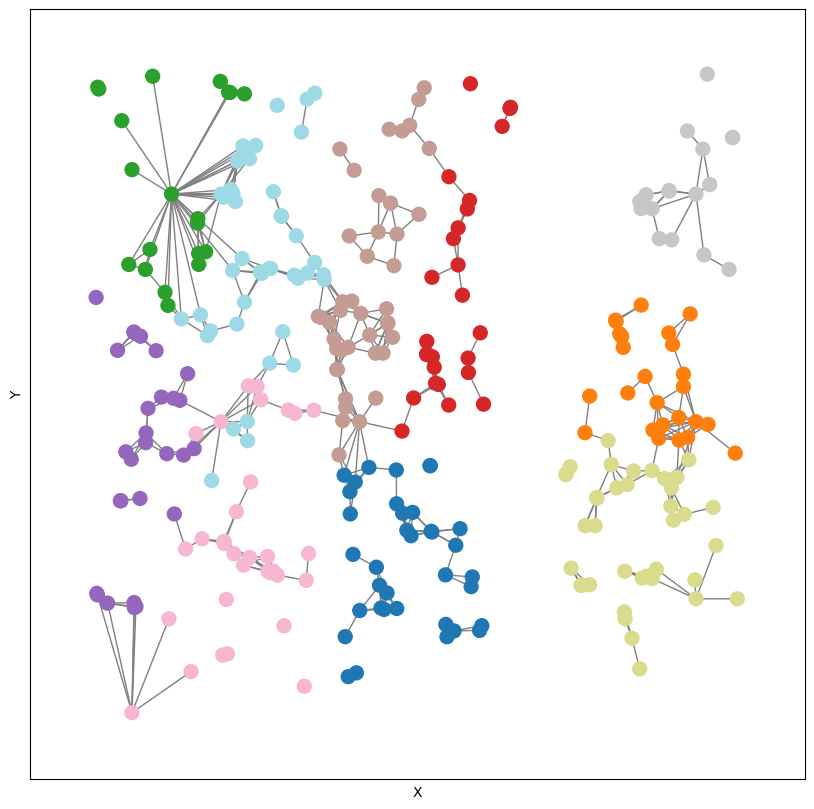

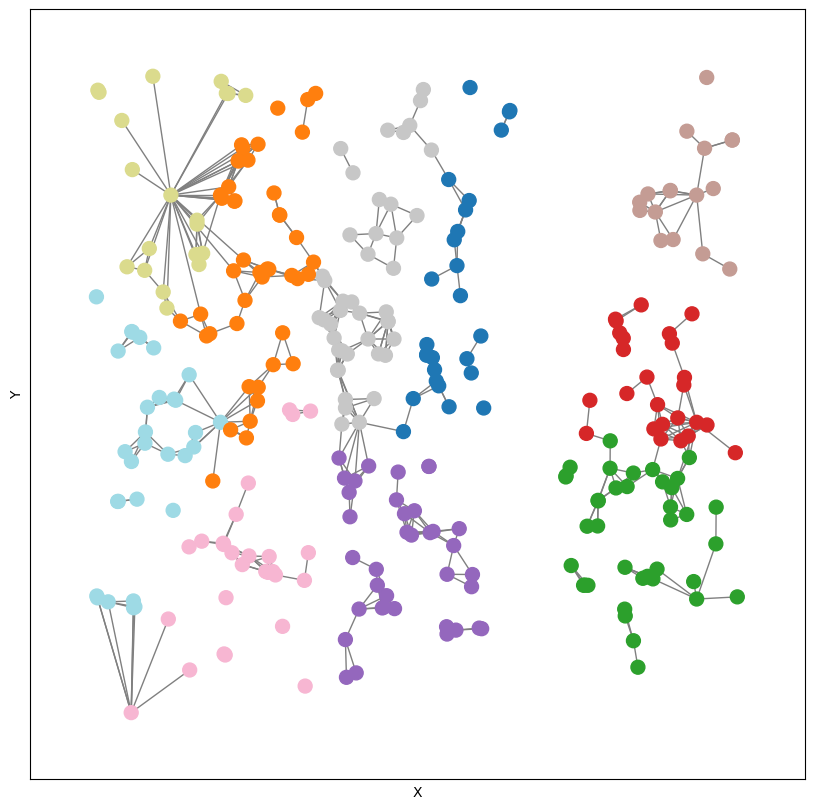

...

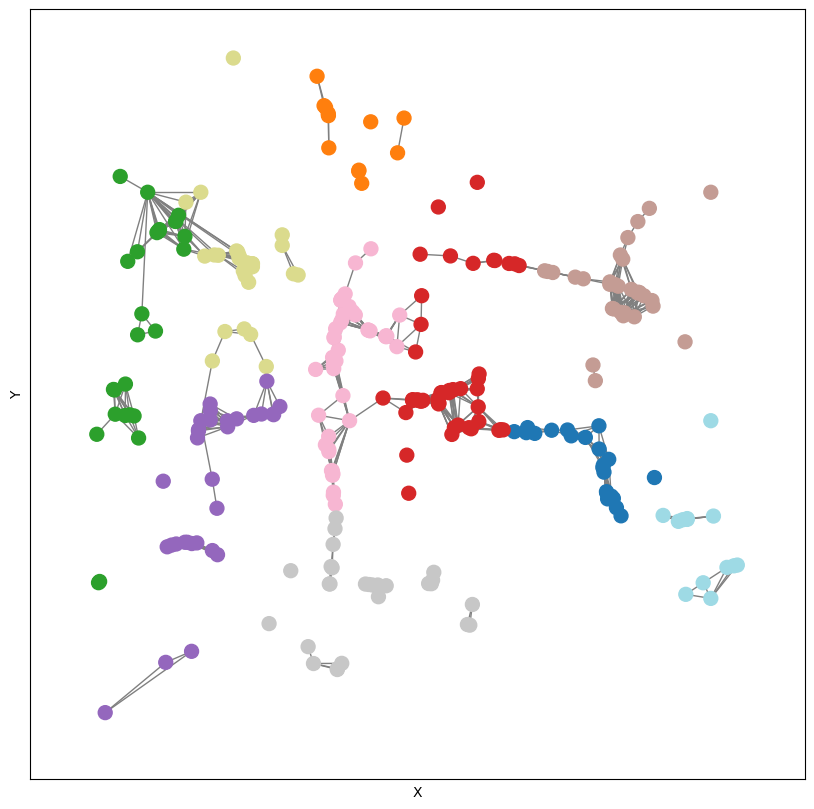

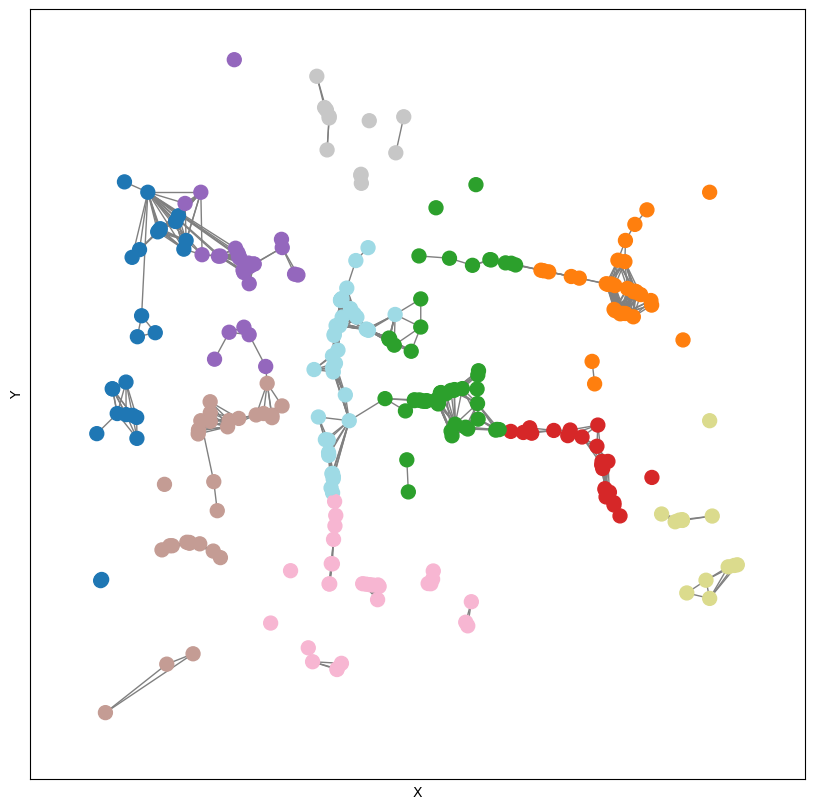

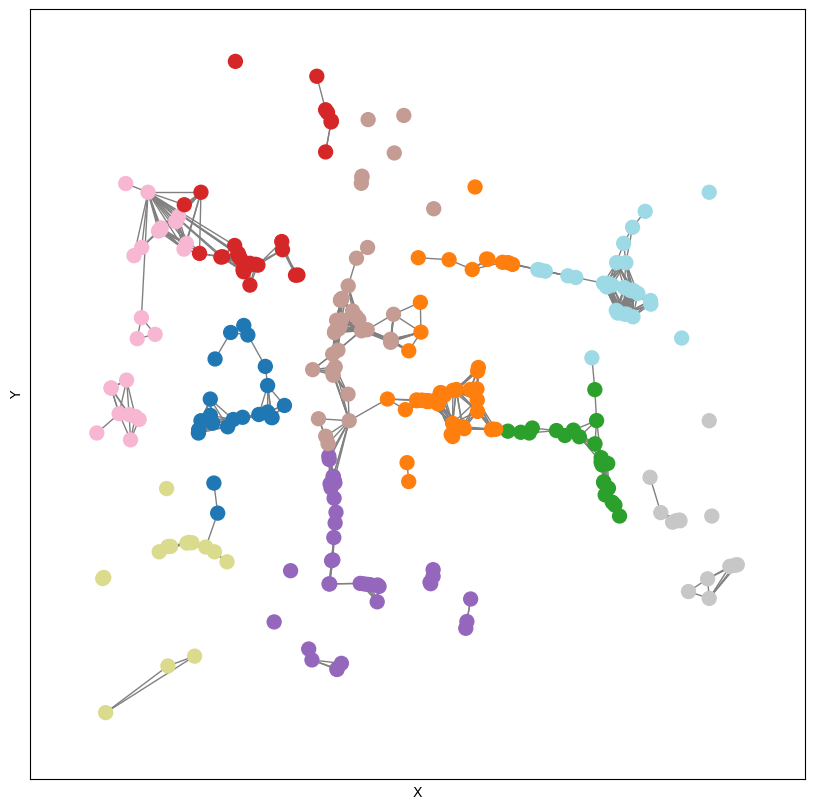

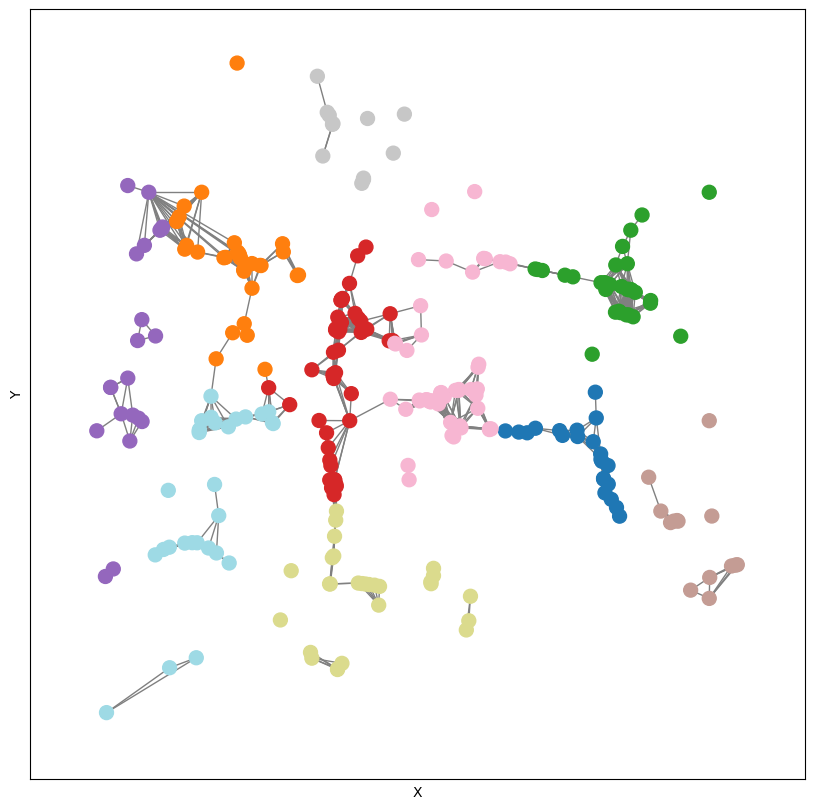

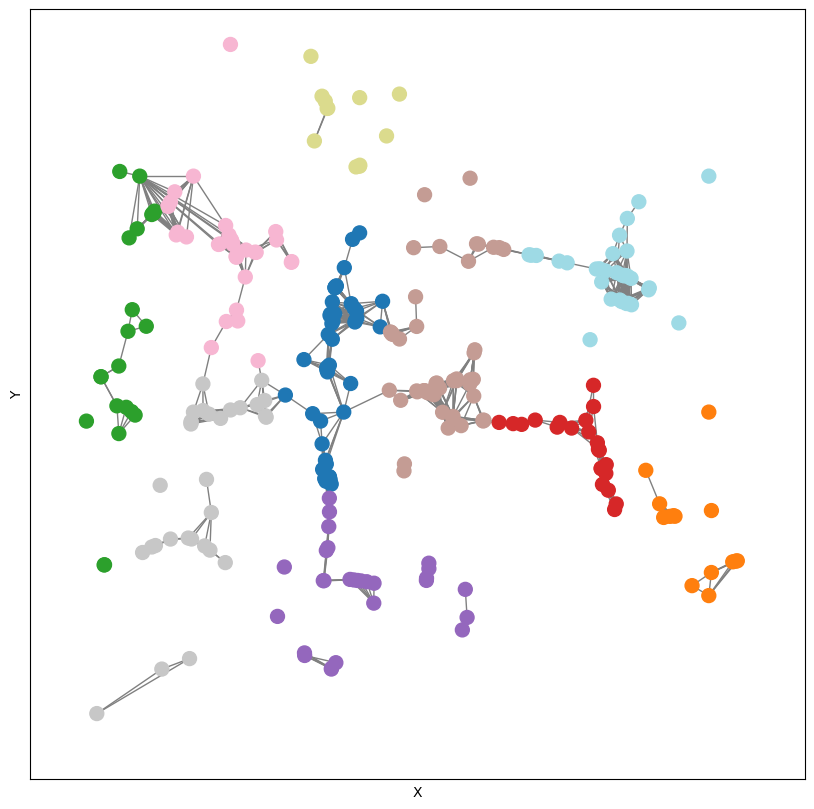

In [23]:
# Pre-Train the Model
if pre_trained:
  # Pre-Train the Model
  for t in range(1, pre_train):
    print("Pre-Trained ", t)
    model = train_single_time(model, optimizer, hidden_channels, t, train_datas[t], test_datas[t], int(epochs))

  if (pre_train == 1):
    model = train_single_time(model, optimizer, hidden_channels, 1, train_datas[1], test_datas[1], int(epochs))

  # Use the Model without updating
  for t in range(1, t_values):
     visualize_gnn_clusters_orig(hidden_channels, model, gnn_datasets, num_clusters, t, device)


# Live-Train the Model
if live_trained:
  for t in range(1, t_values):
      # Update the model every lag
      if t == 1 or (t % t_lag) == 0:
          print("--------------------------------TRAIN")
          model = train_single_time(model, optimizer, hidden_channels, t, train_datas[t], test_datas[t], int(epochs))
      visualize_gnn_clusters_orig(hidden_channels, model, gnn_datasets, num_clusters, t, device)


# Hybrid Train the Model
if hybrid_trained:
  # Pre-Train the Model
  for t in range(1, pre_train):
    print("Pre-Trained ", pre_train)
    model = train_single_time(model, optimizer, hidden_channels, t, train_datas[t], test_datas[t], int(epochs))

  # Update the model based on lag
  for t in range(1, t_values):
      if (t % t_lag) == 0:
          model = train_single_time(model, optimizer, hidden_channels, t, train_datas[t], test_datas[t], int(epochs))
      visualize_gnn_clusters_orig(hidden_channels, model, gnn_datasets, num_clusters, t, device)

save_gnn_metrics(t, num_clusters)

# Performance Analysis

## GNN Analysis

### Epoch & Evolution

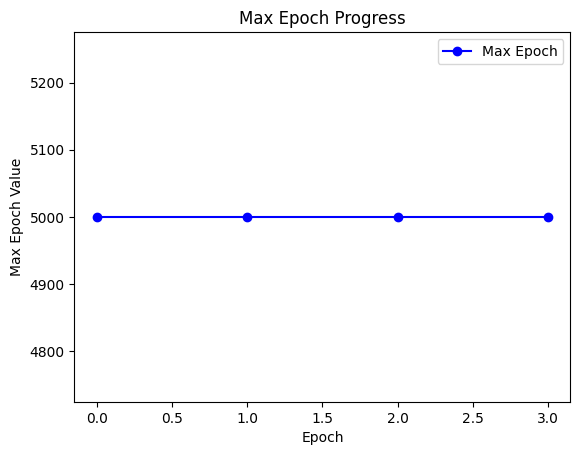

In [24]:
# Plotting the graph
plt.plot(max_epoch, marker='o', linestyle='-', color='b', label='Max Epoch')

# Labeling and Legends
plt.title('Max Epoch Progress')
plt.xlabel('Epoch')
plt.ylabel('Max Epoch Value')
plt.legend()

save_array_to_csv(f'EPOCH_Evolution', max_epoch, t, 'time', 'Cluster', t, num_clusters)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-epoch-evolution', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-epoch-evolution', format='eps', dpi=600)

plt.show()

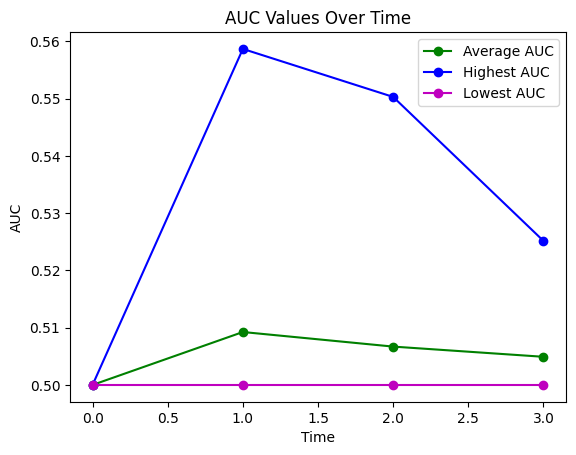

In [25]:
# Plot AUC values
plt.plot(average_auc_values, marker='o', linestyle='-', color='g', label='Average AUC')
plt.plot(highest_auc_values, marker='o', linestyle='-', color='b', label='Highest AUC')
plt.plot(lowest_auc_values, marker='o', linestyle='-', color='m', label='Lowest AUC')

# Labeling and Legends
plt.xlabel('Time')
plt.ylabel('AUC')
plt.title('AUC Values Over Time')
plt.legend()

save_array_to_csv(f'AVG_AUC_Evolution', average_auc_values, t, 'time', 'Cluster', t, num_clusters)
save_array_to_csv(f'MAX_AUC_Evolution', highest_auc_values, t, 'time', 'Cluster', t, num_clusters)
save_array_to_csv(f'MIN_AUC_Evolution', lowest_auc_values, t, 'time', 'Cluster', t, num_clusters)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-auc-evolution', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-auc-evolution', format='eps', dpi=600)

plt.show()

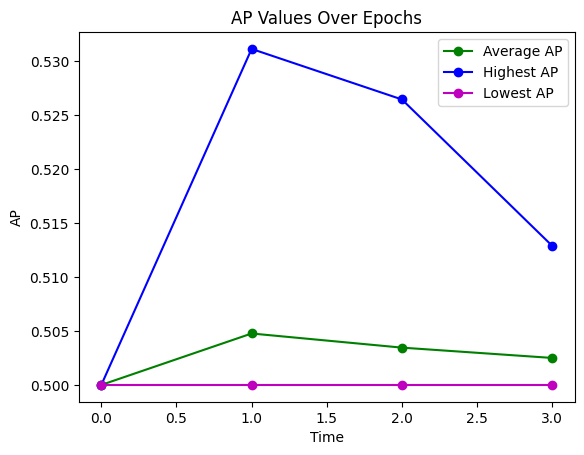

In [26]:
# Plot AP values
plt.plot(average_ap_values, marker='o', linestyle='-', color='g', label='Average AP')
plt.plot(highest_ap_values, marker='o', linestyle='-', color='b', label='Highest AP')
plt.plot(lowest_ap_values, marker='o', linestyle='-', color='m', label='Lowest AP')

# Labeling and Legends
plt.xlabel('Time')
plt.ylabel('AP')
plt.title('AP Values Over Epochs')
plt.legend()

save_array_to_csv(f'AVG_AP_Evolution', average_auc_values, t, 'time', 'Cluster', t, num_clusters)
save_array_to_csv(f'MAX_AP_Evolution', highest_auc_values, t, 'time', 'Cluster', t, num_clusters)
save_array_to_csv(f'MIN_AP_Evolution', lowest_auc_values, t, 'time', 'Cluster', t, num_clusters)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-ap-evolution', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-t{t}-cluster{num_clusters}-ap-evolution', format='eps', dpi=600)

plt.show()

### Graph Epoch AUC and AP



In [27]:
def plot_auc(auc_values, good_auc, folder_path, run_id, time, expected_epochs):
    plt.plot(auc_values[time], color='blue', linestyle='-', label='Good AP')
    plt.axhline(y=good_auc, color='blue', linestyle='--', label='Good AUC')

    # Legend
    plt.xlabel('Epochs')
    plt.ylabel('AUC Value')
    plt.title(f'AUC Evolution at Time {time}')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'{folder_path}{run_id}_auc_time{time}.png', format='png', dpi=600)
    plt.savefig(f'{folder_path}{run_id}_auc_time{time}.eps', format='eps', dpi=600)


def plot_ap(ap_values, good_ap, folder_path, run_id, time, expected_epochs):
    good_ap = 0.5

    plt.plot(ap_values[time], color='orange', linestyle='-', label='Good AP')
    plt.axhline(y=good_ap, color='orange', linestyle='--', label='Good AP')

    # Legend
    plt.xlabel('Time')
    plt.ylabel('AP Value')
    plt.title(f'AP Evolution at Time {time}')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'{folder_path}{run_id}_ap_time{time}.png', format='png', dpi=600)
    plt.savefig(f'{folder_path}{run_id}_ap_time{time}.eps', format='eps', dpi=600)

In [28]:
# # Good values for AUC and AP
# good_auc = 0.8
# good_ap = 0.5

# plt.figure(figsize=(10, 10))

# for t in range(0, len(all_auc_values)):
#     plot_auc(all_auc_values, good_auc, folder_path, run_id, t, epochs)
#     plot_ap(all_ap_values, good_ap, folder_path, run_id, t, epochs)

#     plt.savefig(f'{folder_path}{run_id}_{version}-auc-ap-time{t}.eps', format='eps', dpi=600)
#     plt.savefig(f'{folder_path}{run_id}_{version}-auc-ap-time{t}.png', format='png', dpi=600)

#     plt.show()

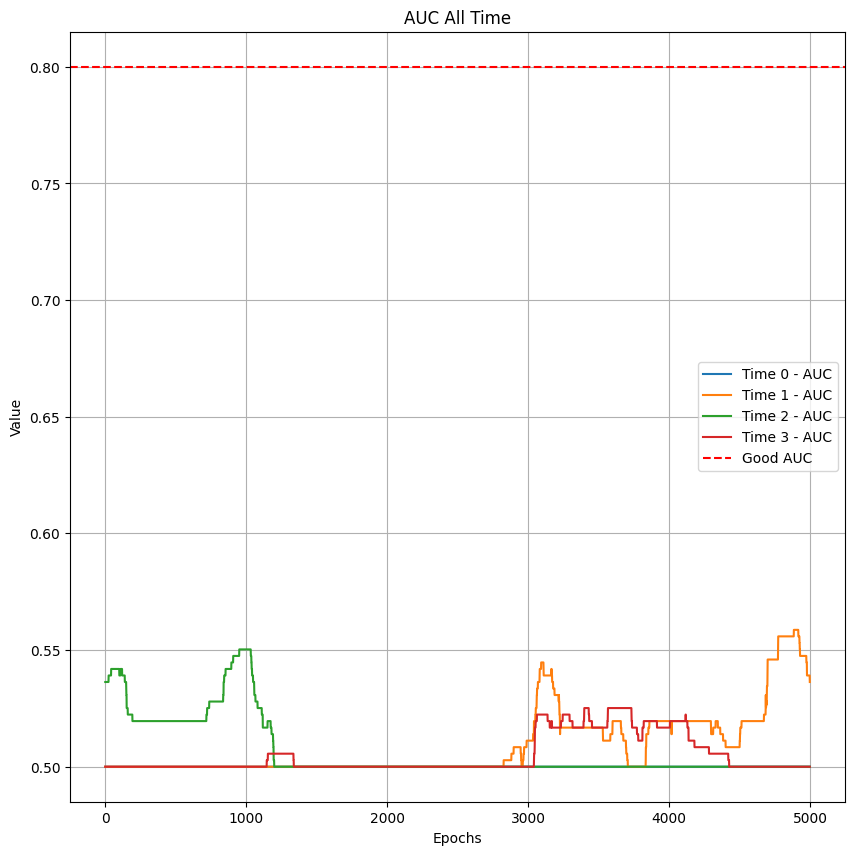

In [29]:
# Good values for AUC and AP
good_auc = 0.8
good_ap = 0.5

plt.figure(figsize=(10, 10))

for t in range(0, len(all_auc_values)):
    plt.plot(all_auc_values[t], label=f'Time {t} - AUC')

plt.axhline(y=good_auc, color='r', linestyle='--', label='Good AUC')

# Labels
plt.xlabel('Epochs')
plt.ylabel('Value')
plt.title('AUC All Time')
plt.legend()
plt.grid(True)

plt.savefig(f'{folder_path}{run_id}_{version}-auc-all-time.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-auc-all-time.eps', format='eps', dpi=600)

plt.show()

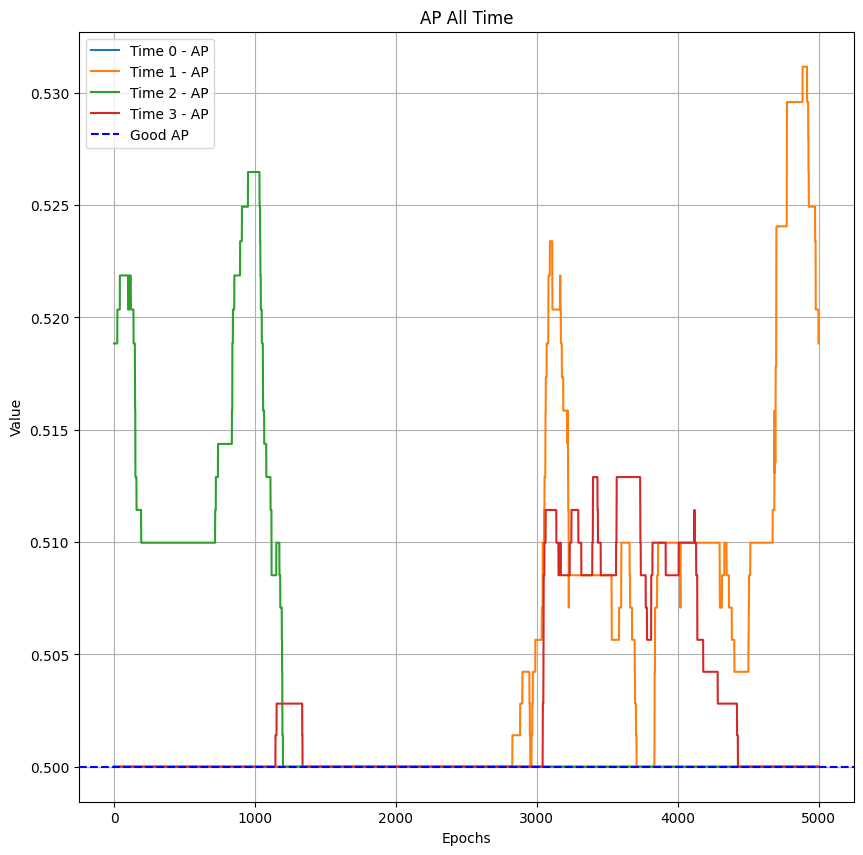

In [30]:
plt.figure(figsize=(10, 10))

for t in range(0, len(all_ap_values)):
   plt.plot(all_ap_values[t], label=f'Time {t} - AP')

plt.axhline(y=good_ap, color='b', linestyle='--', label='Good AP')

# Labels
plt.xlabel('Epochs')
plt.ylabel('Value')
plt.title('AP All Time')
plt.legend()
plt.grid(True)

plt.savefig(f'{folder_path}{run_id}_{version}-ap-all-time.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-ap-all-time.eps', format='eps', dpi=600)

plt.show()

### Edge and Node Count

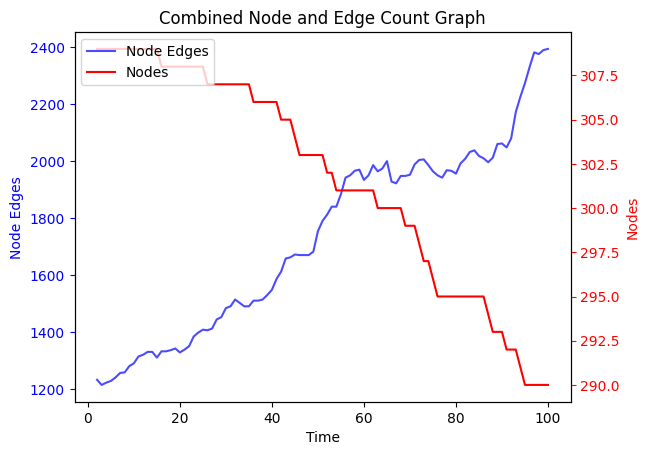

In [31]:
nodes = []
gnn_edges = []

for t in range(0, t_values):
    # print('dataset',gnn_datas[t])

    nodes.append(len(gnn_datas[t].x))
    gnn_edges.append(len(gnn_datas[t].edge_index[1]))

t_values = len(nodes)
epochs = range(1, t_values + 1)

fig, ax1 = plt.subplots()
ax1.plot(epochs[1:], gnn_edges[1:], color='b', alpha=0.7, label='Node Edges')
ax1.set_xlabel('Time')
ax1.set_ylabel('Node Edges', color='b')
ax1.tick_params('y', colors='b')

# Create a second y-axis for the line graph
ax2 = ax1.twinx()
ax2.plot(epochs[1:], nodes[1:], color='r', label='Nodes')
ax2.set_ylabel('Nodes', color='r')
ax2.tick_params('y', colors='r')

# Add a legend
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc='upper left')

# Set the title
plt.title('Combined Node and Edge Count Graph')
plt.savefig(f'{folder_path}{run_id}_{version}-edge-nodes-baseline-time{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-edge-nodes-baseline-time{t}.png', format='png', dpi=600)

plt.show()

save_array_to_csv(f'Nodes', nodes[1:], t_values, 'Time', 'Cluster', t, num_clusters)
save_array_to_csv(f'gnn_Edges', gnn_edges[1:], t_values, 'Time', 'Cluster', t, num_clusters)

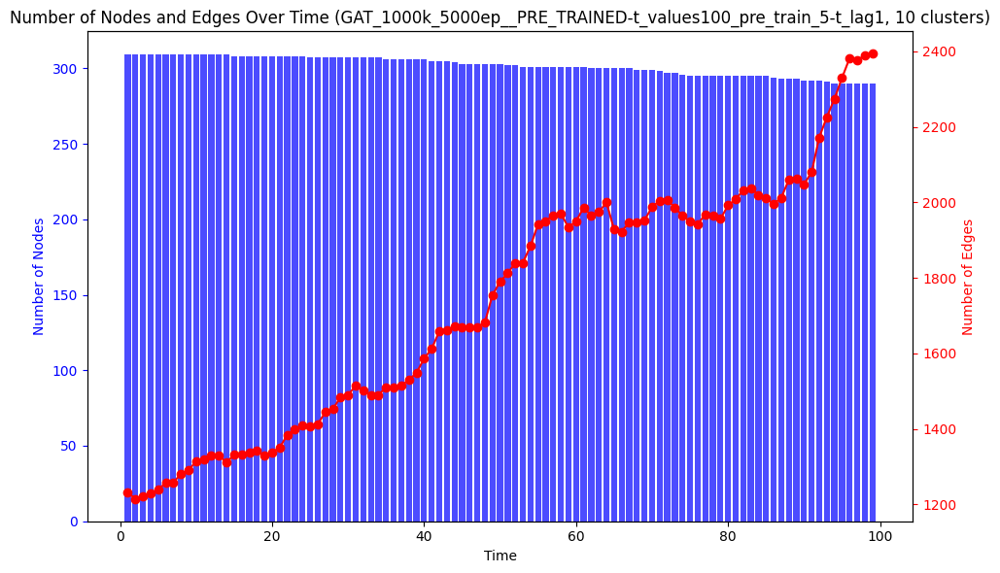

In [32]:
def plot_bar_line_metrics_over_time(nodes, edges, folder_path, run_id, num_clusters, epochs):
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Plot bar graph for nodes
    ax1.bar(np.arange(1, len(nodes)), nodes[1:], color='b', alpha=0.7, label='Nodes')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('Number of Nodes', color='b')
    ax1.tick_params('y', colors='b')

    # Create a secondary y-axis for the line graph
    ax2 = ax1.twinx()
    ax2.plot(np.arange(1, len(edges)), edges[1:], color='r', marker='o', label='Edges')
    ax2.set_ylabel('Number of Edges', color='r')
    ax2.tick_params('y', colors='r')

    # Title and legend
    plt.title(f'Number of Nodes and Edges Over Time ({run_id}, {num_clusters} clusters)')
    fig.tight_layout()


    plt.savefig(f'{folder_path}{run_id}_{num_clusters}_nodes_edges_over_time.png', format='png', dpi=600)
    plt.savefig(f'{folder_path}{run_id}_{num_clusters}_nodes_edges_over_time.eps', format='eps', dpi=600)

    plt.show()


plot_bar_line_metrics_over_time(nodes, gnn_edges, folder_path, run_id, num_clusters, epochs)

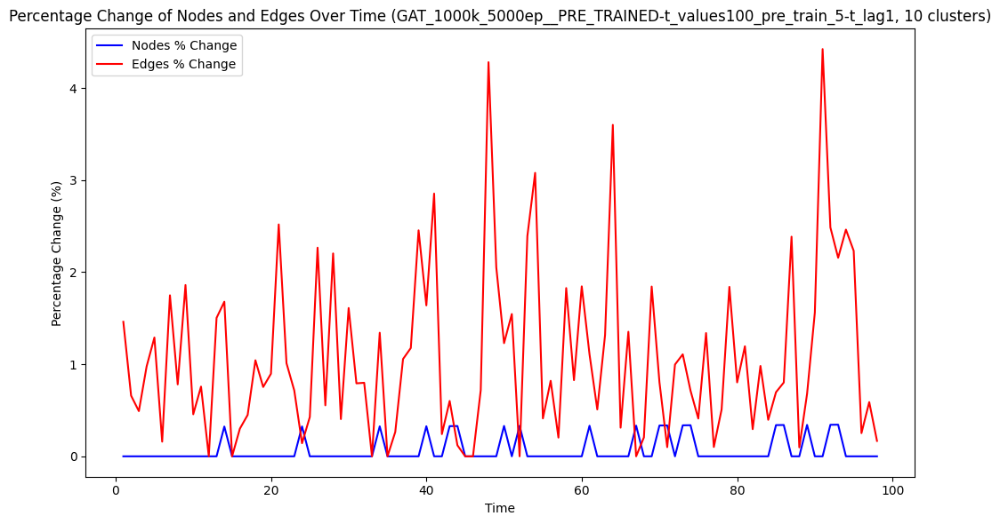

In [33]:
def plot_percentage_change_over_time(nodes, edges, folder_path, run_id, num_clusters, epochs):
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Calculate percentage change for nodes
    nodes_percentage_change = [(nodes[i] - nodes[i - 1]) / (nodes[i - 1] + 1e-10) * 100 for i in range(2, len(nodes))]

    # Calculate percentage change for edges
    edges_percentage_change = [(edges[i] - edges[i - 1]) / (edges[i - 1] + 1e-10) * 100 for i in range(2, len(edges))]

    # Ensure both arrays have the same length
    min_length = min(len(nodes_percentage_change), len(edges_percentage_change))
    nodes_percentage_change = nodes_percentage_change[:min_length]
    edges_percentage_change = edges_percentage_change[:min_length]

    # Make all percentage change values positive
    nodes_percentage_change = [abs(val) for val in nodes_percentage_change]
    edges_percentage_change = [abs(val) for val in edges_percentage_change]

    # Plot percentage change as line graphs with legend
    ax1.plot(np.arange(1, len(nodes_percentage_change) + 1), nodes_percentage_change, color='blue', linestyle='-', label='Nodes % Change')
    ax1.plot(np.arange(1, len(edges_percentage_change) + 1), edges_percentage_change, color='red', linestyle='-', label='Edges % Change')

    # Legend
    plt.title(f'Percentage Change of Nodes and Edges Over Time ({run_id}, {num_clusters} clusters)')
    plt.xlabel('Time')
    plt.ylabel('Percentage Change (%)')
    ax1.legend(loc='upper left')

    fig.tight_layout()

    plt.savefig(f'{folder_path}{run_id}_{num_clusters}_nodes_edges_percentage_change.png', format='png', dpi=600)
    plt.savefig(f'{folder_path}{run_id}_{num_clusters}_nodes_edges_percentage_change.eps', format='eps', dpi=600)

    plt.show()

plot_percentage_change_over_time(nodes, gnn_edges, folder_path, run_id, num_clusters, epochs)

## Clustering Visualizations

### Baseline Approach

In [34]:
# # ------------------------------------------------------------Baseline Approach Clustering
# print(f"total time {len(gnn_datasets)}")

# for t in range(0, len(gnn_datasets)):
#     print("Time: ", t + 1)

#     node_eval_data = gnn_datas[t]
#     node_X = node_eval_data.x[:, [0, 1]].cpu().detach().numpy()

#     node_df = pd.DataFrame(node_X, columns=[f'x{t}', f'y{t}'])

#     node_cluster_centers = node_cluster_centers

#     node_G = to_networkx(node_eval_data)
#     node_G = node_G.to_undirected()
#     node_labels = node_kmeans_model[t].labels_

#     node_pos = dict(zip(range(node_X[:, 0].size), node_X))

#     print("------------KMeans Baseline Approach---------------")
#     node_cluster_head_indices = []
#     node_distances_to_centers = node_kmeans_model[t].transform(node_X)
#     for i in range(num_clusters):
#         node_cluster_data_indices = np.where(node_labels == i)[0]
#         node_distances_to_center = node_distances_to_centers[node_cluster_data_indices, i]
#         node_cluster_head_index = node_cluster_data_indices[np.argmin(node_distances_to_center)]
#         node_cluster_head_indices.append(node_cluster_head_index)

#     fig, ax = plt.subplots(figsize=(10, 10))
#     nx.draw_networkx_edges(node_G, node_pos, alpha=0.5, edge_color='grey', ax=ax)
#     nx.draw_networkx_nodes(node_G, node_pos, node_color='grey', node_size=20, ax=ax)

#     node_cluster_x, node_cluster_y = zip(*node_cluster_centers[t])
#     cluster_scatter = ax.scatter(node_cluster_x, node_cluster_y, marker='X', s=500, c='red', label='Baseline Cluster Centers')

#     node_cluster_head_x = [node_X[i][0] for i in node_cluster_head_indices]
#     node_cluster_head_y = [node_X[i][1] for i in node_cluster_head_indices]
#     cluster_head_scatter = ax.scatter(node_cluster_head_x, node_cluster_head_y, marker='D', s=200, c='red', edgecolors='white', linewidth=1, label='Baseline Cluster Heads')
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.legend(handles=[cluster_scatter, cluster_head_scatter])

#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-node-features-baseline-time{t}.eps', format='eps', dpi=600)
#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-node-features-baseline-time{t}.png', format='png', dpi=600)

#     plt.show()

#     save_array_to_csv(f'Baseline_Clustering', node_cluster_head_indices, num_clusters, 'Cluster Heads', 'Cluster', t, i)

### GNN Approach

In [35]:
# # ------------------------------------------------------------GNN Approach Clustering
# print(f"total time {len(gnn_datasets)}")

# for t in range(0, len(gnn_datasets)):
#     print("Time: ", t + 1)

#     gnn_data = gnn_datas[t].to(device)

#     model.eval()
#     with torch.no_grad():
#         z = model.encode(gnn_data.x, gnn_data.edge_index)

#     # Perform KMeans clustering on the latent space (z)
#     z = z.cpu().detach().numpy()
#     gnn_kmeans = KMeans(n_clusters=num_clusters, n_init=n).fit(z)

#     gnn_eval_data = gnn_datas[t]
#     gnn_X = gnn_eval_data.x[:, [0, 1]].cpu().detach().numpy()
#     gnn_df = pd.DataFrame(gnn_X, columns=['X', 'Y'])

#     gnn_G = to_networkx(gnn_eval_data).to_undirected()
#     gnn_labels = gnn_kmeans.labels_
#     gnn_cluster_centers = np.abs(gnn_kmeans.cluster_centers_)

#     gnn_pos = dict(zip(range(gnn_X[:, 0].size), gnn_X))

#     print("------------KMeans GNN Approach---------------")
#     gnn_cluster_head_indices = []
#     gnn_distances_to_centers = gnn_kmeans.transform(gnn_X)
#     for i in range(num_clusters):
#         gnn_cluster_data_indices = np.where(gnn_labels == i)[0]

#         if len(gnn_cluster_data_indices) > 0:
#             gnn_distances_to_center = gnn_distances_to_centers[gnn_cluster_data_indices, i]
#             gnn_cluster_head_index = gnn_cluster_data_indices[np.argmin(gnn_distances_to_center)]
#             gnn_cluster_head_indices.append(gnn_cluster_head_index)

#     # Calculate cluster centers directly from GNN data
#     cluster_centers = gnn_df.groupby(gnn_labels)[['X', 'Y']].mean()
#     gnn_cluster_centers_x, gnn_cluster_centers_y = cluster_centers.values.T

#     # Plot the clusters and heads
#     fig, ax = plt.subplots(figsize=(10, 10))
#     nx.draw_networkx_edges(gnn_G, gnn_pos, alpha=0.1, ax=ax)
#     gnn_scatter = ax.scatter(gnn_df['X'], gnn_df['Y'], s=20, color='grey', label='Nodes')
#     nx.draw_networkx_nodes(gnn_G, gnn_pos, cmap=plt.get_cmap('tab20'), node_color='grey', node_size=20, ax=ax)

#     cluster_center_scatter = ax.scatter(gnn_cluster_centers_x, gnn_cluster_centers_y, marker='X', s=500, c='green', edgecolors='white', linewidth=1, label='GNN Cluster Centers')
#     cluster_head_scatter = ax.scatter(gnn_df.loc[gnn_cluster_head_indices, 'X'], gnn_df.loc[gnn_cluster_head_indices, 'Y'], marker='D', s=200, c='green', edgecolors='white', linewidth=1, label='GNN Cluster Heads')

#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')

#     handles, labels = ax.get_legend_handles_labels()
#     handles.append(cluster_center_scatter)
#     handles.append(cluster_head_scatter)
#     ax.legend(handles=handles, labels=labels)

#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-gnn-features-baseline-time{t}.eps', format='eps', dpi=300)
#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-gnn-features-baseline-time{t}.png', format='png', dpi=300)

#     plt.show()

#     save_array_to_csv(f'GNN_Clustering', gnn_cluster_head_indices, num_clusters, 'Cluster Heads', 'Cluster', t, i)

### Combined Approach

In [36]:
# # ------------------------------------------------------------GNN and Baseline Approach Clustering Combined
# print(f"total time {len(gnn_datasets)}")

# for t in range(0, len(gnn_datasets)):
#     print("Time: ", t + 1)

#     # GNN Approach
#     gnn_data = gnn_datas[t].to(device)
#     model.eval()
#     with torch.no_grad():
#         z = model.encode(gnn_data.x, gnn_data.edge_index)
#     z = z.cpu().detach().numpy()
#     gnn_kmeans = KMeans(n_clusters=num_clusters, n_init=n).fit(z)

#     gnn_eval_data = gnn_datas[t]
#     gnn_X = gnn_eval_data.x[:, [0, 1]].cpu().detach().numpy()
#     gnn_df = pd.DataFrame(gnn_X, columns=['X', 'Y'])
#     gnn_G = to_networkx(gnn_eval_data).to_undirected()
#     gnn_labels = gnn_kmeans.labels_
#     gnn_cluster_centers = np.abs(gnn_kmeans.cluster_centers_)

#     gnn_pos = dict(zip(range(gnn_X[:, 0].size), gnn_X))

#     # KMeans GNN Approach
#     gnn_cluster_head_indices = []
#     gnn_distances_to_centers = gnn_kmeans.transform(gnn_X)
#     for i in range(num_clusters):
#         gnn_cluster_data_indices = np.where(gnn_labels == i)[0]
#         gnn_distances_to_center = gnn_distances_to_centers[gnn_cluster_data_indices, i]
#         gnn_cluster_head_index = gnn_cluster_data_indices[np.argmin(gnn_distances_to_center)]
#         gnn_cluster_head_indices.append(gnn_cluster_head_index)

#     # Calculate cluster centers directly from GNN data
#     cluster_centers_gnn = gnn_df.groupby(gnn_labels)[['X', 'Y']].mean()
#     gnn_cluster_centers_x, gnn_cluster_centers_y = cluster_centers_gnn.values.T

#     # Baseline Approach
#     node_eval_data = gnn_datas[t]
#     node_X = node_eval_data.x[:, [0, 1]].cpu().detach().numpy()
#     node_df = pd.DataFrame(node_X, columns=[f'x{t}', f'y{t}'])
#     node_G = to_networkx(node_eval_data)
#     node_G = node_G.to_undirected()
#     node_labels = node_kmeans_model[t].labels_
#     node_pos = dict(zip(range(node_X[:, 0].size), node_X))

#     # KMeans Baseline Approach
#     node_cluster_head_indices = []
#     node_distances_to_centers = node_kmeans_model[t].transform(node_X)
#     for i in range(num_clusters):
#         node_cluster_data_indices = np.where(node_labels == i)[0]
#         node_distances_to_center = node_distances_to_centers[node_cluster_data_indices, i]
#         node_cluster_head_index = node_cluster_data_indices[np.argmin(node_distances_to_center)]
#         node_cluster_head_indices.append(node_cluster_head_index)

#     # Plot the clusters and heads for both GNN and Baseline Approach
#     fig, ax = plt.subplots(figsize=(10, 10))
#     nx.draw_networkx_edges(gnn_G, gnn_pos, alpha=0.1, ax=ax)
#     gnn_scatter = ax.scatter(gnn_df['X'], gnn_df['Y'], s=20, color='grey', label='Nodes GNN')
#     nx.draw_networkx_nodes(gnn_G, gnn_pos, cmap=plt.get_cmap('tab20'), node_color='grey', node_size=20, ax=ax)

#     cluster_center_scatter_gnn = ax.scatter(gnn_cluster_centers_x, gnn_cluster_centers_y, marker='X', s=500, c='green', edgecolors='white', linewidth=1, label='GNN Cluster Centers')
#     cluster_head_scatter_gnn = ax.scatter(gnn_df.loc[gnn_cluster_head_indices, 'X'], gnn_df.loc[gnn_cluster_head_indices, 'Y'], marker='D', s=200, c='green', edgecolors='white', linewidth=1, label='GNN Cluster Heads')

#     node_cluster_x, node_cluster_y = zip(*node_cluster_centers[t])
#     cluster_scatter_node = ax.scatter(node_cluster_x, node_cluster_y, marker='X', s=500, c='red', label='Baseline Cluster Centers')

#     node_cluster_head_x = [node_X[i][0] for i in node_cluster_head_indices]
#     node_cluster_head_y = [node_X[i][1] for i in node_cluster_head_indices]
#     cluster_head_scatter_node = ax.scatter(node_cluster_head_x, node_cluster_head_y, marker='D', s=200, c='red', edgecolors='white', linewidth=1, label='Baseline Cluster Heads')

#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')

#     ax.legend(loc='upper right')


#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-gnn-baseline-time{t}.eps', format='eps', dpi=300)
#     plt.savefig(f'{folder_path}{run_id}_{version}-cluster-centers-gnn-baseline-time{t}.png', format='png', dpi=300)

#     plt.show()

#     save_array_to_csv(f'GNN_Baseline_Clustering', gnn_cluster_head_indices, num_clusters, 'GNN Cluster Heads', 'Baseline Cluster Heads', t, i)

## Generate Analysis



### Sum of Squares (SSE - Elbow)

---------------KMEANS BASELINE----------------


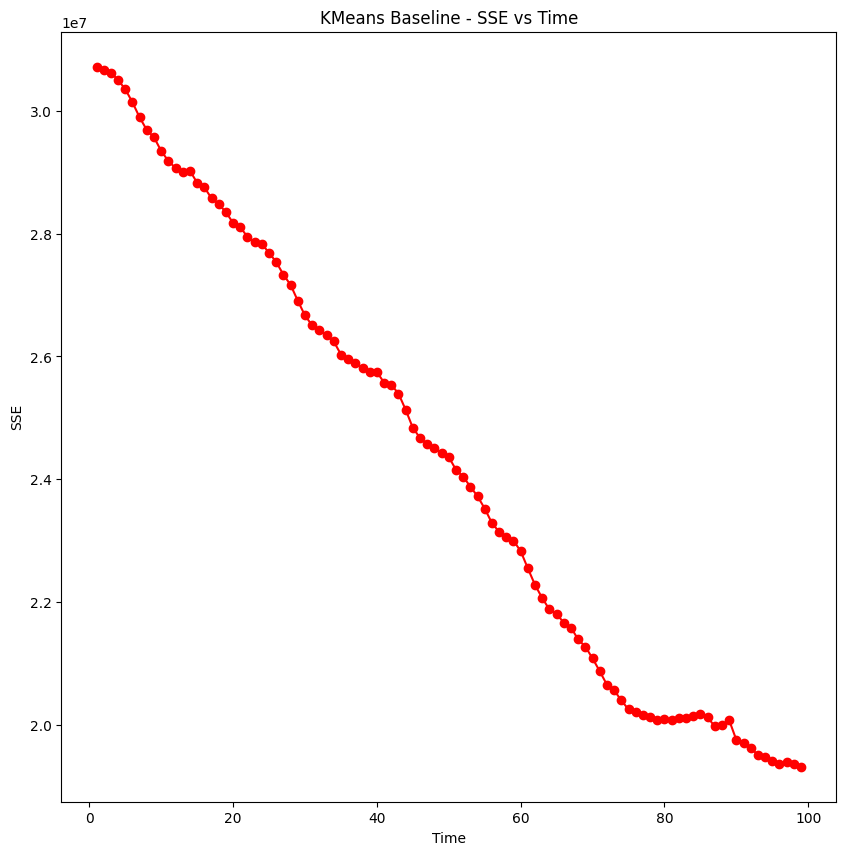

In [37]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS BASELINE----------------")
plt.plot(range(1, len(node_sse_values)), node_sse_values[1:], marker='o', linestyle='-', color='red')

plt.xlabel('Time')
plt.ylabel('SSE')
plt.title('KMeans Baseline - SSE vs Time')
plt.savefig(f'{folder_path}{run_id}_{version}-sse-baseline.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-sse-baseline.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS GNN----------------


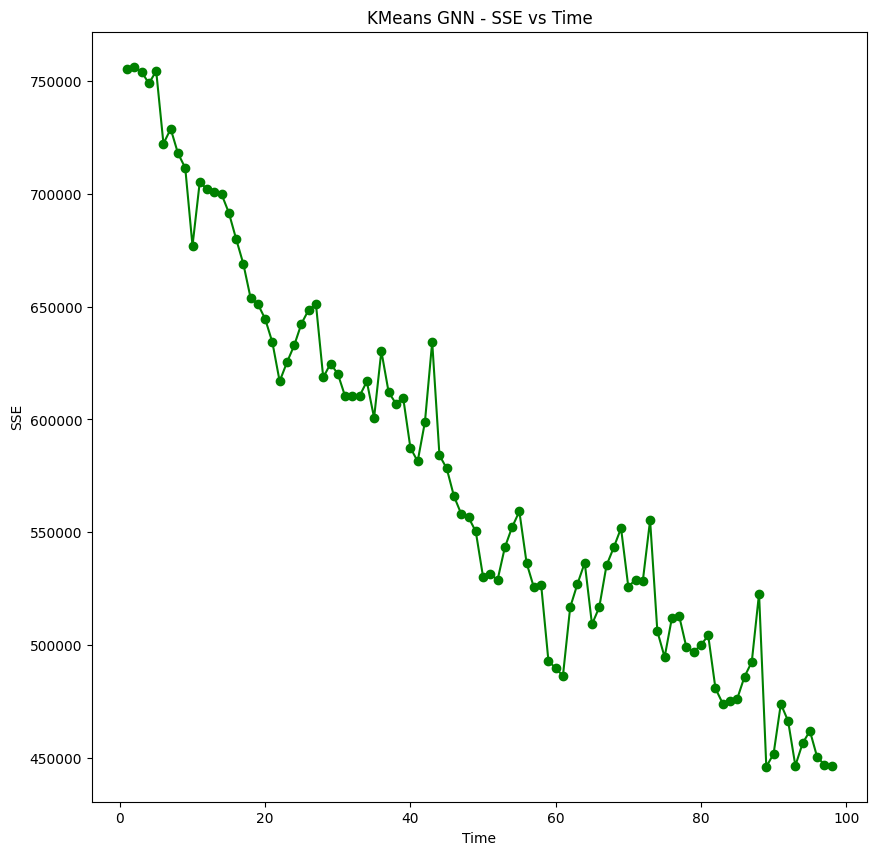

In [38]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS GNN----------------")
plt.plot(range(1,len(gnn_sse_values)), gnn_sse_values[1:], marker='o', linestyle='-', color='green')

plt.xlabel('Time')
plt.ylabel('SSE')
plt.title('KMeans GNN - SSE vs Time')
plt.savefig(f'{folder_path}{run_id}_{version}-sse-gnn.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-sse-gnn.eps', format='eps', dpi=600)
plt.show()


---------------KMEANS Combined----------------


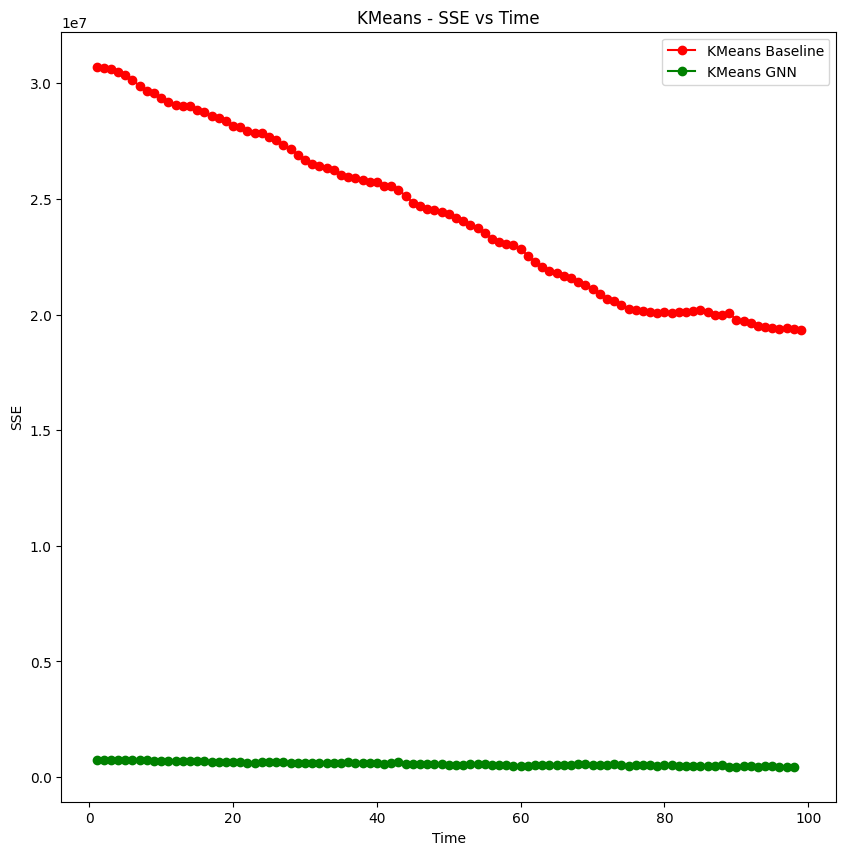

In [39]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Combined----------------")
plt.plot(range(1, len(node_sse_values)), node_sse_values[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')
plt.plot(range(1, len(gnn_sse_values)), gnn_sse_values[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

plt.xlabel('Time')
plt.ylabel('SSE')
plt.title('KMeans - SSE vs Time')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-sse-combined.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-sse-combined.eps', format='eps', dpi=600)
plt.show()

### Mean Squared Error (MSE)

---------------KMEANS Baseline----------------


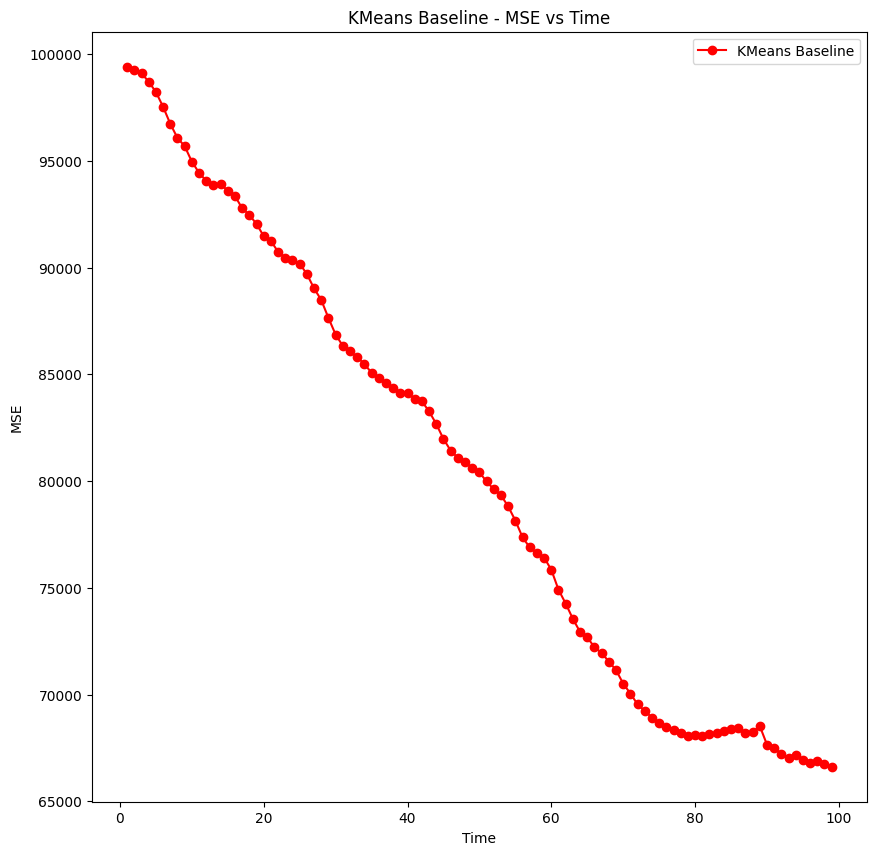

In [40]:

fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Baseline----------------")
ax.plot(range(1, len(node_mse_values)), node_mse_values[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')

ax.set_xlabel('Time')
ax.set_ylabel('MSE')
ax.set_title('KMeans Baseline - MSE vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-mse-baseline.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-mse-baseline.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS GNN----------------


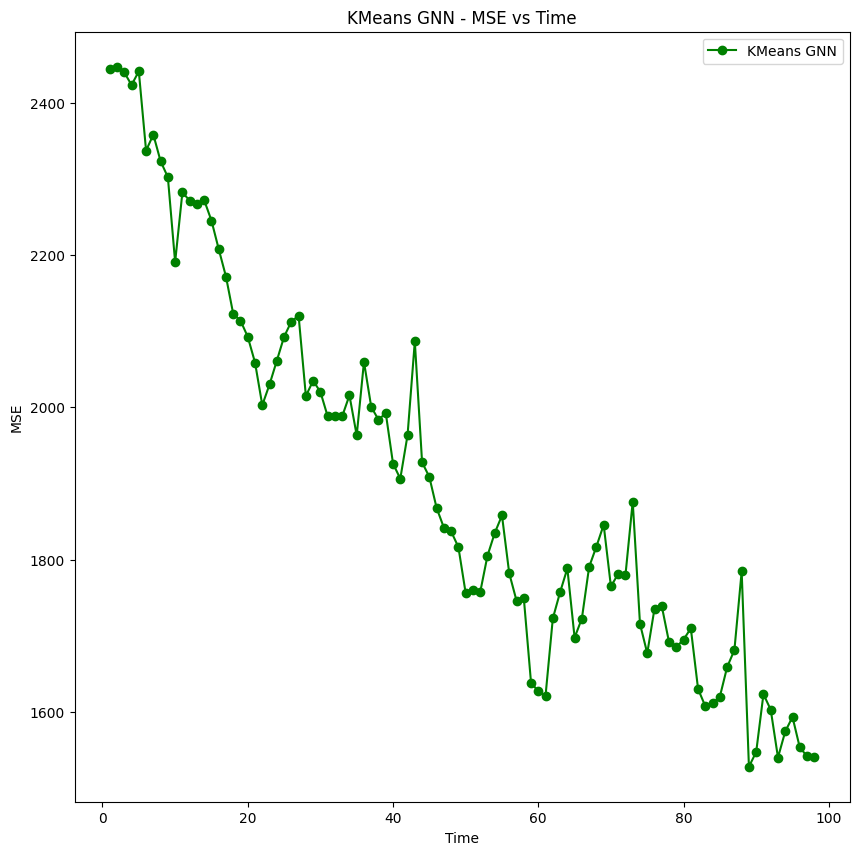

In [41]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS GNN----------------")
ax.plot(range(1,len(gnn_mse_values)), gnn_mse_values[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('MSE')
ax.set_title('KMeans GNN - MSE vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-mse-gnn.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-mse-gnn.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS COMBINED----------------


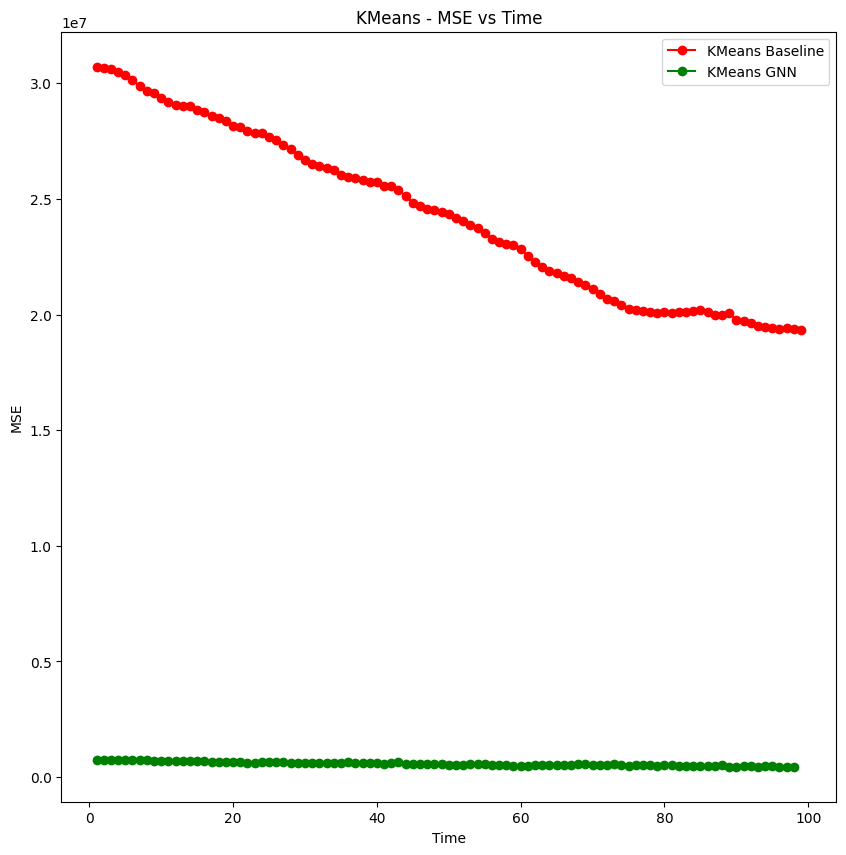

In [42]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS COMBINED----------------")
ax.plot(range(1, len(node_sse_values)), node_sse_values[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')
ax.plot(range(1, len(gnn_sse_values)), gnn_sse_values[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('MSE')
ax.set_title('KMeans - MSE vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-mse-combined.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-mse-combined.eps', format='eps', dpi=600)
plt.show()

### Silhoutte Score

---------------KMEANS Baseline----------------


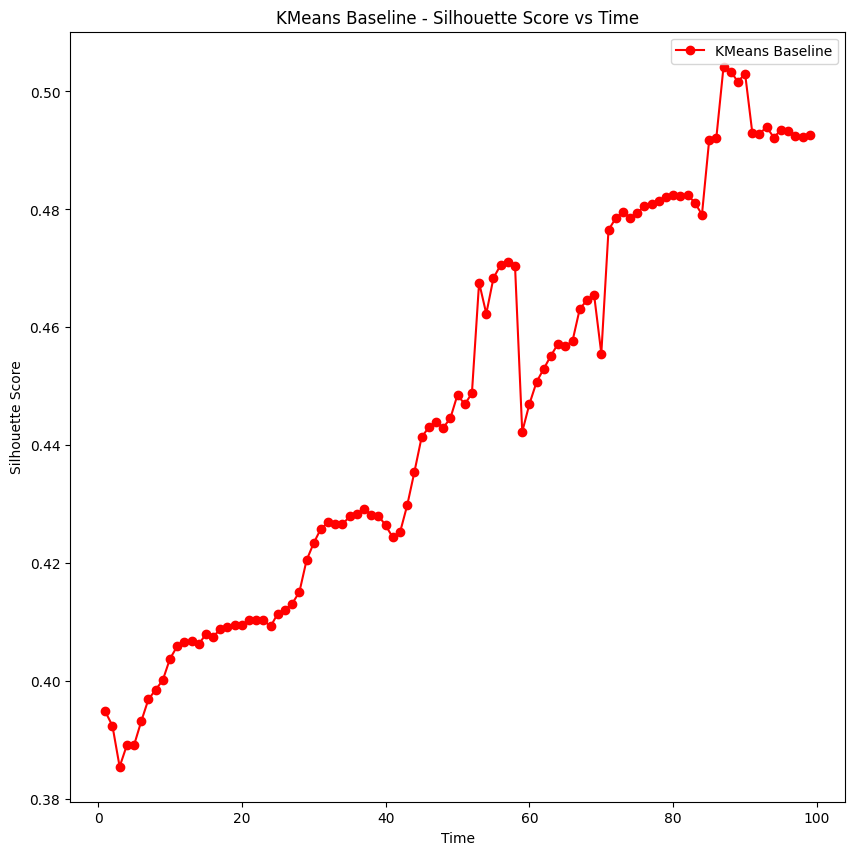

In [43]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Baseline----------------")
ax.plot(range(1, len(node_silhouette_score)), node_silhouette_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')

ax.set_xlabel('Time')
ax.set_ylabel('Silhouette Score')
ax.set_title('KMeans Baseline - Silhouette Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-baseline.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-baseline.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS GNN----------------


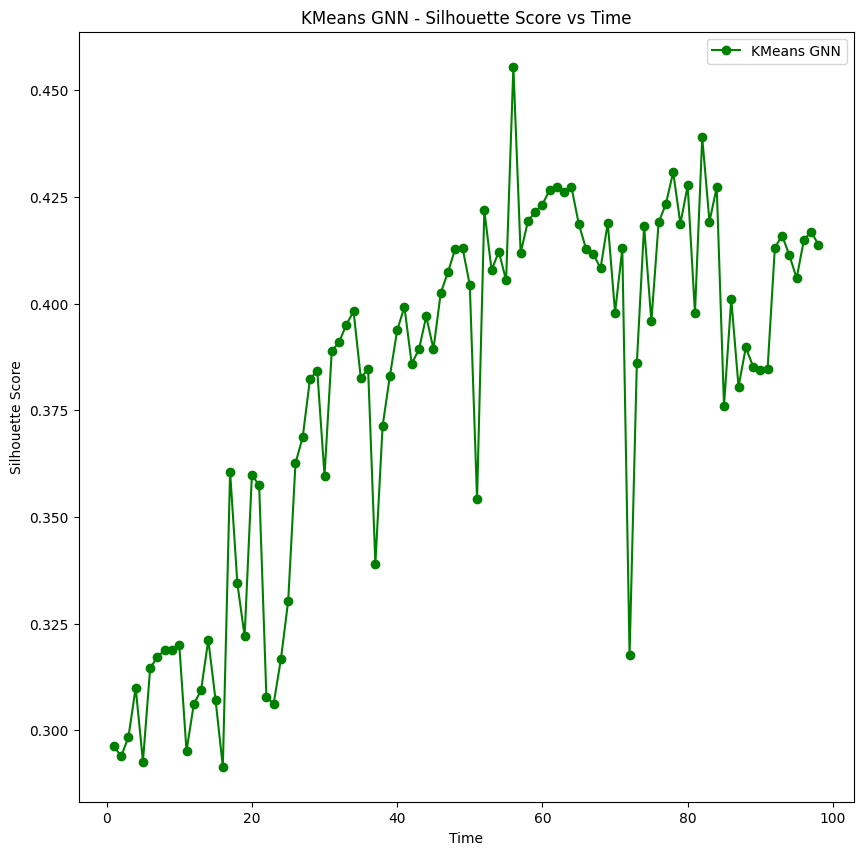

In [44]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS GNN----------------")
ax.plot(range(1, len(gnn_silhouette_score)), gnn_silhouette_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Silhouette Score')
ax.set_title('KMeans GNN - Silhouette Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-gnn.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-gnn.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS COMBINED----------------


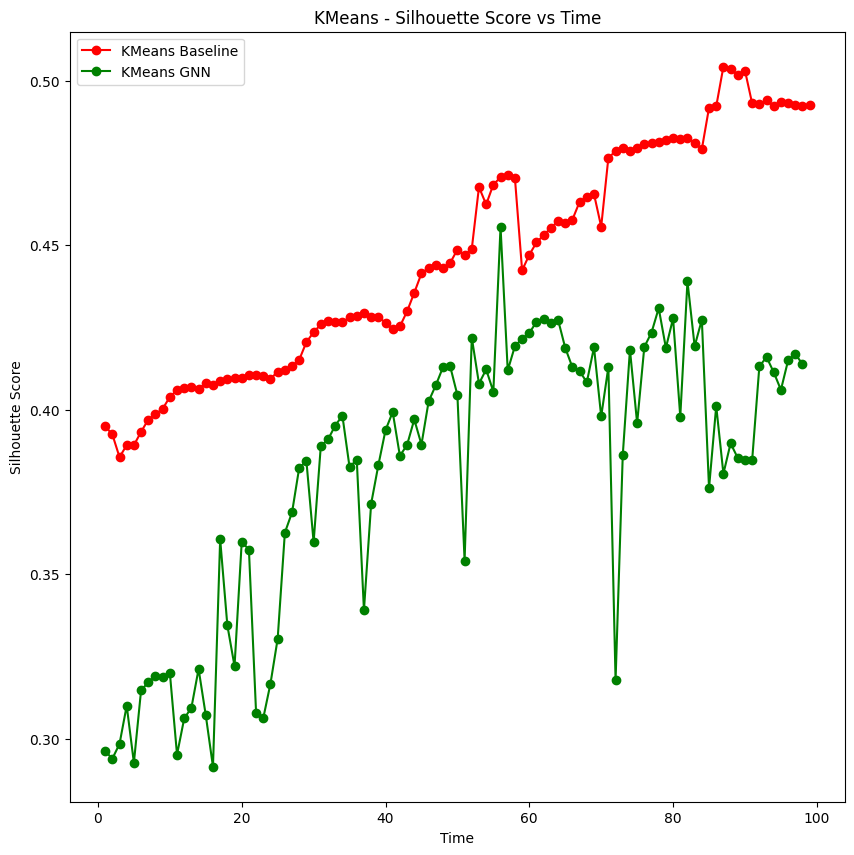

In [45]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS COMBINED----------------")
ax.plot(range(1, len(node_silhouette_score)), node_silhouette_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')
ax.plot(range(1, len(gnn_silhouette_score)), gnn_silhouette_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Silhouette Score')
ax.set_title('KMeans - Silhouette Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-combined.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-silhouette-combined.eps', format='eps', dpi=600)
plt.show()

### Davies-Bouldin Index

---------------KMEANS Baseline----------------


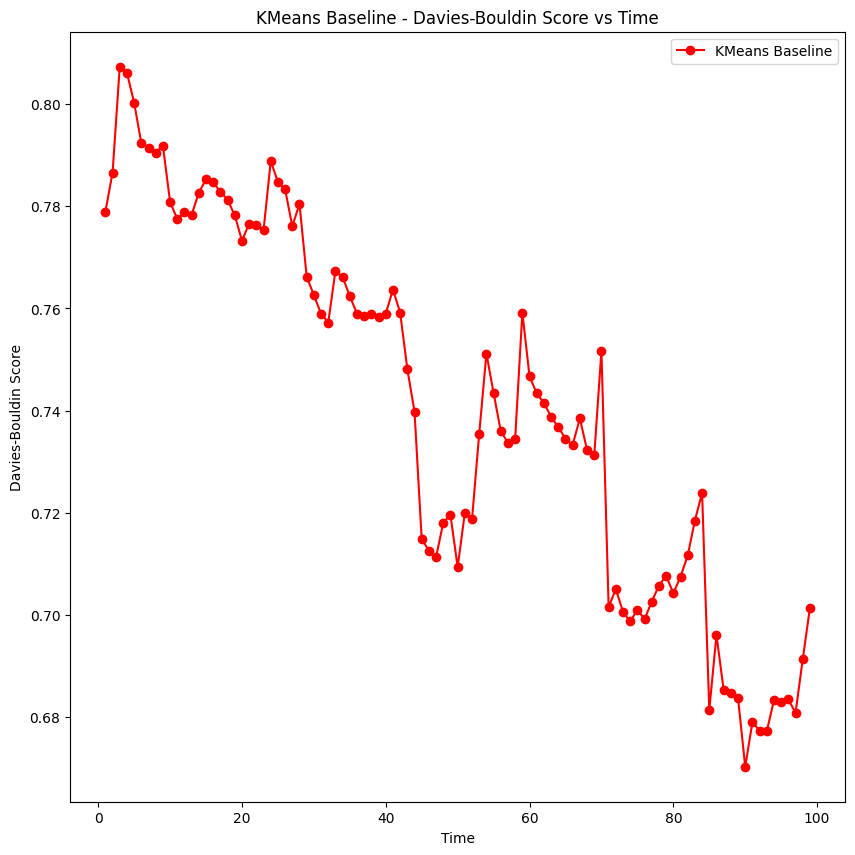

In [46]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Baseline----------------")
ax.plot(range(1, len(node_davies_bouldin_score)), node_davies_bouldin_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')

ax.set_xlabel('Time')
ax.set_ylabel('Davies-Bouldin Score')
ax.set_title('KMeans Baseline - Davies-Bouldin Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-baseline.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-baseline.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS GNN----------------


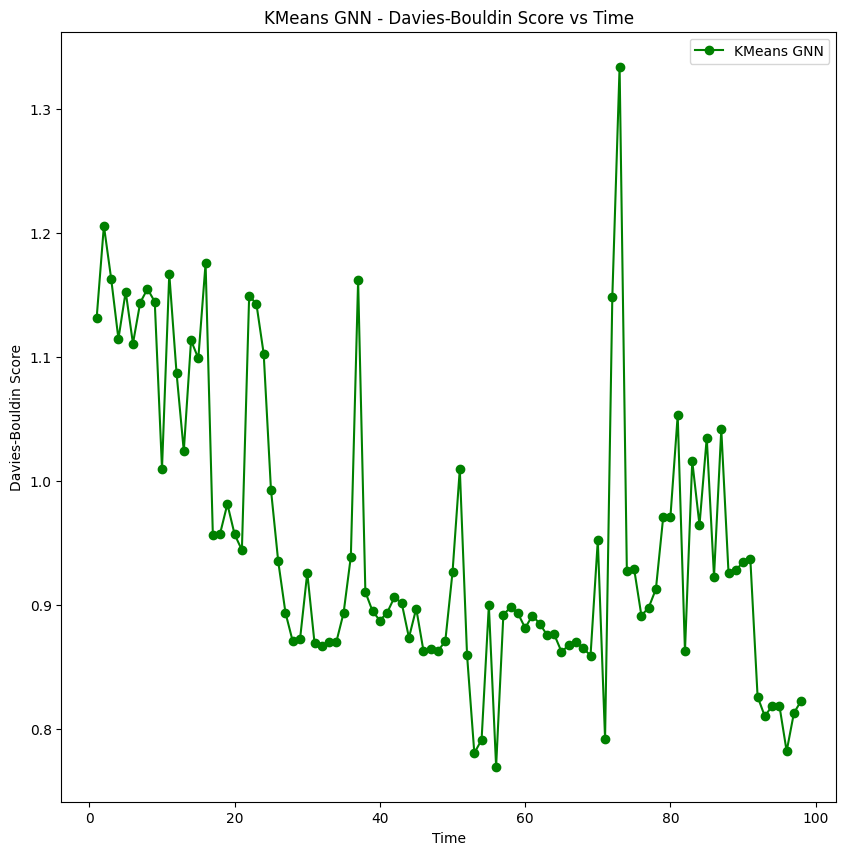

In [47]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS GNN----------------")
ax.plot(range(1, len(gnn_davies_bouldin_score)), gnn_davies_bouldin_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Davies-Bouldin Score')
ax.set_title('KMeans GNN - Davies-Bouldin Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-gnn.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-gnn.eps', format='eps', dpi=600)
plt.show()


---------------KMEANS Combined----------------


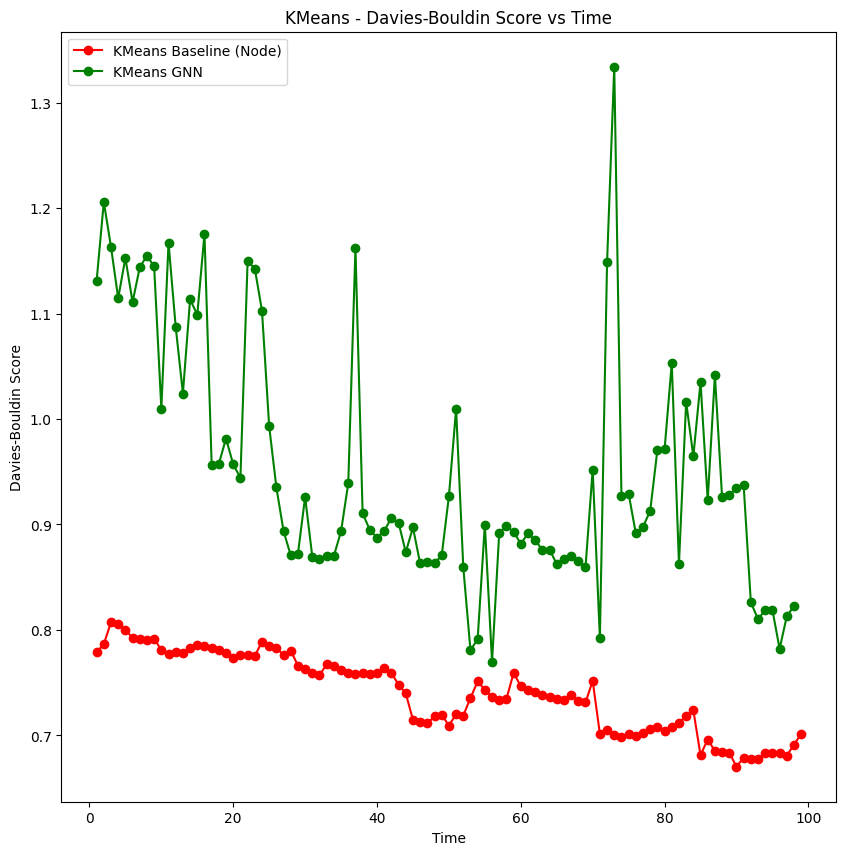

In [48]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Combined----------------")
ax.plot(range(1, len(node_davies_bouldin_score)), node_davies_bouldin_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline (Node)')
ax.plot(range(1, len(gnn_davies_bouldin_score)), gnn_davies_bouldin_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Davies-Bouldin Score')
ax.set_title('KMeans - Davies-Bouldin Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-combined.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-davies-bouldin-combined.eps', format='eps', dpi=600)
plt.show()

### Calinski-Harabasz Index

---------------KMEANS Baseline----------------


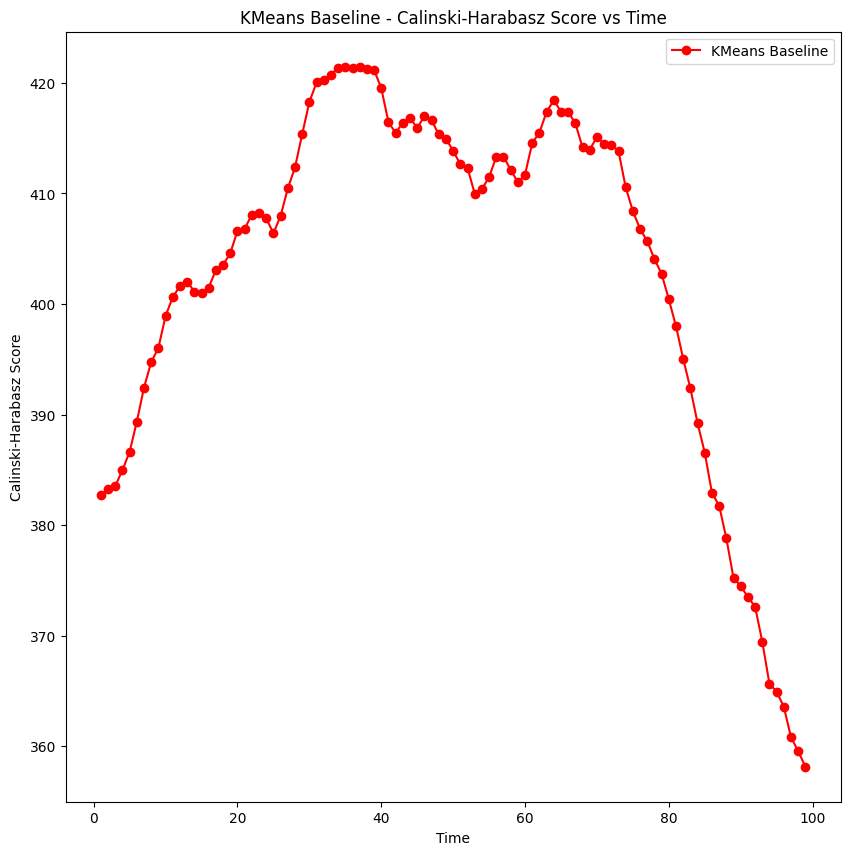

In [49]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Baseline----------------")
ax.plot(range(1, len(node_calinski_harabasz_score)), node_calinski_harabasz_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline')

ax.set_xlabel('Time')
ax.set_ylabel('Calinski-Harabasz Score')
ax.set_title('KMeans Baseline - Calinski-Harabasz Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-baseline.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-baseline.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS GNN----------------


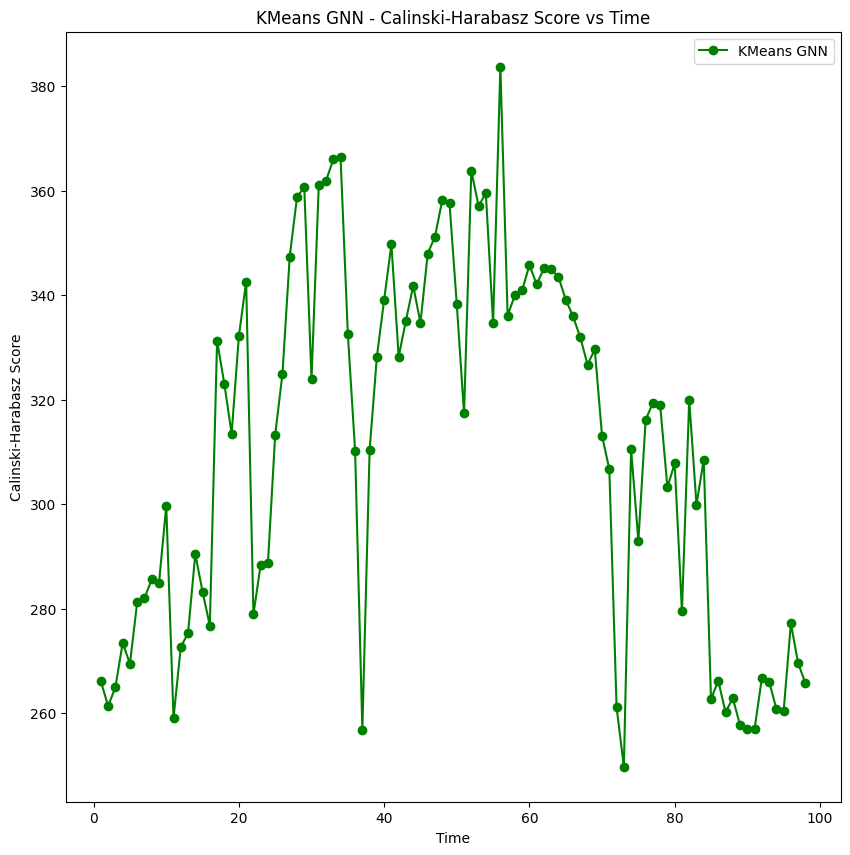

In [50]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS GNN----------------")
ax.plot(range(1, len(gnn_calinski_harabasz_score)), gnn_calinski_harabasz_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Calinski-Harabasz Score')
ax.set_title('KMeans GNN - Calinski-Harabasz Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-gnn.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-gnn.eps', format='eps', dpi=600)
plt.show()

---------------KMEANS Combined----------------


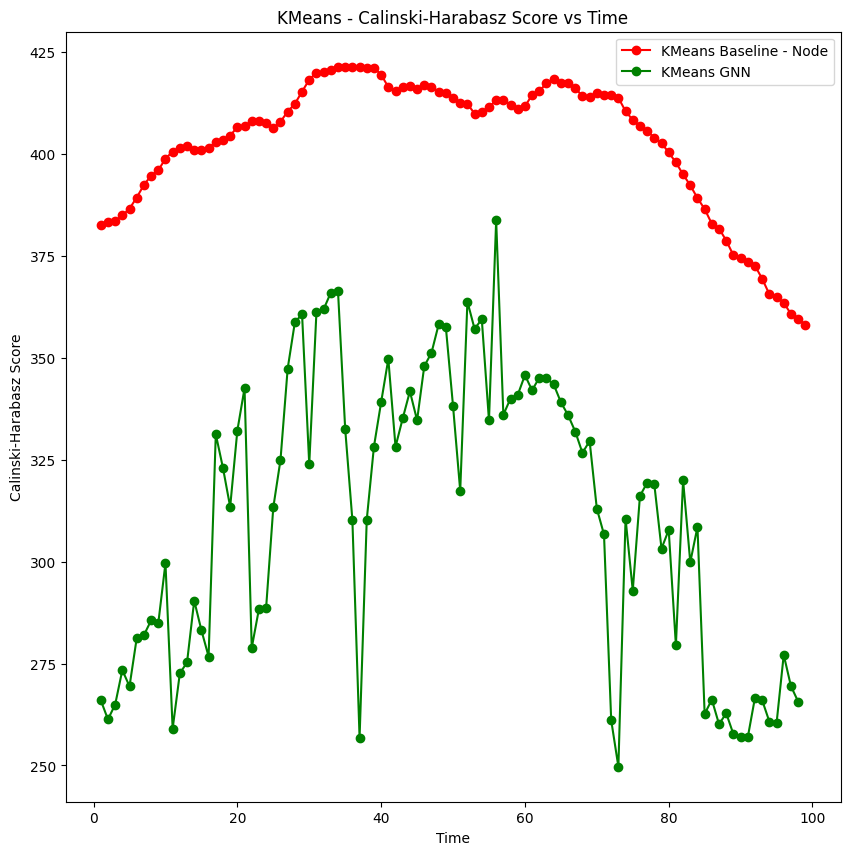

In [51]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Combined----------------")
ax.plot(range(1, len(node_calinski_harabasz_score)), node_calinski_harabasz_score[1:], marker='o', linestyle='-', color='red', label='KMeans Baseline - Node')
ax.plot(range(1, len(gnn_calinski_harabasz_score)), gnn_calinski_harabasz_score[1:], marker='o', linestyle='-', color='green', label='KMeans GNN')

ax.set_xlabel('Time')
ax.set_ylabel('Calinski-Harabasz Score')
ax.set_title('KMeans - Calinski-Harabasz Score vs Time')
ax.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-combined.png', format='png', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-calinski-harabasz-combined.eps', format='eps', dpi=600)
plt.show()

### Inter and Intra Cluster Distance

---------------KMEANS Combined----------------


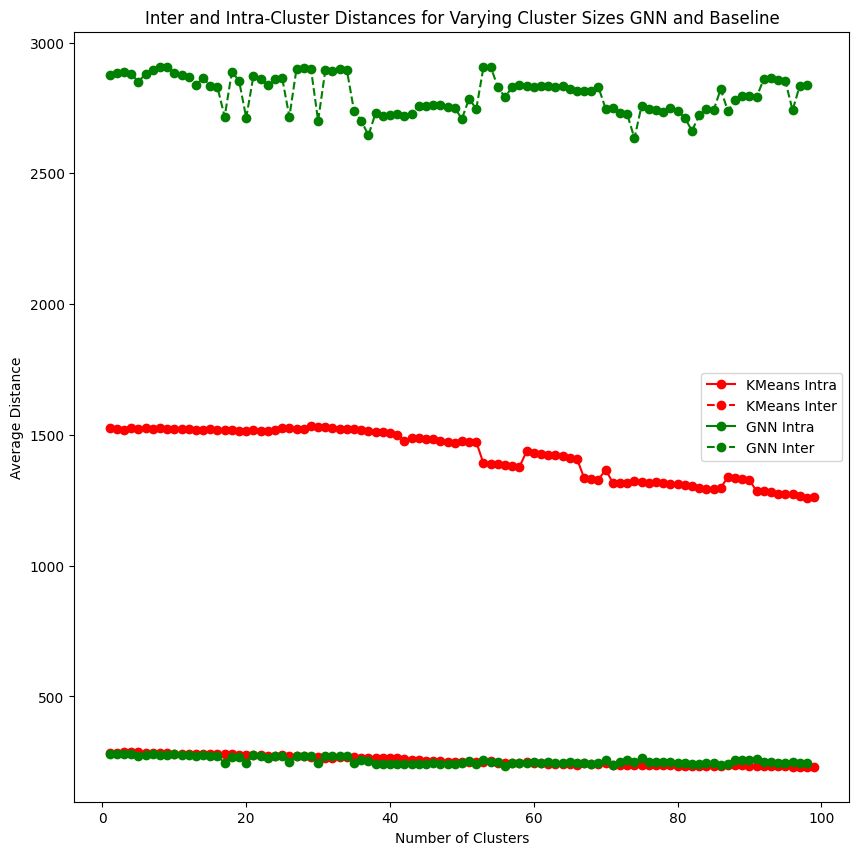

In [52]:
fig, ax = plt.subplots(figsize=(10, 10))

print("---------------KMEANS Combined----------------")
plt.plot(range(1, len(node_avg_inter_distance)), node_avg_inter_distance[1:], marker='o', linestyle='-', color='red', label='KMeans Intra')
plt.plot(range(1, len(node_avg_intra_distance)), node_avg_intra_distance[1:], marker='o', linestyle='--', color='red', label='KMeans Inter')  # Modified color to red
plt.plot(range(1, len(gnn_avg_inter_distance)), gnn_avg_inter_distance[1:], marker='o', linestyle='-', color='green', label='GNN Intra')
plt.plot(range(1, len(gnn_avg_intra_distance)), gnn_avg_intra_distance[1:], marker='o', linestyle='--', color='green', label='GNN Inter')  # Modified color to green

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance')
plt.title('Inter and Intra-Cluster Distances for Varying Cluster Sizes GNN and Baseline')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-combined-distance-analysis.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-combined-distance-analysis.png', format='png', dpi=600)
plt.show()

### Max, Min, Median Clusters (Elbow)

-------------KMEANS Baseline------------


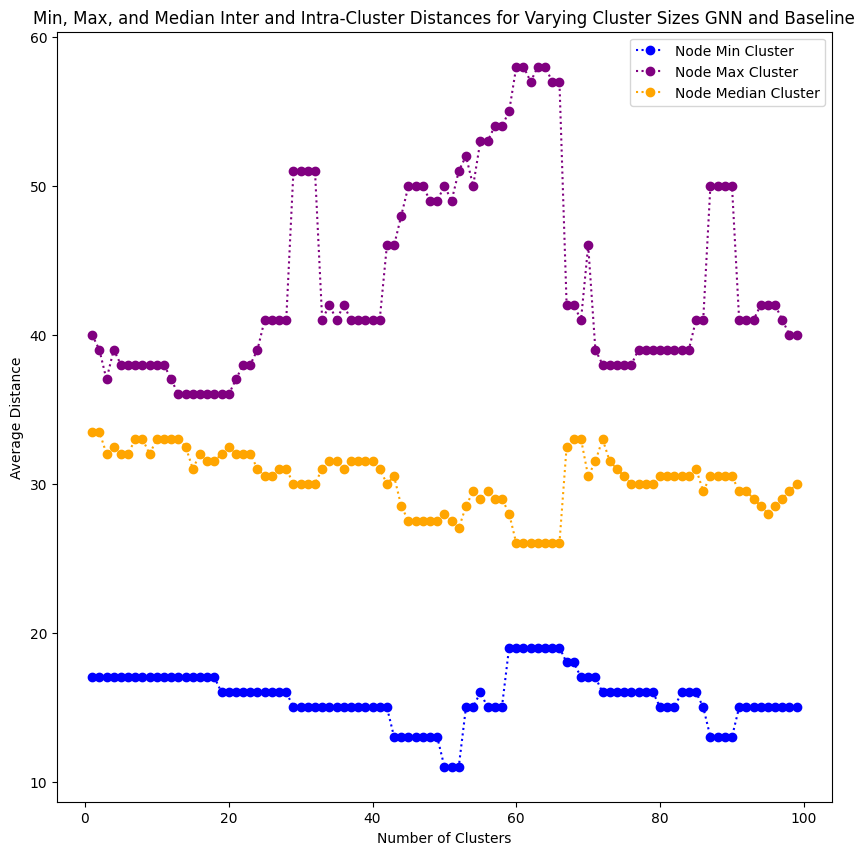

In [53]:
fig, ax = plt.subplots(figsize=(10, 10))

print("-------------KMEANS Baseline------------")
plt.plot(range(1, len(node_min_cluster)), node_min_cluster[1:], marker='o', linestyle=':', color='blue', label='Node Min Cluster')
plt.plot(range(1, len(node_max_cluster)), node_max_cluster[1:], marker='o', linestyle=':', color='purple', label='Node Max Cluster')
plt.plot(range(1, len(node_median_cluster)), node_median_cluster[1:], marker='o', linestyle=':', color='orange', label='Node Median Cluster')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance')
plt.title('Min, Max, and Median Inter and Intra-Cluster Distances for Varying Cluster Sizes GNN and Baseline')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-node-cluster-min-max-distance-analysis.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-node-cluster-min-max-distance-analysis.png', format='png', dpi=600)
plt.show()

-------------KMEANS GNN------------


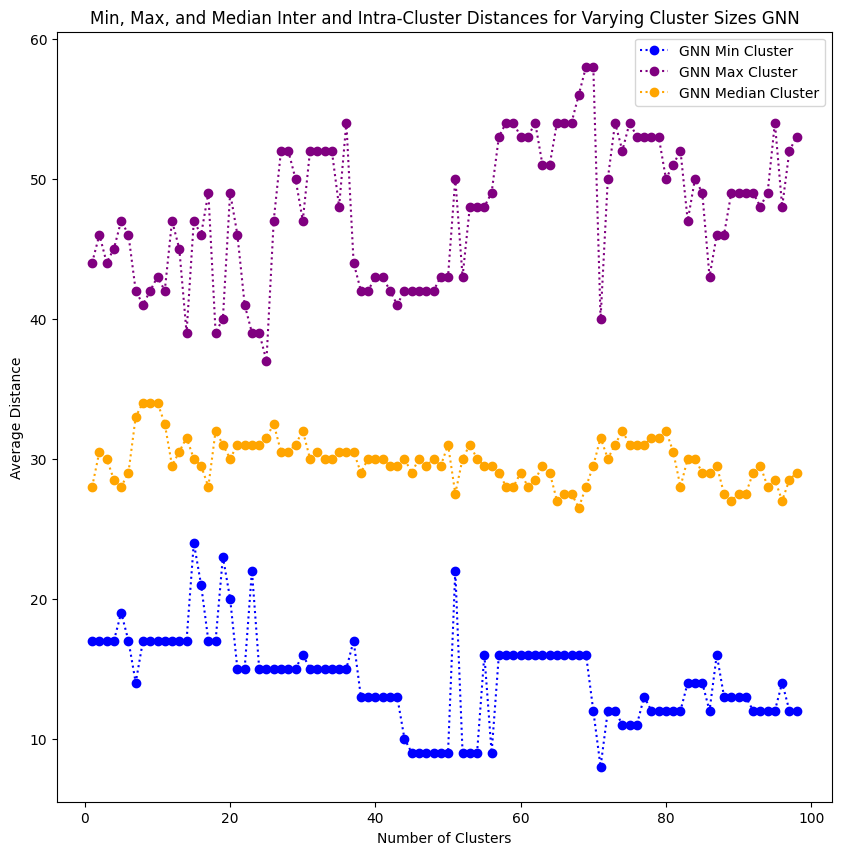

In [54]:
fig, ax = plt.subplots(figsize=(10, 10))

print("-------------KMEANS GNN------------")
plt.plot(range(1, len(gnn_min_cluster)), gnn_min_cluster[1:], marker='o', linestyle=':', color='blue', label='GNN Min Cluster')
plt.plot(range(1, len(gnn_max_cluster)), gnn_max_cluster[1:], marker='o', linestyle=':', color='purple', label='GNN Max Cluster')
plt.plot(range(1, len(gnn_median_cluster)), gnn_median_cluster[1:], marker='o', linestyle=':', color='orange', label='GNN Median Cluster')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance')
plt.title('Min, Max, and Median Inter and Intra-Cluster Distances for Varying Cluster Sizes GNN')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-cluster-min-max-ddistance-analysis.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-cluster-min-max-ddistance-analysis.png', format='png', dpi=600)
plt.show()

-------------KMEANS Combined------------


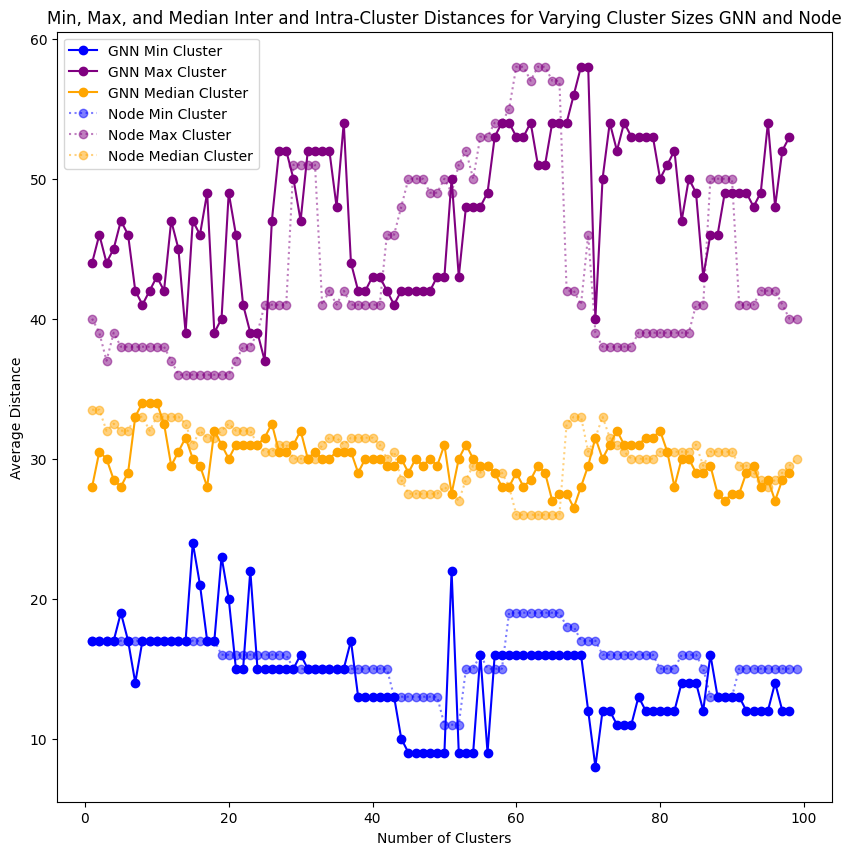

In [55]:
fig, ax = plt.subplots(figsize=(10, 10))

print("-------------KMEANS Combined------------")
ax.plot(range(1, len(gnn_min_cluster)), gnn_min_cluster[1:], marker='o', linestyle='-', color='blue', label='GNN Min Cluster')
ax.plot(range(1, len(gnn_max_cluster)), gnn_max_cluster[1:], marker='o', linestyle='-', color='purple', label='GNN Max Cluster')
ax.plot(range(1, len(gnn_median_cluster)), gnn_median_cluster[1:], marker='o', linestyle='-', color='orange', label='GNN Median Cluster')

ax.plot(range(1, len(node_min_cluster)), node_min_cluster[1:], marker='o', linestyle=':', color='blue', label='Node Min Cluster', alpha=0.5)  # Use alpha to distinguish lines
ax.plot(range(1, len(node_max_cluster)), node_max_cluster[1:], marker='o', linestyle=':', color='purple', label='Node Max Cluster', alpha=0.5)
ax.plot(range(1, len(node_median_cluster)), node_median_cluster[1:], marker='o', linestyle=':', color='orange', label='Node Median Cluster', alpha=0.5)

ax.set_xlabel('Number of Clusters')
ax.set_ylabel('Average Distance')
ax.set_title('Min, Max, and Median Inter and Intra-Cluster Distances for Varying Cluster Sizes GNN and Node')
ax.legend()

plt.savefig(f'{folder_path}{run_id}_{version}-combined-cluster-min-max-ddistance-analysis.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-combined-cluster-min-max-ddistance-analysis.png', format='png', dpi=600)
plt.show()

### Avg Distance per Cluster to Centroid (Elbow)

------------------------KMeans Baseline---------------


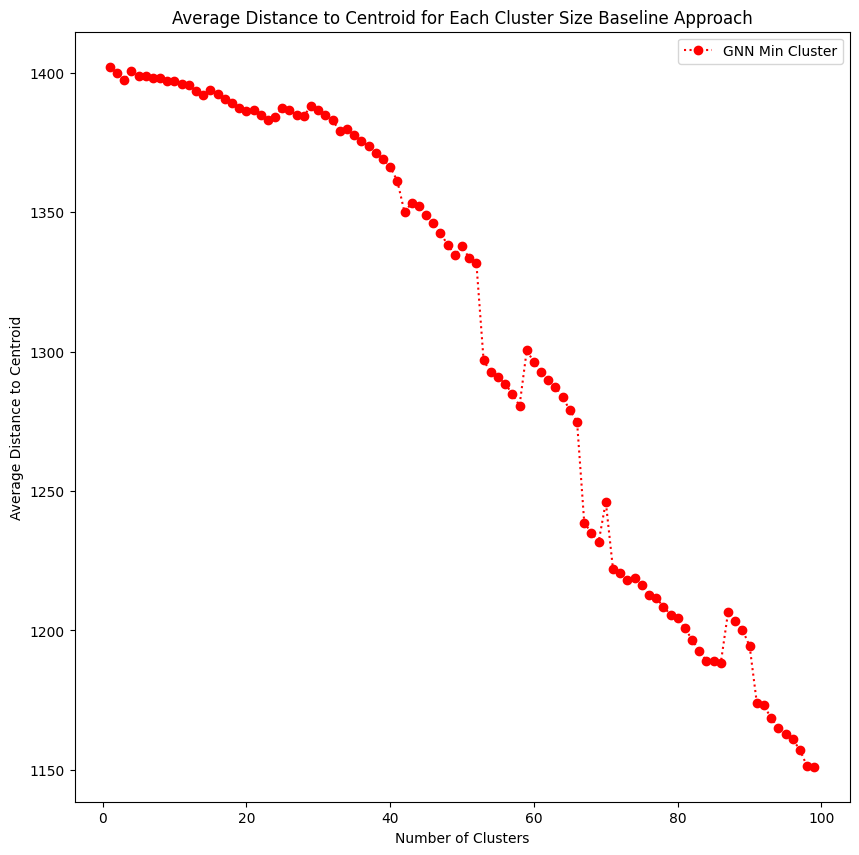

In [56]:
print("------------------------KMeans Baseline---------------")
plt.figure(figsize=(10, 10))

plt.plot(range(1, len(node_avg_centroid_distance)), node_avg_centroid_distance[1:], marker='o', linestyle=':', color='red', label='GNN Min Cluster')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance to Centroid')
plt.title('Average Distance to Centroid for Each Cluster Size Baseline Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-node-avg_dist_to_centroid{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-node-avg_dist_to_centroid{t}.png', format='png', dpi=600)
plt.show()

------------------------KMeans GNN---------------


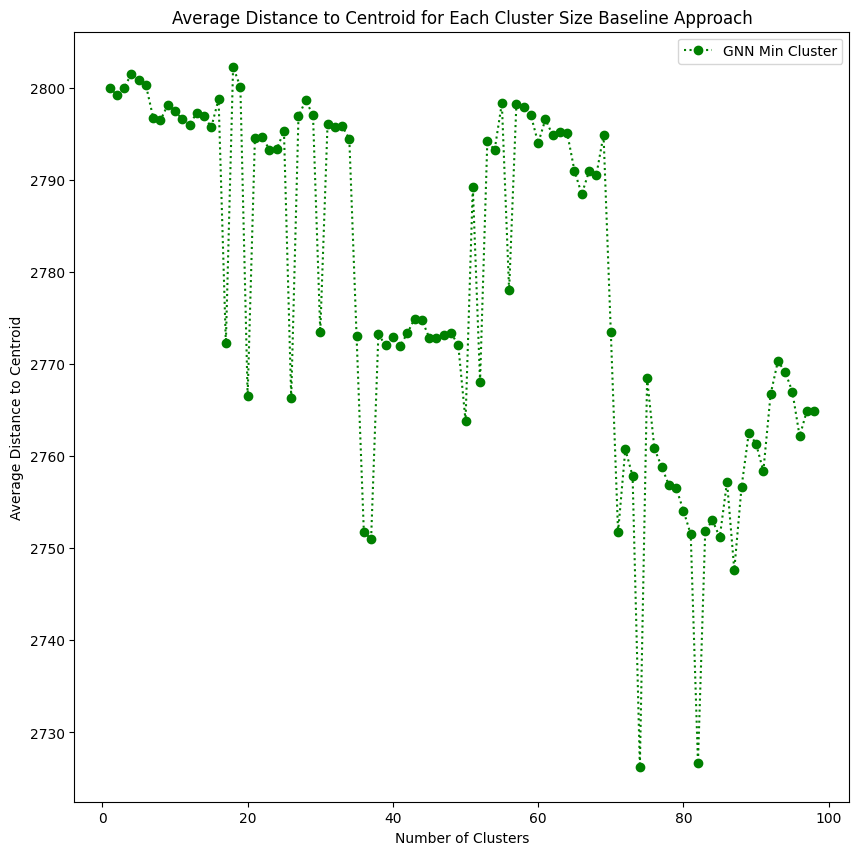

In [57]:
print("------------------------KMeans GNN---------------")
plt.figure(figsize=(10, 10))

plt.plot(range(1, len(gnn_avg_centroid_distance)), gnn_avg_centroid_distance[1:], marker='o', linestyle=':', color='green', label='GNN Min Cluster')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance to Centroid')
plt.title('Average Distance to Centroid for Each Cluster Size Baseline Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-avg_dist_to_centroid{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-avg_dist_to_centroid{t}.png', format='png', dpi=600)
plt.show()

------------------------KMeans Combined---------------


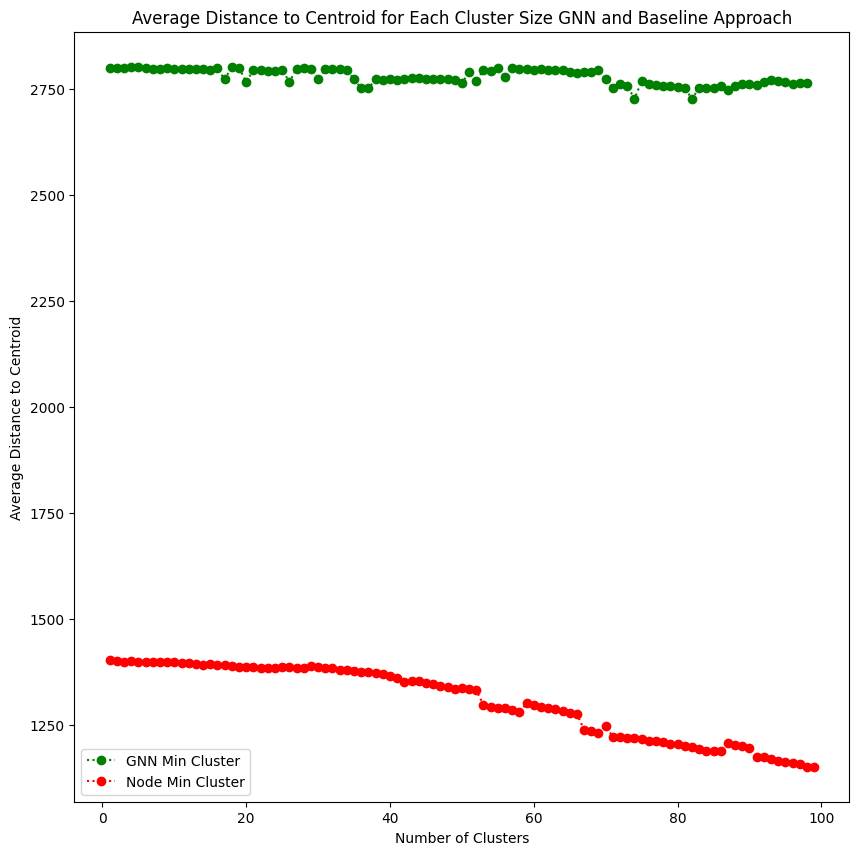

In [58]:
print("------------------------KMeans Combined---------------")
plt.figure(figsize=(10, 10))

plt.plot(range(1, len(gnn_avg_centroid_distance)), gnn_avg_centroid_distance[1:], marker='o', linestyle=':', color='green', label='GNN Min Cluster')
plt.plot(range(1, len(node_avg_centroid_distance)), node_avg_centroid_distance[1:], marker='o', linestyle=':', color='red', label='Node Min Cluster')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Distance to Centroid')
plt.title('Average Distance to Centroid for Each Cluster Size GNN and Baseline Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-combined-avg_dist_to_centroid{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-combined-avg_dist_to_centroid{t}.png', format='png', dpi=600)
plt.show()

### Cluster Densities (Elbow)

------------------------KMeans Baseline---------------


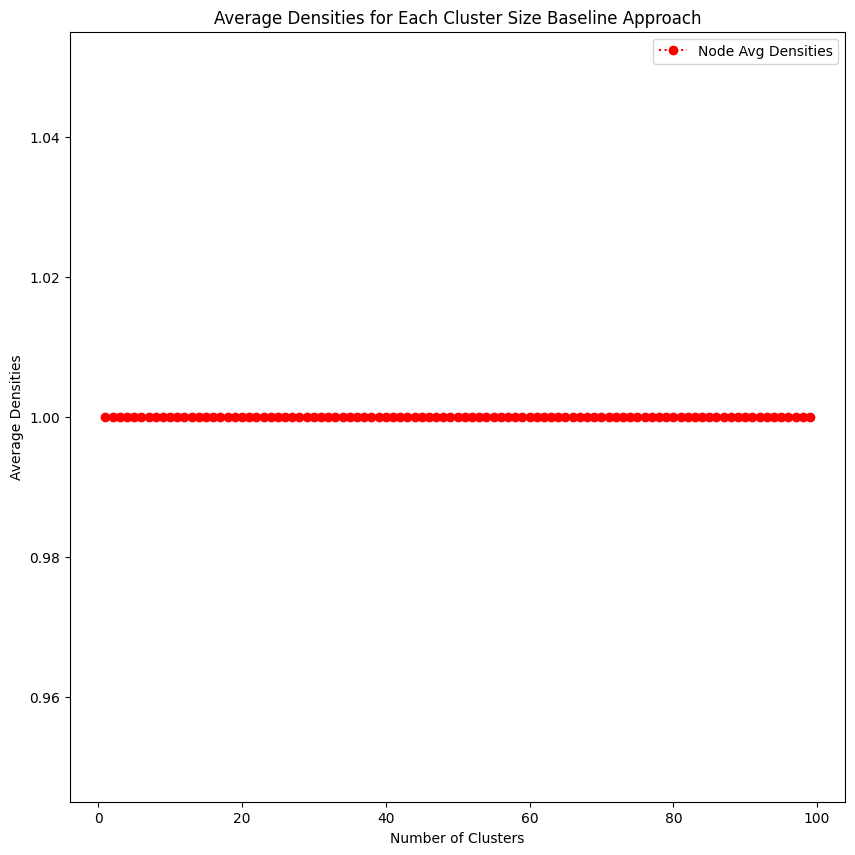

In [59]:
plt.figure(figsize=(10, 10))

print("------------------------KMeans Baseline---------------")
plt.plot(range(1, len(node_avg_density)), node_avg_density[1:], marker='o', linestyle=':', color='red', label='Node Avg Densities')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Densities')
plt.title('Average Densities for Each Cluster Size Baseline Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-node-avg_densities{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-node-avg_densities{t}.png', format='png', dpi=600)
plt.show()


------------------------KMeans GNN---------------


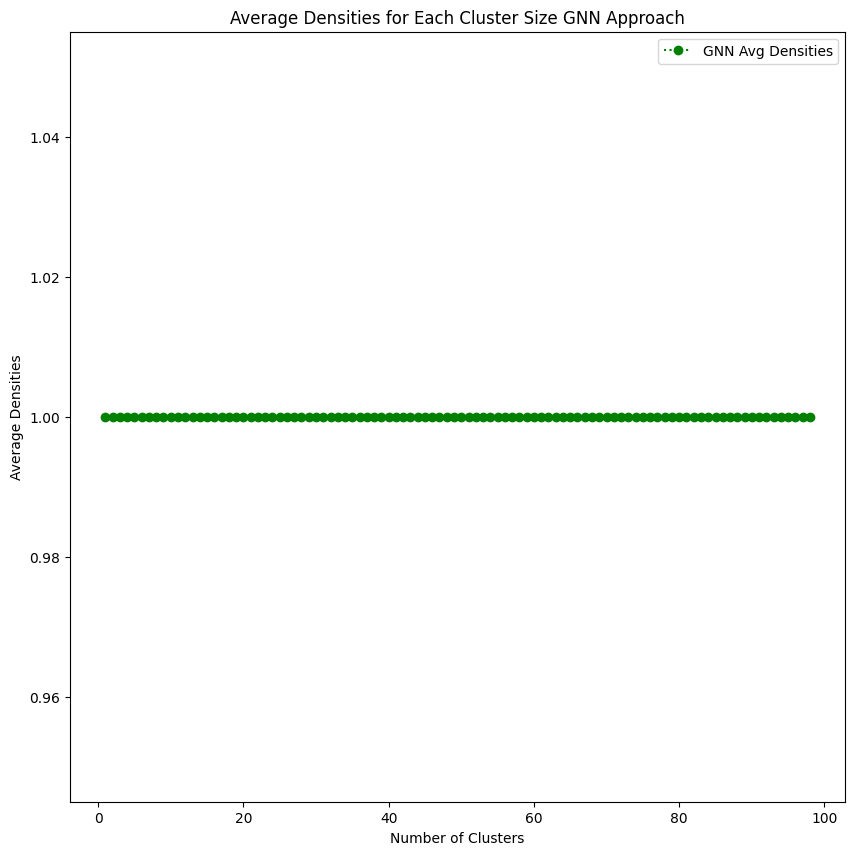

In [60]:
plt.figure(figsize=(10, 10))

print("------------------------KMeans GNN---------------")
plt.plot(range(1, len(gnn_avg_density)), gnn_avg_density[1:], marker='o', linestyle=':', color='green', label='GNN Avg Densities')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Densities')
plt.title('Average Densities for Each Cluster Size GNN Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-avg_densities{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-gnn-avg_densities{t}.png', format='png', dpi=600)
plt.show()

------------------------KMeans Combined---------------


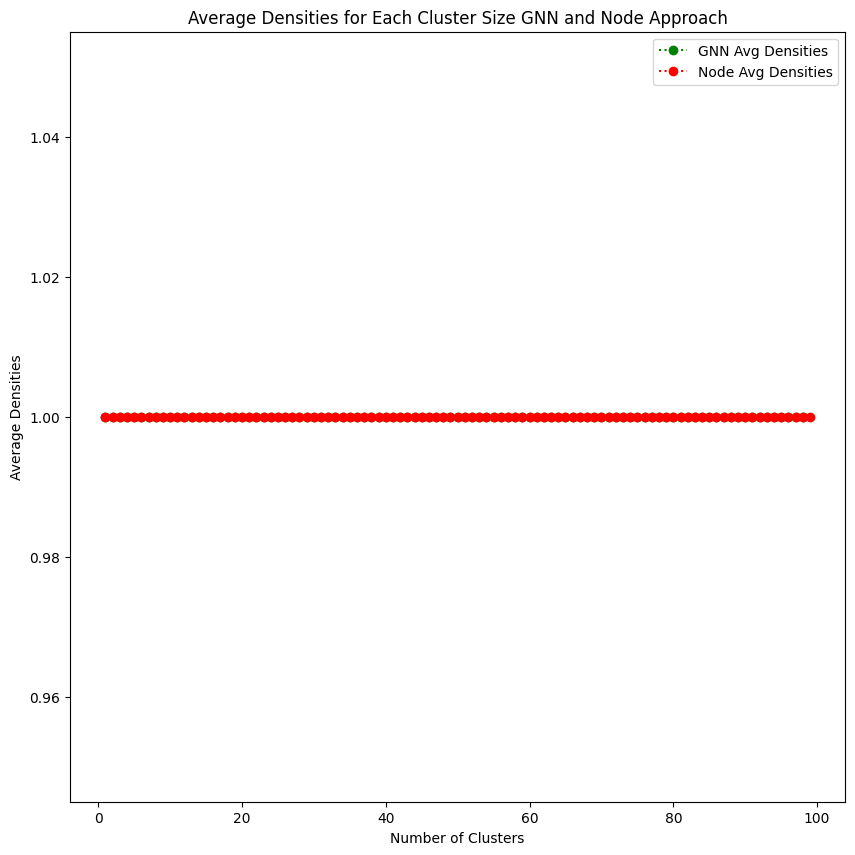

In [61]:
plt.figure(figsize=(10, 10))

print("------------------------KMeans Combined---------------")
plt.plot(range(1, len(gnn_avg_density)), gnn_avg_density[1:], marker='o', linestyle=':', color='green', label='GNN Avg Densities')
plt.plot(range(1, len(node_avg_density)), node_avg_density[1:], marker='o', linestyle=':', color='red', label='Node Avg Densities')

plt.xlabel('Number of Clusters')
plt.ylabel('Average Densities')
plt.title('Average Densities for Each Cluster Size GNN and Node Approach')
plt.legend()
plt.savefig(f'{folder_path}{run_id}_{version}-combined-avg_densities{t}.eps', format='eps', dpi=600)
plt.savefig(f'{folder_path}{run_id}_{version}-combined-avg_densities{t}.png', format='png', dpi=600)
plt.show()

## Testing Analysis

In [62]:
def save_parameter_to_txt(param_name, parameter, file_path):
    try:
        with open(file_path, mode='a') as params_file:
            params_file.write(param_name + ':' + str(parameter) + "\n")
    except Exception as e:
        print(f"Error occurred while saving {param_name} parameter to {file_path}: {e}")


In [63]:
# Print information
print('Test Parameters')
save_parameter_to_txt('Originating Filename',file_name, f"{run_id}_{version}")

print('------------')
save_parameter_to_txt('-----------------', '--------------------', f"{run_id}_{version}")
print('Number of Clusters ', num_clusters)
save_parameter_to_txt('Number of Clusters ',num_clusters, f"{run_id}_{version}")
print('Number of Initializations of Cluster',n)
save_parameter_to_txt('Number of Initializations of Cluster', n, f"{run_id}_{version}")
print('Max Distance',  max_dist)
save_parameter_to_txt('Max Distance ',max_dist, f"{run_id}_{version}")
print('Transform Set',transform_set)
save_parameter_to_txt('Transform Set', transform_set, f"{run_id}_{version}")
print('Learning Rate',learn_rate)
save_parameter_to_txt('Learning Rate', learn_rate, f"{run_id}_{version}")
print('Epochs/Generations of Training',epochs)
save_parameter_to_txt('Epochs/Generations of Training', epochs, f"{run_id}_{version}")
print('\n')

print('------------')
save_parameter_to_txt('-----------------', '--------------------', f"{run_id}_{version}")
# GPU Details
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
  save_parameter_to_txt('GPU', 'no', f"{run_id}_{version}")
else:
  print(gpu_info)
  save_parameter_to_txt('GPU', 'yes', f"{run_id}_{version}")
print('\n')

Test Parameters
------------
Number of Clusters  10
Number of Initializations of Cluster 1000
Max Distance 150
Transform Set True
Learning Rate 0.0001
Epochs/Generations of Training range(1, 101)


------------
Mon Mar  4 01:45:31 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   74C    P0              33W / 

# Download

folder_path = f'./results/{run_id}_{version}/'

In [64]:
shutil.make_archive(f"./downloads/{run_id}", 'zip', folder_path)

files.download(f"./downloads/{run_id}.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [65]:
send_text_notification(f"Your Phase 1 - Iterative Pre-Trained GNN has finished running! {run_id}")

Notification sent successfully! SID: SM3f3ee87da7078c0fb7885b90d656030f
